In [1]:
import os

import numpy as np
import pandas as pd
import seaborn as sns
import pymc3 as pm

from sklearn.metrics import confusion_matrix as conf_mat

%pylab inline
%config InlineBackend.figure_format = 'retina'
%qtconsole --colors=linux
%load_ext watermark

Populating the interactive namespace from numpy and matplotlib


In [2]:
%watermark -v -m -p numpy,pandas,seaborn,pymc3,matplotlib

CPython 3.5.1
IPython 6.1.0

numpy 1.12.0
pandas 0.20.2
seaborn 0.7.0
pymc3 3.1
matplotlib 2.0.2

compiler   : GCC 4.2.1 (Apple Inc. build 5666) (dot 3)
system     : Darwin
release    : 16.7.0
machine    : x86_64
processor  : i386
CPU cores  : 4
interpreter: 64bit


# Table of Content
[Abstract](#Abstract)  
[Experiment info](#Experiment-information-snippet)  

Load data
- [Display one subject](#Display-one-subject)  
- [Load all data](#Load-all-subject)  
- [Data filtering](#Data-Filtering)  

[Descriptive result](#Display-descriptive-result-by-age-group)  
- [Confusion Matrix](#mean-confusion-matrix)  
- [Expression recognition as the function of age](#Lineplot-of-accurate-recognition-as-a-function-of-age)  
- [Dynamic advantage](#Dynamic-advantage-as-a-function-of-age)  

[Display Raw](#Display-Raw)  

[Piece-wise regression model](#Facial-expression-recognition-as-a-function-of-age)  
- [Setup helper function for PyMC3](#Setup-helper-function-for-PyMC3)   
- [Bayesian model 3 - pair comparison](#Model-3-for-pair-comparison)

[Dynamic - Static](#Dynamic-vs-Static)   
- [Anger](#Anger-1)  
- [Disgust](#Disgust-1)  
- [Fear](#Fear-1)  
- [Happy](#Happy-1)  
- [Sad](#Sad-1)    
- [Surprise](#Surprise-1)  

[Dynamic - Shuffled](#Dynamic-vs-Shuffled)   
- [Anger](#Anger-2)  
- [Disgust](#Disgust-2)  
- [Fear](#Fear-2)  
- [Happy](#Happy-2)  
- [Sad](#Sad-2)    
- [Surprise](#Surprise-2)  

[Shuffled - Static](#Shuffled-vs-Static)   
- [Anger](#Anger-3)  
- [Disgust](#Disgust-3)  
- [Fear](#Fear-3)  
- [Happy](#Happy-3)  
- [Sad](#Sad-3)    
- [Surprise](#Surprise-3)  

# Tracking the recognition of static and dynamic facial expressions of emotion across life span

Anne-Raphaëlle Richoz<sup>1</sup>, Junpeng Lao<sup>1</sup>, Olivier Pascalis<sup>2</sup>, and Roberto Caldara<sup>1</sup>  
*<sup>1</sup>Eye and Brain Mapping Laboratory (iBMLab), Department of Psychology, University of Fribourg, Fribourg, Switzerland*  
*<sup>2</sup>Laboratoire de Psychologie et Neurocognition (CNRS), Université Grenoble-Alpes, Grenoble, France*


## Abstract  
Dynamic social signals are steadily stimulating the visual system during human interactions. A wealth of such signals are transmitted as facial expressions for communicating internal emotional states. Unlike static snapshots, routinely used in most of the experiments, dynamic facial expressions provide observers with richer and ecologically-valid signals. Common intuition would thus suggest an advantage for the recognition of dynamic over static inputs. However, while many studies reported an advantage in the recognition of dynamic over static expressions in clinical populations ([Richoz et al., 2015](http://perso.unifr.ch/roberto.caldara/pdfs/richoz_15.pdf)), results obtained with healthy young adults are by far more contrasted. To clarify this issue, we conducted a large sample cross-sectional study to investigate facial expression recognition from early to elderly age. Over 400 observers (age range 5-100) performed recognition tasks of the six basic expressions in three conditions: static, shuffled (temporally randomized frames) and dynamic ([Gold et al., 2013](https://dx.doi.org/10.1167%2F13.5.23)). We normalized the stimuli for their low-level properties and the amount of energy sampled over time, even for the static condition. Facial expression recognition profiles revealed a better performance for “happy” and typical confusions among expressions with similar morphology (fear-surprise), regardless of condition and age. We then applied a Generalized Additive Model with smoothing spline on an efficiency index to capture the nonlinear relationship between age and the experimental conditions. Overall, we observed strong efficiency in the recognition of dynamic facial expressions in the elderly population. This observation was driven by a suboptimal performance for static and shuffled expressions, a potential marker for impaired face processing that might be linked to other facets of general cognitive decline. Our findings also posit the use of dynamic stimuli as being critical in the assessment of facial expression recognition in elderly populations, inviting to caution when drawing conclusions from the sole use of static face images to this aim.

## Experiment information snippet

### Experiment setup
Participant perform 3 different task [Dynamic,Shuffl,Static], each with 96 trials (2 sex x 6 expression x 4 identities x 2 repetition)

### Stimuli (static)

![fig1](figs/img1.jpg)

## Display one subject

In [3]:
# import os
proj_path = '/Users/jlao/Documents/Github/Static_dynamic'
datatmp = pd.read_csv(proj_path + '/data/CHuguet_g1_a9_DyExp_beh.txt','\t',
                      header=None)
# change column name
column_name = ['Trial','Resp','ACC','RT','cRect1','cRect2','cRect3','cRect4',
               'Randseq','Task']
datatmp.columns=column_name
# change stimuli name
stim_list = pd.read_csv(proj_path + '/experiment_code/stimuli_list.csv',',')
datatmp['Expression'] = np.asarray(stim_list['Expression'].loc[datatmp['Randseq']-1])
# change response name
resp_list = np.asarray(['Fear','Anger','Disgust','Happiness','Sadness','Surprise'])
Resp = []
for iresp in datatmp['Resp']:
    if np.isfinite(iresp):
        Resp.append(resp_list[int(iresp-1)])
    else:
        Resp.append(np.nan)
datatmp['Resp_Exp'] = np.asarray(Resp)
# change task name
Taskname = np.asarray(['Dynamic','Shuffled','Static'])
datatmp['Task_nam'] = Taskname[datatmp['Task']-1]
# show dataframe (first 5 lines)
datatmp.head(5)

,Trial,Resp,ACC,RT,cRect1,cRect2,cRect3,cRect4,Randseq,Task,Expression,Resp_Exp,Task_nam
0,1,3.0,1.0,3.469837,340.5176,70.51765,1099.482,829.4824,64,1,Disgust,Disgust,Dynamic
1,2,5.0,0.0,1.791639,340.5176,70.51765,1099.482,829.4824,12,1,Disgust,Sadness,Dynamic
2,3,2.0,0.0,4.039435,340.5176,70.51765,1099.482,829.4824,13,1,Disgust,Anger,Dynamic
3,4,5.0,1.0,4.190567,340.5176,70.51765,1099.482,829.4824,87,1,Sadness,Sadness,Dynamic
4,5,2.0,1.0,1.299397,340.5176,70.51765,1099.482,829.4824,54,1,Anger,Anger,Dynamic


In [4]:
taskorder = datatmp.Task.unique() - 1
print('The task order is:' + str(taskorder))

from sklearn.metrics import confusion_matrix as conf_mat
labellist = np.asarray(['Anger','Disgust','Fear','Happiness','Sadness','Surprise'])
for ij,itask in enumerate(Taskname):
    datatask  = datatmp[datatmp['Task_nam']==itask]
    conf_subj = conf_mat(datatask['Expression'],datatask['Resp_Exp'],labels=labellist)
    conf_df = pd.DataFrame(conf_subj,columns=labellist,index=labellist)
    conf_df['trials']=datatask['Expression'].value_counts()
    print('\n'+itask)
    print(conf_df)

The task order is:[0 2 1]

Dynamic
           Anger  Disgust  Fear  Happiness  Sadness  Surprise  trials
Anger          9        3     2          0        2         0      16
Disgust        6        5     2          0        3         0      16
Fear           0        1     3          0        3         8      16
Happiness      0        0     0         16        0         0      16
Sadness        2        2     0          0       11         1      16
Surprise       0        0     0          2        0        14      16

Shuffled
           Anger  Disgust  Fear  Happiness  Sadness  Surprise  trials
Anger         12        3     0          0        1         0      16
Disgust        9        4     2          0        0         0      16
Fear           1        3     5          0        1         6      16
Happiness      0        0     0         14        0         0      16
Sadness        3        1     2          0        7         1      16
Surprise       0        1     2          4   

Define a function for loading each subject.

In [5]:
from sklearn.metrics import confusion_matrix as conf_mat

def loadsbj(filepath,labellist,column_name,stim_list,Taskname):
    datatmp = pd.read_csv(filepath,'\t',
                          header=None)
    # change column name
    datatmp.columns=column_name
    # change stimuli name
    datatmp['Expression'] = np.asarray(stim_list['Expression'].loc[datatmp['Randseq']-1])
    # change response name
    Resp = []
    for iresp in datatmp['Resp']:
        if np.isfinite(iresp):
            Resp.append(resp_list[int(iresp-1)])
        else:
            Resp.append(np.nan)
    datatmp['Resp_Exp'] = np.asarray(Resp)
    # change task name
    datatmp['Task_nam'] = Taskname[datatmp['Task']-1]
    taskorder = datatmp.Task.unique() - 1
    conf_all = np.zeros((3,len(labellist),len(labellist)+1))
    for ij,itask in enumerate(Taskname):
        datatask  = datatmp[datatmp['Task_nam']==itask]
        if datatask.shape[0]>0:
            conf_subj = conf_mat(datatask['Expression'],datatask['Resp_Exp'],labels=labellist)
            conf_df = pd.DataFrame(conf_subj,columns=labellist,index=labellist)
            conf_df['trials']=datatask['Expression'].value_counts()
            conf_all[ij]=np.asarray(conf_df)
        
    return taskorder,np.asarray(conf_all)

Taskname = np.asarray(['Dynamic','Shuffled','Static'])
resp_list = np.asarray(['Fear','Anger','Disgust','Happiness','Sadness','Surprise'])
column_name = ['Trial','Resp','ACC','RT','cRect1','cRect2','cRect3','cRect4',
                   'Randseq','Task']
stim_list = pd.read_csv(proj_path + '/experiment_code/stimuli_list.csv',',')
labellist = np.asarray(['Anger','Disgust','Fear','Happiness','Sadness','Surprise'])

filepath = proj_path + '/data/CHuguet_g1_a9_DyExp_beh.txt'
taskorder,conf_all = loadsbj(filepath,labellist,column_name,stim_list,Taskname)
print(taskorder)
print(conf_all)

[0 2 1]
[[[  9.   3.   2.   0.   2.   0.  16.]
  [  6.   5.   2.   0.   3.   0.  16.]
  [  0.   1.   3.   0.   3.   8.  16.]
  [  0.   0.   0.  16.   0.   0.  16.]
  [  2.   2.   0.   0.  11.   1.  16.]
  [  0.   0.   0.   2.   0.  14.  16.]]

 [[ 12.   3.   0.   0.   1.   0.  16.]
  [  9.   4.   2.   0.   0.   0.  16.]
  [  1.   3.   5.   0.   1.   6.  16.]
  [  0.   0.   0.  14.   0.   0.  16.]
  [  3.   1.   2.   0.   7.   1.  16.]
  [  0.   1.   2.   4.   0.   8.  16.]]

 [[ 11.   3.   0.   0.   2.   0.  16.]
  [  5.   8.   2.   0.   1.   0.  16.]
  [  4.   2.   3.   0.   1.   6.  16.]
  [  0.   0.   0.  15.   0.   0.  16.]
  [  3.   1.   1.   0.   8.   2.  16.]
  [  0.   0.   0.   4.   0.  12.  16.]]]


# Load all subject

In [6]:
import os
Sbjall_txt = os.listdir(proj_path+'/data/')
gender = []
age = []
sbjname = []
confusionall = []
taskorderall = []
for string in Sbjall_txt:
    info = string.split(sep='_')
    gender.append(int(info[1][1:]))
    age.append(int(info[2][1:]))
    sbjname.append(info[0])
    filepath = proj_path + '/data/' + string
    taskorder,conf_all = loadsbj(filepath,labellist,column_name,stim_list,Taskname)
    confusionall.append(conf_all)
    taskorderall.append(taskorder)

In [7]:
subject_info = pd.DataFrame({'name': sbjname, 'gender': gender, 'age': age, 'taskorder':taskorderall})
confusionall = np.asarray(confusionall)
print(subject_info.head(5))
print(confusionall.shape)
print(subject_info.shape)

   age  gender        name  taskorder
0   61       2  AAltobelli  [2, 0, 1]
1   19       1    AAndrade  [0, 2, 1]
2    5       1    ABanchet  [2, 0, 1]
3   90       1     ABerger  [0, 2, 1]
4   57       1     ABiston  [0, 2, 1]
(444, 3, 6, 7)
(444, 4)


# Data Filtering
There are some subject that did not answer one expression on the first task. Because we do not know whether they actually did not perceive that expression or did not understand the task, we excluded these subjects from the analysis.  
If subjects did not answer one expression on the second or third task, but did so on the first one, they were included in the analysis as we assumed they understood correctly the instructions.  

In [8]:
nsbj = subject_info.shape[0]
subject_info['exclude'] = np.zeros(nsbj)
for isbj, taskorder, confmat in zip(range(nsbj),subject_info['taskorder'],confusionall):
    emptyresp = np.where(np.sum(confmat[taskorder[0]],axis=0)[:6]==0)
    if emptyresp[0].size!=0:
        print('Sbj ' +str(isbj) + ' missing expression ' + str(labellist[emptyresp[0]]))
        subject_info.loc[isbj,('exclude')]=1

Sbj 10 missing expression ['Fear']
Sbj 36 missing expression ['Surprise']
Sbj 40 missing expression ['Disgust']
Sbj 50 missing expression ['Disgust']
Sbj 60 missing expression ['Fear']
Sbj 110 missing expression ['Surprise']
Sbj 135 missing expression ['Fear']
Sbj 144 missing expression ['Surprise']
Sbj 148 missing expression ['Fear']
Sbj 161 missing expression ['Fear']
Sbj 171 missing expression ['Fear']
Sbj 175 missing expression ['Disgust']
Sbj 181 missing expression ['Anger']
Sbj 191 missing expression ['Fear']
Sbj 215 missing expression ['Fear']
Sbj 234 missing expression ['Fear']
Sbj 252 missing expression ['Sadness']
Sbj 254 missing expression ['Surprise']
Sbj 258 missing expression ['Fear']
Sbj 269 missing expression ['Fear']
Sbj 282 missing expression ['Anger']
Sbj 293 missing expression ['Fear']
Sbj 297 missing expression ['Fear']
Sbj 298 missing expression ['Disgust']
Sbj 308 missing expression ['Surprise']
Sbj 326 missing expression ['Surprise']
Sbj 329 missing expression [

Output desciptive table for the valid subject

In [9]:
# print(subject_info.loc[subject_info['exclude']==1])
include = subject_info['exclude']==0
Info_tbl = pd.DataFrame.copy(subject_info.loc[include]).reset_index()
Conf_mat = confusionall[include,:,:,:]
gendervec = np.asarray(Info_tbl['gender']) - 1
Info_tbl['gender'] = pd.Categorical.from_codes(gendervec, categories=["female", "male"])

print('The total sample size is: '+ str(Info_tbl.shape[0]))
bins = [4, 6, 8, 10, 12, 14, 16, 18, 20, 30, 40, 50, 60, 70, 80, 100]
group_names = ['a05-06', 'a07-08', 'a09-10', 'a11-12', 'a13-14', 'a15-16',
               'a17-18', 'a19-20', 'a21-30', 'a31-40', 'a41-50', 'a51-60',
               'a61-70', 'a71-80', 'a81-99']
group_order = np.arange(0,len(bins)-1)
Info_tbl['age_group'] = pd.cut(Info_tbl['age'], bins, labels=group_names)
Info_tbl['age_group2'] = pd.cut(Info_tbl['age'], bins, labels=group_order)
Info_tbl['age_mean'] = np.zeros((len(Info_tbl)))
for iage in Info_tbl['age_group'].unique():
    idex = Info_tbl['age_group']==iage
    Info_tbl.loc[idex,('age_mean')] = np.mean(Info_tbl['age'][idex])

print('\nNumber of subject per age group:')
Descriptive1 = pd.DataFrame({'Num_sbj':Info_tbl.groupby(['age_group']).size()}).reset_index()
print(Descriptive1)
Descriptive2 = pd.DataFrame({'Num_sbj':Info_tbl.groupby(['age_group','gender']).size()}).reset_index()
print('\nNumber of subject per age group (by gender):')
print(Descriptive2)

The total sample size is: 412

Number of subject per age group:
   age_group  Num_sbj
0     a05-06       27
1     a07-08       24
2     a09-10       22
3     a11-12       22
4     a13-14       24
5     a15-16       21
6     a17-18       21
7     a19-20       31
8     a21-30       31
9     a31-40       23
10    a41-50       33
11    a51-60       30
12    a61-70       32
13    a71-80       31
14    a81-99       40

Number of subject per age group (by gender):
   age_group  gender  Num_sbj
0     a05-06  female       17
1     a05-06    male       10
2     a07-08  female       17
3     a07-08    male        7
4     a09-10  female       11
5     a09-10    male       11
6     a11-12  female       14
7     a11-12    male        8
8     a13-14  female       10
9     a13-14    male       14
10    a15-16  female        8
11    a15-16    male       13
12    a17-18  female       16
13    a17-18    male        5
14    a19-20  female       27
15    a19-20    male        4
16    a21-30  female       2

# Display descriptive result by age group
### mean confusion matrix

In [10]:
import seaborn as sns
exp_list  = np.asarray(['Anger','Disgust','Fear','Happy','Sad','Surprise'])
resp_list = np.asarray(['Anger','Disgust','Fear','Happy','Sad','Surprise','Null'])
Tasksel = ['Dynamic', 'Static', 'Shuffled']


Confusion Matrix for group a05-06


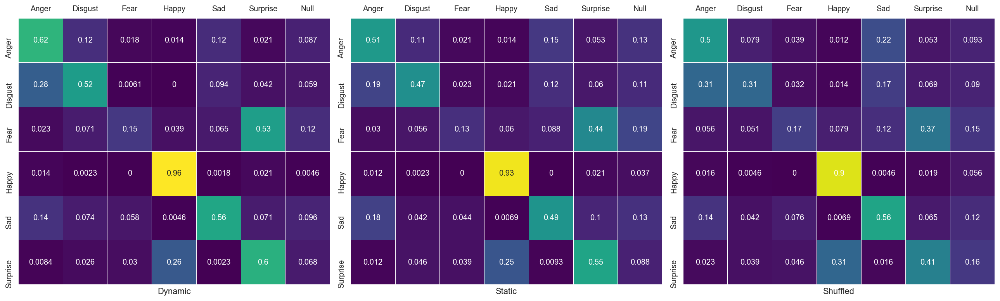


Confusion Matrix for group a07-08


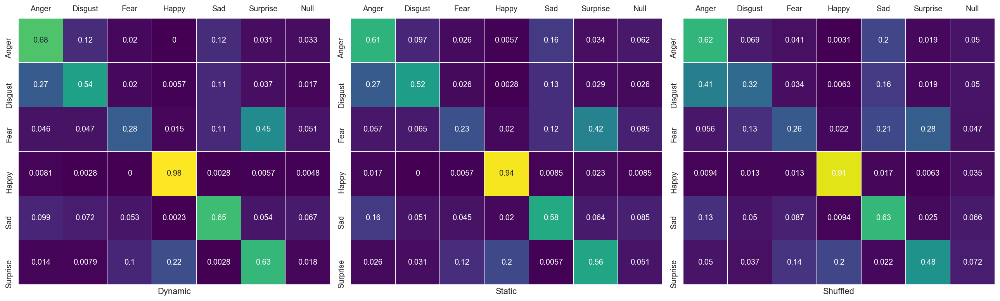


Confusion Matrix for group a09-10


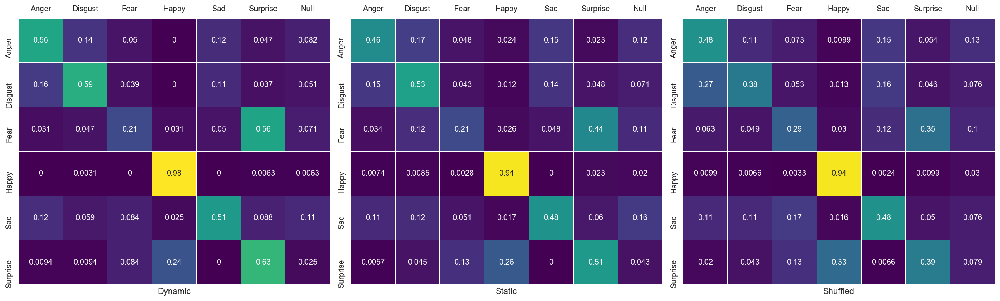


Confusion Matrix for group a11-12


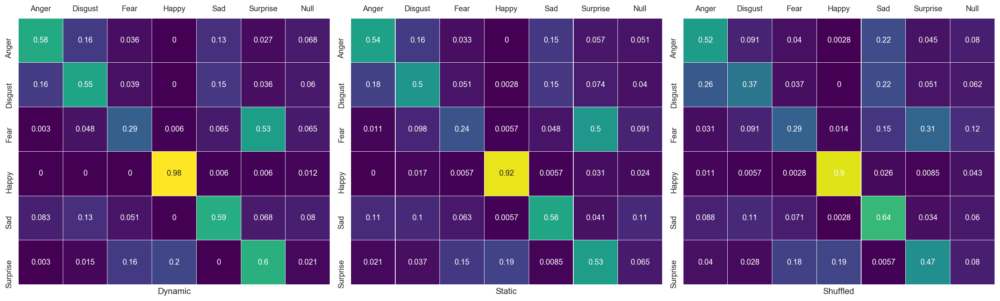


Confusion Matrix for group a13-14


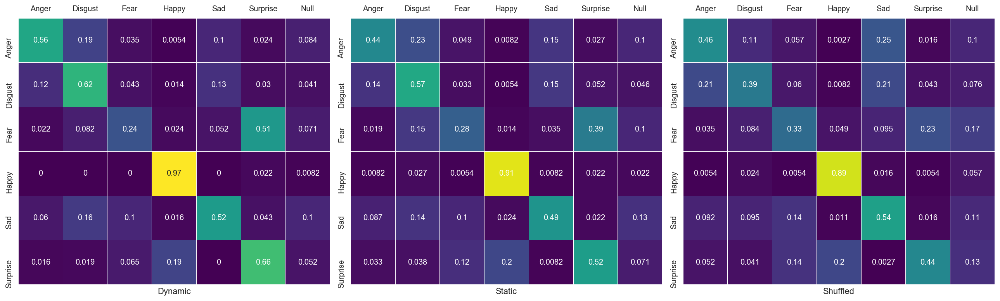


Confusion Matrix for group a15-16


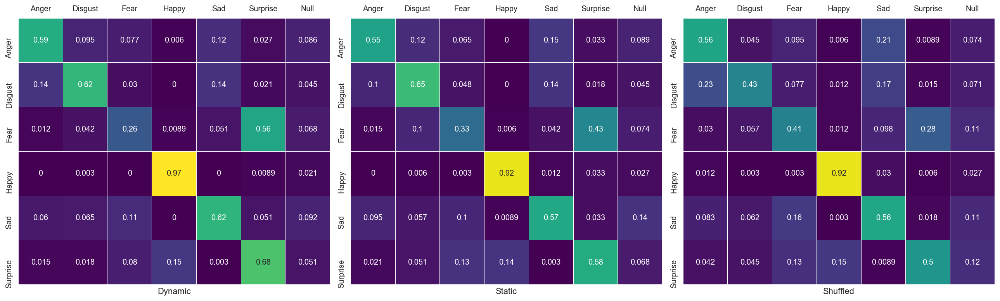


Confusion Matrix for group a17-18


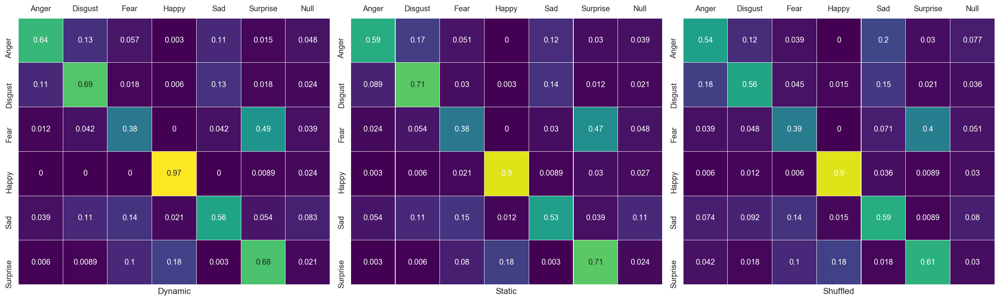


Confusion Matrix for group a19-20


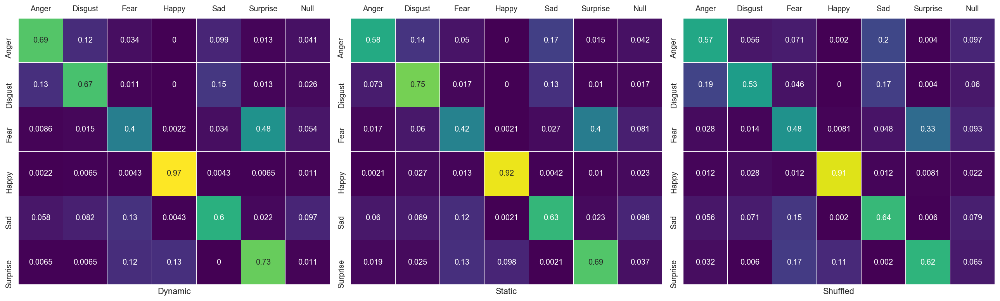


Confusion Matrix for group a21-30


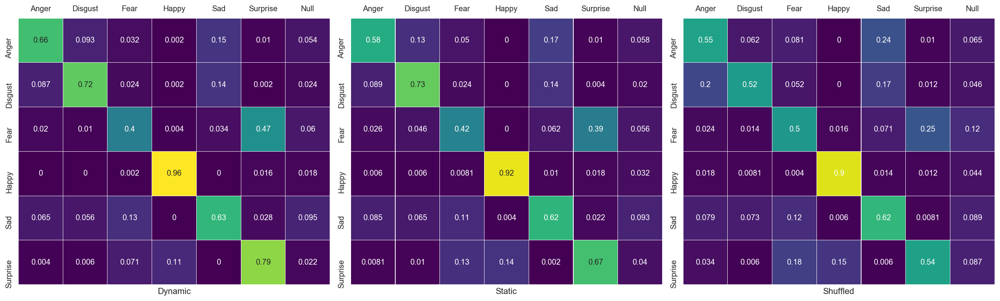


Confusion Matrix for group a31-40


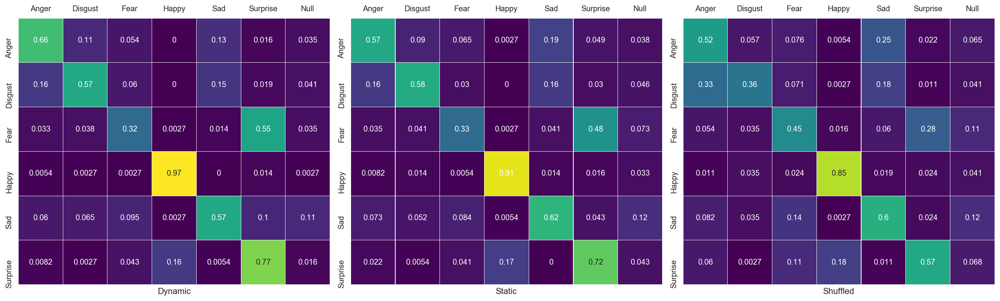


Confusion Matrix for group a41-50


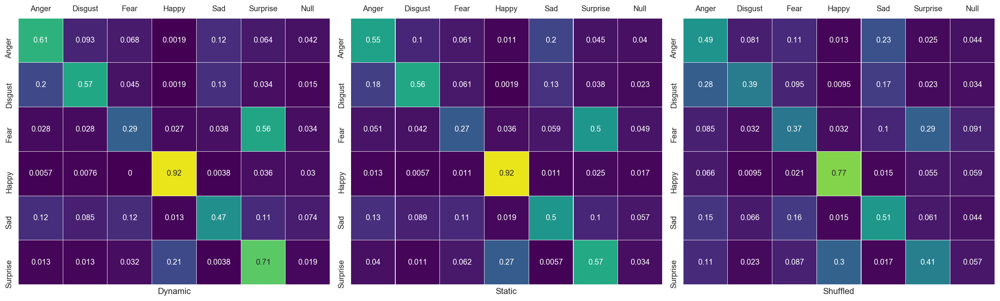


Confusion Matrix for group a51-60


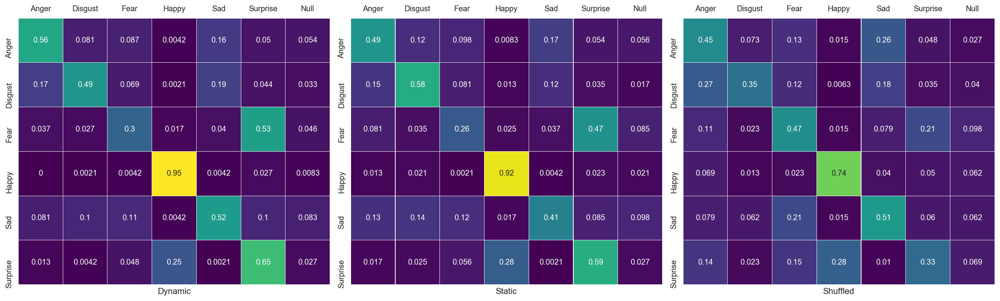


Confusion Matrix for group a61-70


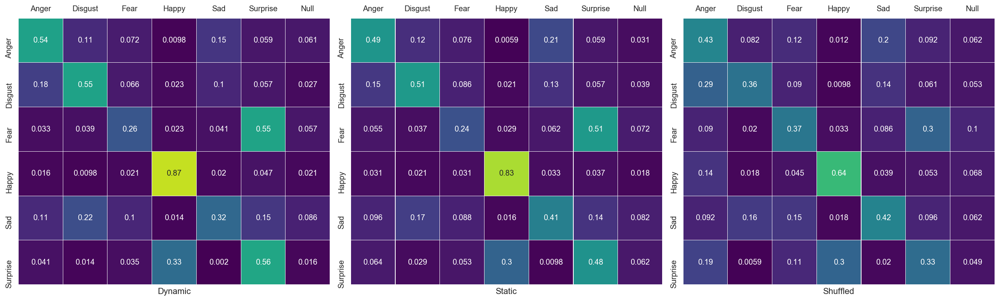


Confusion Matrix for group a71-80


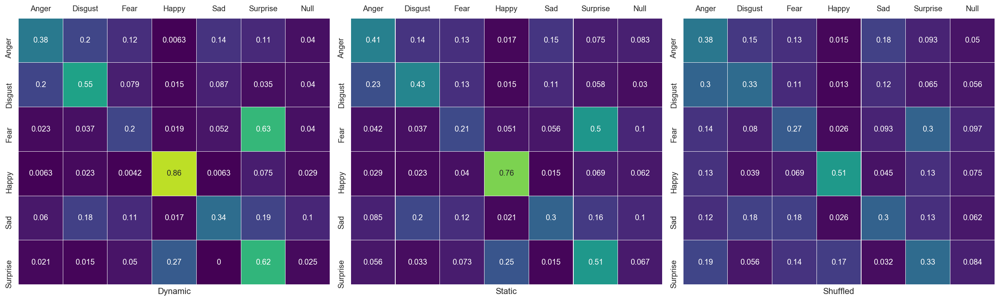


Confusion Matrix for group a81-99


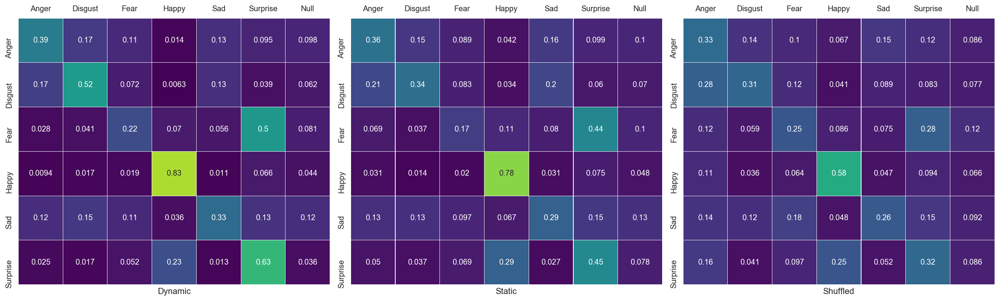

In [11]:
for iage, tblage in Info_tbl.groupby('age_group'):
    print('\nConfusion Matrix for group '+str(iage))
    Conftmp = Conf_mat[tblage.index,:,:,:6]
    Conftrl = Conf_mat[tblage.index,:,:,6]
    tmp = Conftrl-np.sum(Conftmp,axis=3)
    Conftmp2 = np.concatenate((Conftmp,np.expand_dims(tmp,axis=3)),axis=3)
    trialnum = np.reshape(np.repeat(Conftrl,7,axis=2),newshape=Conftmp2.shape)
    Confgroup = Conftmp2/trialnum
    if sum(Confgroup>1)>0:
        print('Error at group '+str(iage))
    plt.figure(figsize=(18,6))
    for ij,itask in enumerate(Tasksel):
        idx = np.where(Taskname == itask)[0][0]
        mattmp  = Confgroup[:,idx,:,:]
        meanmat = np.mean(mattmp[np.isfinite(mattmp[:,0,0]),:,:],axis=0)
        conf_mean = pd.DataFrame(meanmat,columns=resp_list,index=exp_list)
        ax = plt.subplot(1,3,ij+1)
        sns.heatmap(conf_mean, annot=True, vmin=0,vmax=.95,cbar=False, square = True,
                    linewidths=.1, cmap='viridis',ax=ax)
        ax.xaxis.tick_top()
        plt.xlabel(itask)
    plt.tight_layout()
    plt.show()

### Lineplot of accurate recognition as a function of age
It is the same as displaying the diagonal of the confusion matrix

In [12]:
Conftmp = Conf_mat[:,:,:,:6]
# NaN response as ignore
# Conftrl = np.sum(Conftmp,axis=3)
# trialnum = np.reshape(np.repeat(Conftrl,6,axis=2),newshape=Conftmp.shape)
# NaN response as incorrect
trialnum = np.reshape(np.repeat(Conf_mat[:,:,:,6],6,axis=2),newshape=Conftmp.shape)
Confmean = Conftmp/trialnum

Displaying Dynamic condition


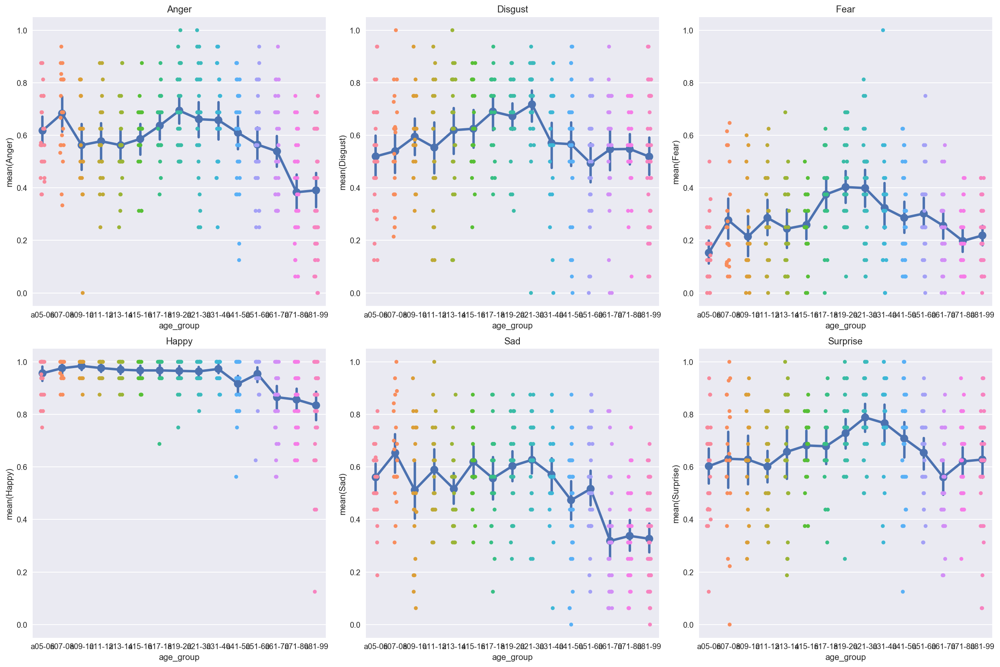

In [13]:
itask = 'Dynamic'
print('Displaying '+str(itask)+' condition')
idx = np.where(Taskname == itask)[0][0]
mattmp  = Confmean[:,idx,:,:]

plt.figure(figsize=(18,12))
datatbl1 = pd.DataFrame.copy(Info_tbl)
for ic, emolabel in enumerate(exp_list):
    datatbl1[emolabel] = mattmp[:,ic,ic]
    ax = plt.subplot(2,3,ic+1)
    sns.stripplot(x="age_group", y=emolabel, data=datatbl1, jitter=True, ax=ax);
    sns.pointplot(x="age_group", y=emolabel, data=datatbl1, estimator=np.mean, ci=95, n_boot=1000, ax=ax);
    plt.title(emolabel)
    plt.ylim([-.05,1.05])
plt.tight_layout()
plt.show()

Displaying Static condition


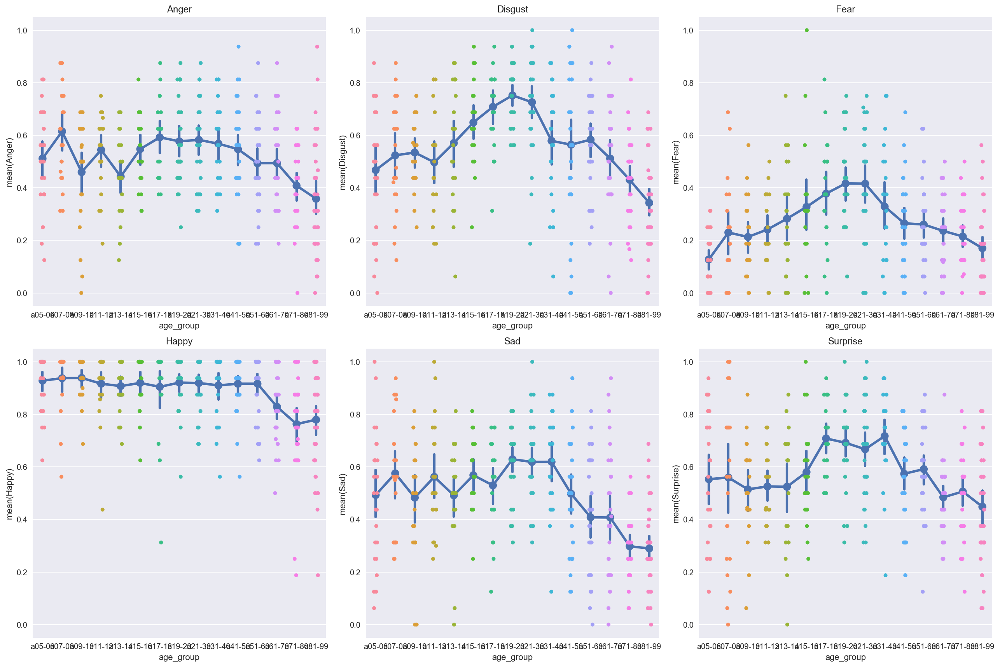

In [14]:
itask = 'Static'
print('Displaying '+str(itask)+' condition')
idx = np.where(Taskname == itask)[0][0]
mattmp  = Confmean[:,idx,:,:]

plt.figure(figsize=(18,12))
datatbl2 = pd.DataFrame.copy(Info_tbl)
for ic, emolabel in enumerate(exp_list):
    datatbl2[emolabel] = mattmp[:,ic,ic]
    ax = plt.subplot(2,3,ic+1)
    sns.stripplot(x="age_group", y=emolabel, data=datatbl2, jitter=True, ax=ax);
    sns.pointplot(x="age_group", y=emolabel, data=datatbl2, estimator=np.mean, ci=95, n_boot=1000, ax=ax);
    plt.title(emolabel)
    plt.ylim([-.05,1.05])
plt.tight_layout()
plt.show()

Displaying Shuffled condition


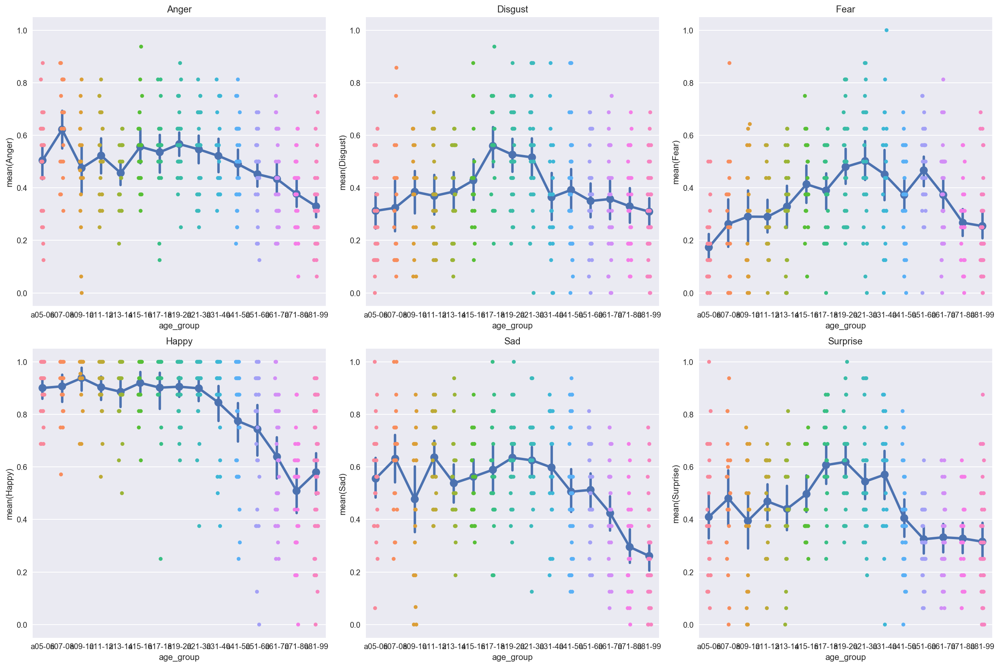

In [15]:
itask = 'Shuffled'
print('Displaying '+str(itask)+' condition')
idx = np.where(Taskname == itask)[0][0]
mattmp  = Confmean[:,idx,:,:]

plt.figure(figsize=(18,12))
datatbl3 = pd.DataFrame.copy(Info_tbl)
for ic, emolabel in enumerate(exp_list):
    datatbl3[emolabel] = mattmp[:,ic,ic]
    ax = plt.subplot(2,3,ic+1)
    sns.stripplot(x="age_group", y=emolabel, data=datatbl3, jitter=True, ax=ax);
    sns.pointplot(x="age_group", y=emolabel, data=datatbl3, estimator=np.mean, ci=95, n_boot=1000, ax=ax);
    plt.title(emolabel)
    plt.ylim([-.05,1.05])
plt.tight_layout()
plt.show()

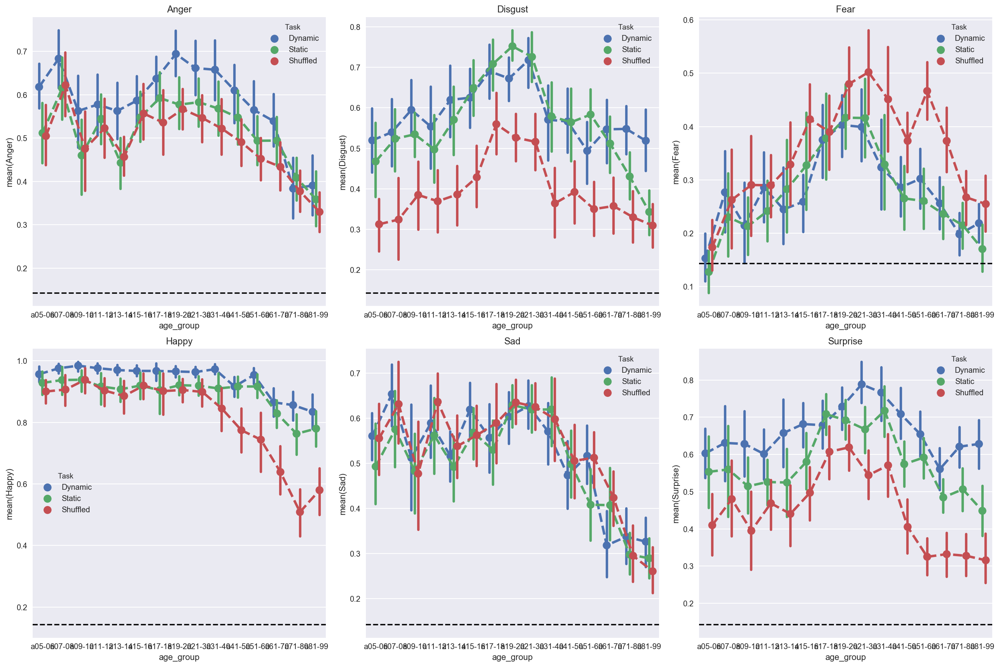

In [16]:
datatbl1['Task'] = 'Dynamic'
datatbl2['Task'] = 'Static'
datatbl3['Task'] = 'Shuffled'
datatbl_123 = pd.concat([datatbl1,datatbl2,datatbl3])

plt.figure(figsize=(18,12))
for ic, emolabel in enumerate(exp_list):
    ax = plt.subplot(2,3,ic+1)
    sns.pointplot(x="age_group", y=emolabel, hue='Task',dodge=.35,linestyles='--',
                  data=datatbl_123, estimator=np.mean, ci=95, n_boot=1000, ax=ax);
    ax.axhline(1/7,linestyle='--', color='k')
    plt.title(emolabel)
    
plt.tight_layout()
plt.show()

### Dynamic advantage as a function of age

Displaying difference: Dynamic - Static


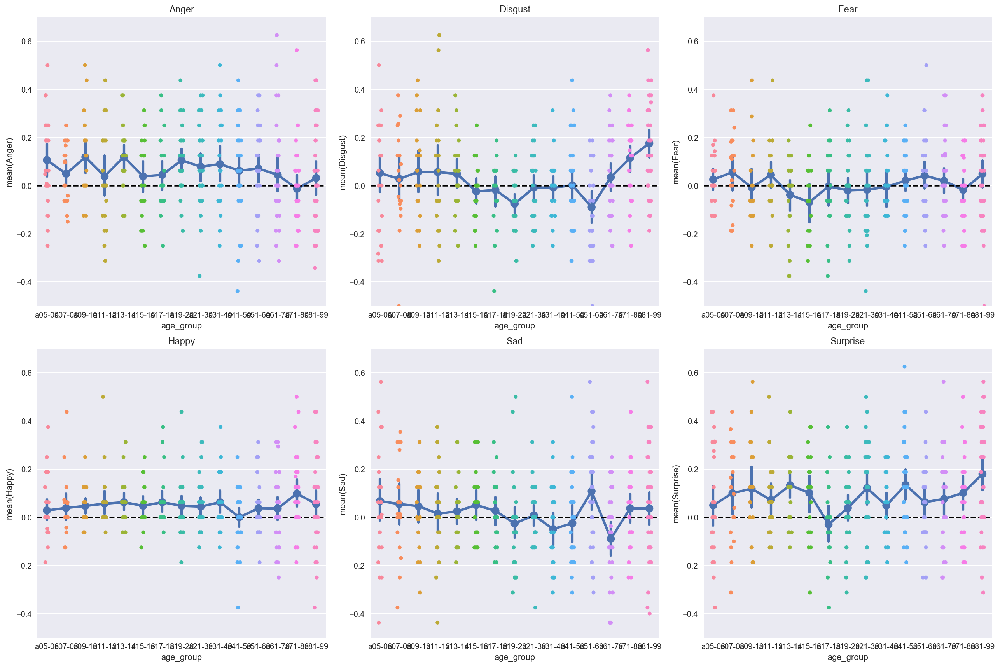

In [17]:
itask1 = 'Dynamic'
idx1 = np.where(Taskname == itask1)[0][0]
itask2 = 'Static'
idx2 = np.where(Taskname == itask2)[0][0]
mattmp  = Confmean[:,idx1,:,:]-Confmean[:,idx2,:,:]
print('Displaying difference: Dynamic - Static')

plt.figure(figsize=(18,12))
datatbl = pd.DataFrame.copy(Info_tbl)
for ic, emolabel in enumerate(exp_list):
    datatbl[emolabel] = mattmp[:,ic,ic]

    ax = plt.subplot(2,3,ic+1)
    sns.stripplot(x="age_group", y=emolabel, data=datatbl, jitter=True, ax=ax);
    sns.pointplot(x="age_group", y=emolabel, data=datatbl, estimator=np.mean, ci=95, n_boot=1000, ax=ax);
    ax.axhline(0,linestyle='--', color='k')
    plt.title(emolabel)
    plt.ylim([-.5,.7])
    #plt.ylim([-.2,.2])
    
plt.tight_layout()
plt.show()

### Display Raw

Displaying Dynamic condition
Displaying Static condition
Displaying Shuffled condition


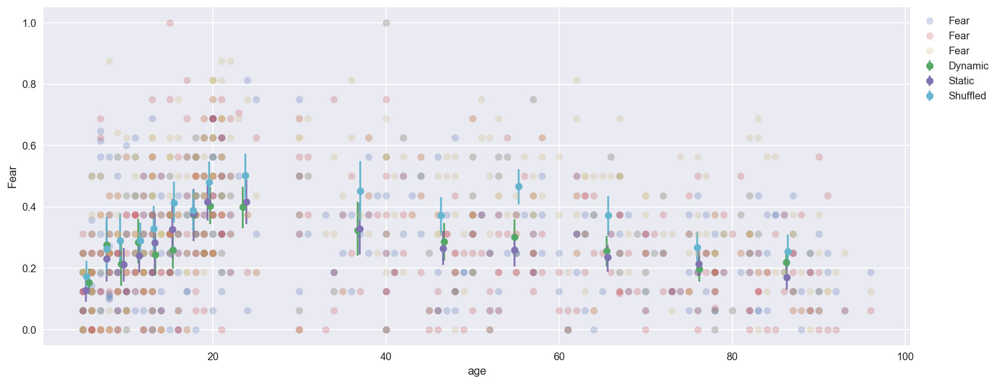

In [18]:
def plotraw(itask,emolabel,datatbl_123,ax):
    print('Displaying '+str(itask)+' condition')
    dftmp = datatbl_123.loc[datatbl_123['Task']==itask]
    ax.plot(dftmp['age'],dftmp[emolabel],'o',alpha=.25,label=emolabel)

    Nboot = 1000
    age_mean, acc_mean, acc_ci = [] , [] , []
    for iage in dftmp['age_mean'].unique():
        idex = dftmp['age_mean']==iage
        age_mean.append(iage)
        respvec = dftmp[emolabel][idex]
        meanvec = np.nanmean(np.random.choice(respvec,(len(respvec),Nboot)),axis=0)

        acc_mean.append(np.nanmean(respvec))
        acc_ci.append(np.percentile(meanvec,[2.5,97.5]))
    age_mean=np.asarray(age_mean)
    acc_mean=np.asarray(acc_mean)
    acc_ci=np.asarray(acc_ci)
    acc_ci[:,0]=acc_mean-acc_ci[:,0]
    acc_ci[:,1]=acc_ci[:,1]-acc_mean
    ax.errorbar(age_mean + (np.random.rand(age_mean.shape[0])-.5)*.5, acc_mean,
                yerr=acc_ci.transpose(), fmt='o', label=itask)
    
    ax.legend(loc=2, bbox_to_anchor=(1, 1))
    plt.ylabel(emolabel)
    plt.xlabel('age')
    
# itask  = 'Dynamic'
emolabel = 'Fear'
fig,ax= plt.subplots(1,1,figsize=(15,6))
for itask in ['Dynamic','Static','Shuffled']:
    plotraw(itask,emolabel,datatbl_123,ax=ax)

plt.show()

# Facial expression recognition as a function of age
We are interested in the dynamic advantage of facial expression, as displayed above, expression recognition accuracy follow a curve of first increase and then decrease. Moreover, some expression shows a general dynamic display advantage (i.e., higher accuracy in dynamic versus static condition). However, the question remains whether there is a stronger dynamic advantage when the biological system is a more fragile statue (i.e., in the early age when the system still developing, and in the later age when the system is in decline).

0.65 0.3


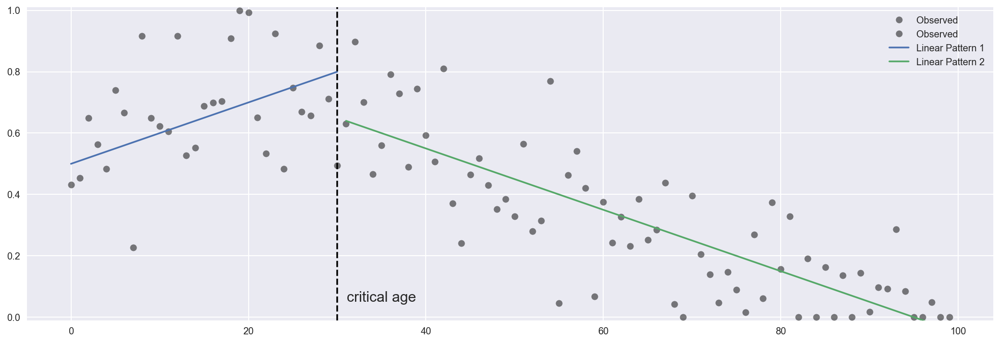

In [19]:
def emo_reg_model(intercept1,intercept2,critical_age,slope1,slope2,noise_level,
                  lmfunc=lambda intcept, delta, x: intcept + (delta*x)):
    '''
    critical_age: the onset age of cognitive decline
    intercept1: average recogtnition ability before the critical age
    intercept2: average recogtnition ability after the critical age
    slope1,slope2: linear function between age and recognition ability
    '''
    age1 = 0
    age2 = 100
    
    x1 = np.arange(age1,critical_age+1)
    y1 = lmfunc(intercept1,slope1,x1)
    noise1 = np.random.randn(len(x1))*noise_level
    x2 = np.arange(critical_age+1,age2)
    y2 = lmfunc(intercept2,slope2,x2) 
    noise2 = np.random.randn(len(x2))*noise_level
    
    y1real = np.clip(y1+noise1,0,1)
    y2real = np.clip(y2+noise2,0,1)
    print(y1.mean(),y2.mean())
    ax1=plt.plot(x1,y1real,'o',x2,y2real,'o',color='k',alpha=.5,label='Observed')
    ax2=plt.plot(x1,y1,label='Linear Pattern 1')
    ax3=plt.plot(x2,y2,label='Linear Pattern 2')
    plt.legend()
    plt.axvline(critical_age,linestyle='--', color='k')
    plt.text(critical_age+5, .05, r"critical age",
         horizontalalignment='center', fontsize=15)
    plt.ylim([-.01,1.01])

fig, ax = plt.subplots(1,1,figsize=(18,6))
emo_reg_model(.5,.95,30,0.01,-0.01,.15)

Formally, this is a [Piecewise Linear Regression Models](https://en.wikipedia.org/wiki/Piecewise_linear_function) (see [here](https://onlinecourses.science.psu.edu/stat501/node/310), and [here](http://datacolada.org/27) explaining why it is more appropreate than fitting a U-shape function expressed as high degree polynomial function). 
Here, we will express it as a Hierarchical Bayesian model and fitted in [PyMC3](https://github.com/pymc-devs/pymc3):


### Setup helper function for PyMC3

In [20]:
def getdata(itask,emolabel,agevec='age'):
    idx1 = np.where(Taskname == itask)[0][0]
    mattmp  = Conf_mat[:,idx1,:,:]
    ic = np.where(exp_list == emolabel)[0][0]
    Resp   = mattmp[:,ic,ic].astype(int)
    trials = mattmp[:,ic,-1].astype(int)
    age    = np.asarray(Info_tbl[agevec])

    incld = (np.isfinite(Resp)) & (trials > 0)
    X = age[incld]
    Y = Resp[incld]
    T = trials[incld]
    return X,Y,T

def plotfitted(agemin,critical_age,agemax,beta,intercept,cc='r'):
    lmfunc = lambda x,b,c: 1/(1+np.exp(-(x*b+c)))
    x1 = np.linspace(agemin,critical_age,100)
    y1 = lmfunc(x1,beta[0],intercept[0])
    x2 = np.linspace(critical_age,agemax,100)
    y2 = lmfunc(x2,beta[1],intercept[1])
    plt.plot(x1,y1,x2,y2,label='linear fit',color=cc)
    plt.axvline(critical_age,linestyle='--', color='k')
    plt.text(critical_age+5, -.025, r"critical age",
             horizontalalignment='center', fontsize=15)
    plt.ylim((-.05,1.05))

helper function of reading out from trace (both task modeling)

In [21]:
import pymc3 as pm
def plot_samplerstat(burnin,trace):
    # Sampler statistics
    accept = trace.get_sampler_stats('mean_tree_accept', burn=burnin)
    print('The accept rate is: %.5f' % (accept.mean()))
    diverge = trace.get_sampler_stats('diverging',burn=burnin)
    print('Diverge of the trace')
    print(diverge.nonzero())
    energy = trace['energy']
    energy_diff = np.diff(energy)
    sns.distplot(energy - energy.mean(), label='energy')
    sns.distplot(energy_diff, label='energy diff')
    plt.legend()
    plt.show()

def plot_selectposterior(burnin,trace,task1 = 'Dynamic',task2 = 'Static',):
    pm.plot_posterior(trace[burnin:],varnames=['beta1','beta2'],ref_val=0,color='#87ceeb')
    
    df_stmp = pm.df_summary(trace[burnin:],varnames=['tau'])
    trace_age = np.asarray(df_stmp['mean'])
    df_stmp = pm.df_summary(trace[burnin:],varnames=['tau1'])
    trace_age1 = np.asarray(df_stmp['mean'])
    df_stmp = pm.df_summary(trace[burnin:],varnames=['tau2'])
    trace_age2 = np.asarray(df_stmp['mean'])
    df_stmp = pm.df_summary(trace[burnin:],varnames=['b1'])
    trace_intercept1 = np.asarray(df_stmp['mean'])
    df_stmp = pm.df_summary(trace[burnin:],varnames=['beta1'])
    trace_beta1 = np.asarray(df_stmp['mean'])
    df_stmp = pm.df_summary(trace[burnin:],varnames=['b2'])
    trace_intercept2 = np.asarray(df_stmp['mean'])
    df_stmp = pm.df_summary(trace[burnin:],varnames=['beta2'])
    trace_beta2 = np.asarray(df_stmp['mean'])

    fig,ax= plt.subplots(1,1,figsize=(15,6))
    for itask in [task1,task2]:
        plotraw(itask,emolabel,datatbl_123,ax=ax)

    plotfitted(agemin,trace_age1,agemax,trace_beta1,trace_intercept1,cc='green')
    plotfitted(agemin,trace_age2,agemax,trace_beta2,trace_intercept2,cc='purple')
    ax.axvline(trace_age,linestyle='--', color='r')

    pm.plot_posterior(trace[burnin:],varnames=['betadiff'],ref_val=0,color='#87ceeb')
    pm.plot_posterior(trace[burnin:],varnames=['dync_adv1','dync_adv2'],ref_val=0,color='#87ceeb')

    plt.show()
    
    dfall = pm.df_summary(trace[burnin:],varnames=['tau','tau1','tau2',
                                                   'beta1','beta2',
                                                   'betadiff','dync_adv1','dync_adv2'])
    print(dfall)

#### Model 3 for pair comparison


In [22]:
agemin = Info_tbl['age'].min()
agemax = Info_tbl['age'].max()

def model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Static',Nsample=2000):
    X1,Y1,T1 = getdata(task1,emolabel)
    X2,Y2,T2 = getdata(task2,emolabel)
    agemin = X1.min()
    agemax = X1.max()

    Nt = 16 # number of trials by design
    logitwithdiff = pm.Model()
    with logitwithdiff:
        # Hyperpriors for slope
        mu_beta = pm.StudentT('mu_beta', nu=3, mu=0., sd=1.0)
        sigma_beta = pm.HalfNormal('sigma_beta', sd=1.0)

        # τ ∼ Uniform(0,100)
        tau = pm.Uniform('tau', lower=agemin, upper=agemax)
        tausigma = 10.
        tau1 = pm.Normal('tau1', mu=tau, sd=tausigma)
        tau2 = pm.Normal('tau2', mu=tau, sd=tausigma)

        # Recognition ability at τ 
        theta = pm.Uniform('theta', lower=0, upper=1)
        kappa_m2 = pm.Uniform('kappa',lower=0, upper=Nt-2)
        alpha = theta * kappa_m2 + 1
        beta = (1-theta) * kappa_m2 + 1
        thetak1 = pm.Beta('thetak1', alpha=alpha, beta=beta)
        thetak2 = pm.Beta('thetak2', alpha=alpha, beta=beta)

        # Model the slope
        beta1 = pm.Normal('beta1', mu=mu_beta, sd=sigma_beta, shape=2)
        beta2 = pm.Normal('beta2', mu=mu_beta, sd=sigma_beta, shape=2)
        # Model the intercept
        b1 = pm.Deterministic('b1', pm.math.logit(thetak1) - tau1*beta1)
        b2 = pm.Deterministic('b2', pm.math.logit(thetak2) - tau2*beta2)

        beta_vect1 = pm.math.switch(tau1 >= X1, beta1[0], beta1[1])
        beta_vect2 = pm.math.switch(tau2 >= X2, beta2[0], beta2[1])
        b_vect1    = pm.math.switch(tau1 >= X1, b1[0], b1[1])
        b_vect2    = pm.math.switch(tau2 >= X2, b2[0], b2[1])

        # θ = β∗age + Intercept
        theta1 = beta_vect1 * X1 + b_vect1
        yhat1 = pm.math.invlogit(theta1)
        theta2 = beta_vect2 * X2 + b_vect2
        yhat2 = pm.math.invlogit(theta2)

        obs1 = pm.Binomial('obs1', p=yhat1, n=T1, observed=Y1)
        obs2 = pm.Binomial('obs2', p=yhat2, n=T2, observed=Y2)

        # differences of slope
        betadiff = pm.Deterministic('betadiff',beta1-beta2)
        # general dynamic advantage
        dync_adv1 = pm.Deterministic('dync_adv1',pm.math.invlogit(beta1[0]*(agemin+tau)/2+b1[0]) - 
                                                 pm.math.invlogit(beta2[0]*(agemin+tau)/2+b2[0]))
        dync_adv2 = pm.Deterministic('dync_adv2',pm.math.invlogit(beta1[1]*(agemax+tau)/2+b1[1]) - 
                                                 pm.math.invlogit(beta2[1]*(agemax+tau)/2+b2[1]))

    #     step = pm.NUTS(target_accept= .9)
    #     trace = pm.sample(Nsample, njobs=2, tune=10000, step=step)
        trace = pm.sample(Nsample, tune=1000, njobs=4, init='advi+adapt_diag')
    return trace

# Dynamic vs Static

### Anger 1

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,159.6:  26%|██▋       | 52516/200000 [00:47<02:13, 1101.85it/s]
Convergence archived at 52600
Interrupted at 52,599 [26%]: Average Loss = 13,047
100%|██████████| 3000/3000 [01:08<00:00, 44.06it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 3 contains 1 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))


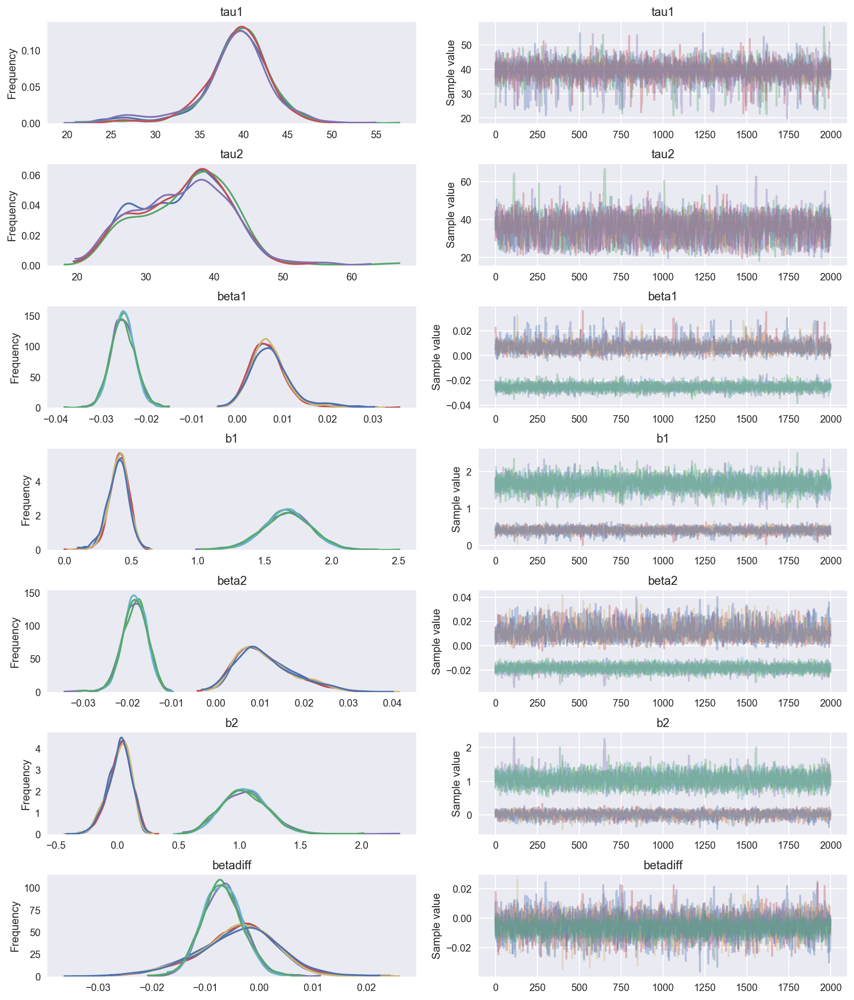

In [23]:
emolabel = 'Anger'
trace_anger = model3_diff(emolabel)
pm.traceplot(trace_anger,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.80952
Diverge of the trace
(array([7553]),)


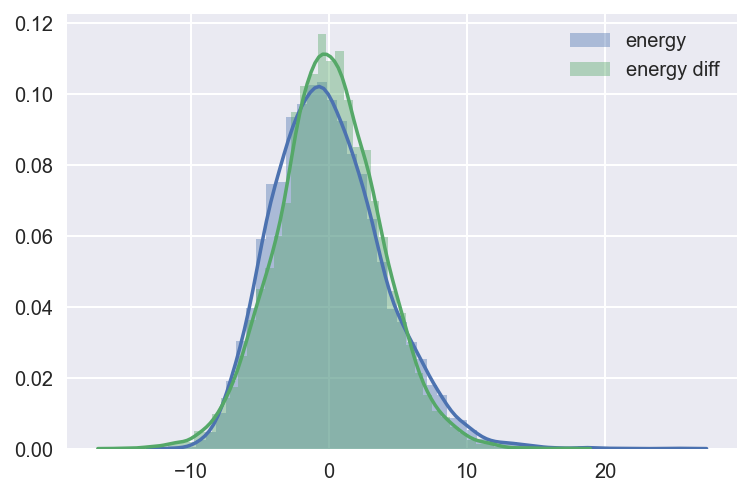

In [27]:
plot_samplerstat(burnin=0,trace=trace_anger)

Displaying Dynamic condition
Displaying Static condition


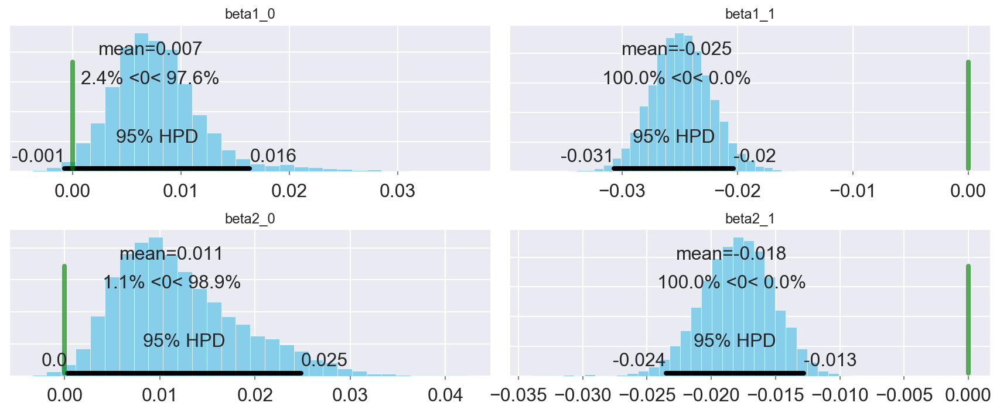

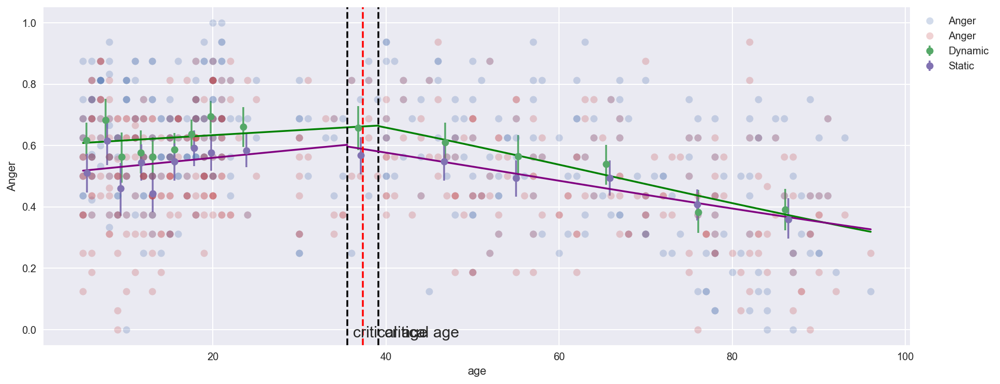

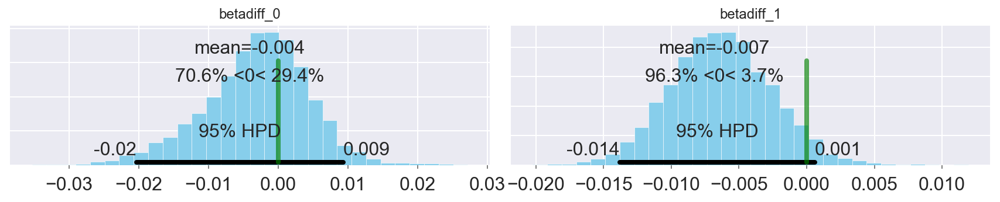

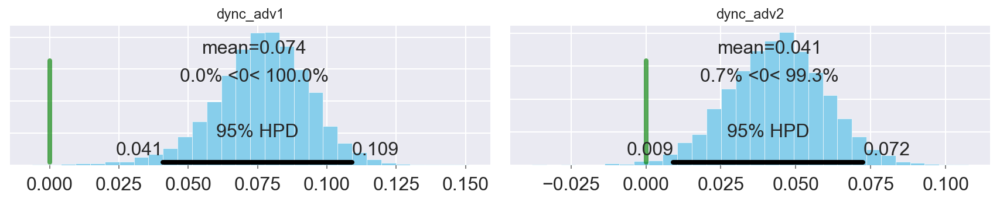

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          37.329389  8.052939  0.135196  22.330889  53.925968
tau1         39.135475  4.072290  0.093834  30.752070  47.745850
tau2         35.522530  6.572552  0.150687  23.214651  46.178261
beta1__0      0.007183  0.004491  0.000101  -0.000747   0.016362
beta1__1     -0.025252  0.002642  0.000042  -0.030707  -0.020320
beta2__0      0.011237  0.006538  0.000142   0.000281   0.024835
beta2__1     -0.018424  0.002814  0.000053  -0.023519  -0.012809
betadiff__0  -0.004054  0.007475  0.000141  -0.020309   0.009346
betadiff__1  -0.006828  0.003775  0.000063  -0.013822   0.000610
dync_adv1     0.073881  0.017161  0.000260   0.040855   0.109075
dync_adv2     0.041305  0.016194  0.000190   0.009145   0.072428


In [28]:
plot_selectposterior(burnin=0,trace=trace_anger)

### Disgust 1 

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,415.4:  85%|████████▍ | 169704/200000 [02:41<00:26, 1136.13it/s]
Convergence archived at 169800
Interrupted at 169,799 [84%]: Average Loss = 5,872.1
100%|██████████| 3000/3000 [00:56<00:00, 52.69it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 2 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))


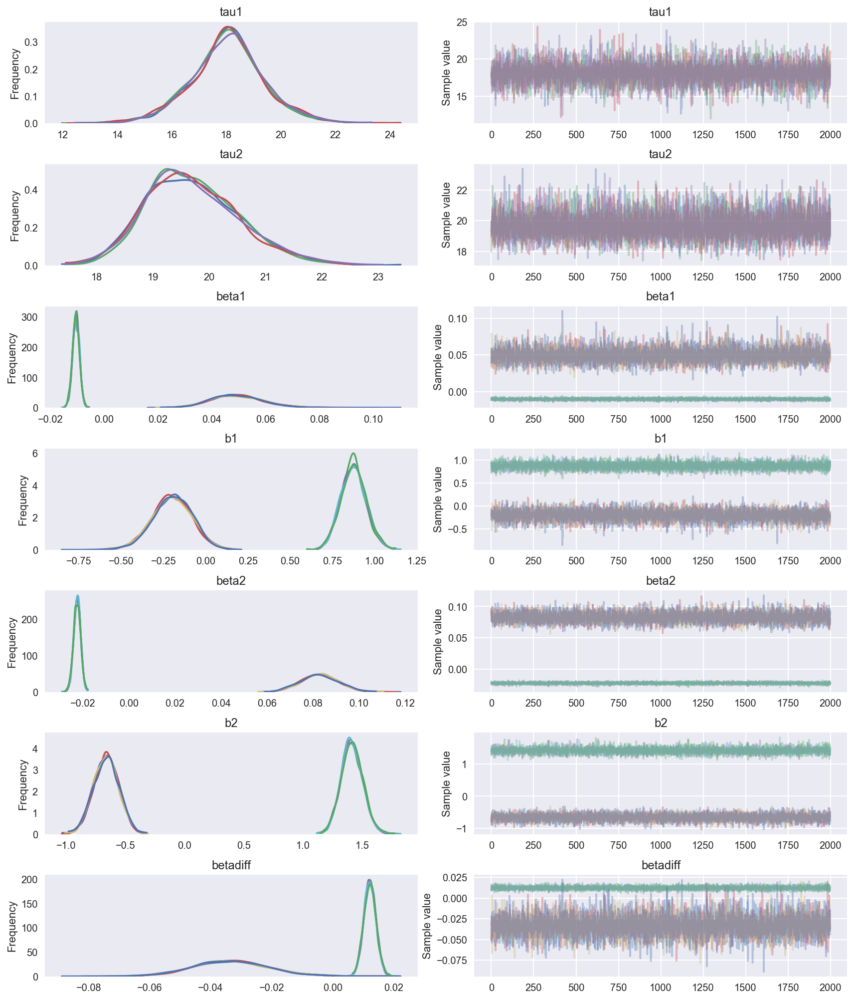

In [29]:
emolabel = 'Disgust'
trace_disgust = model3_diff(emolabel)
pm.traceplot(trace_disgust,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82684
Diverge of the trace
(array([3567, 3640]),)


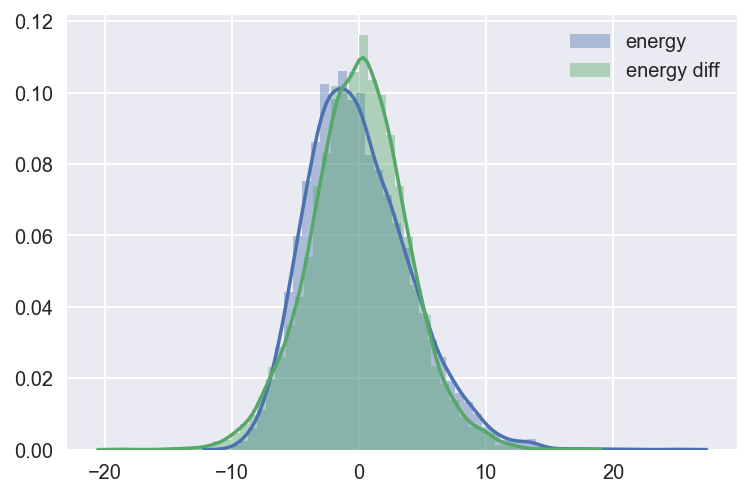

In [30]:
plot_samplerstat(burnin=0,trace=trace_disgust)

Displaying Dynamic condition
Displaying Static condition


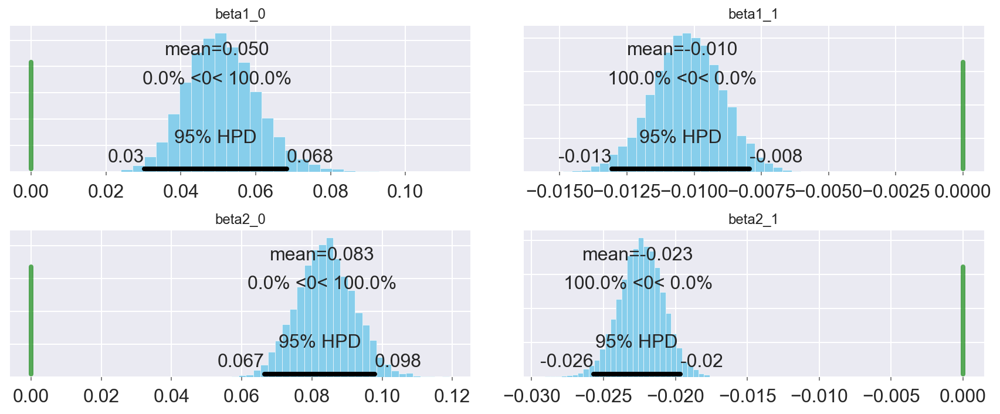

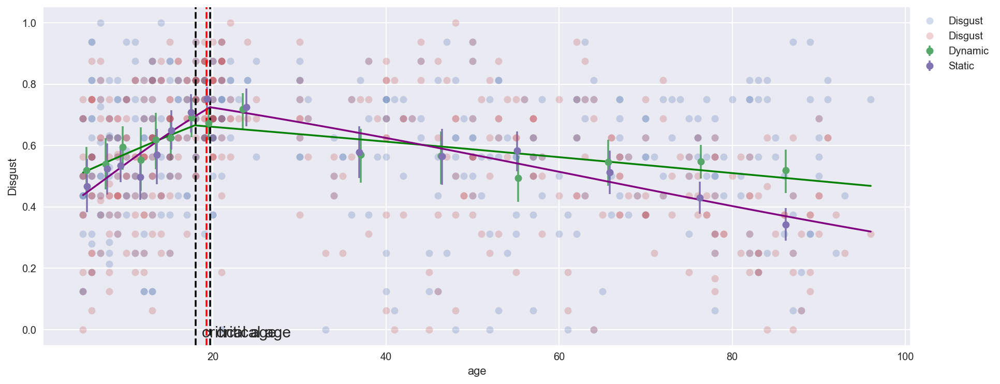

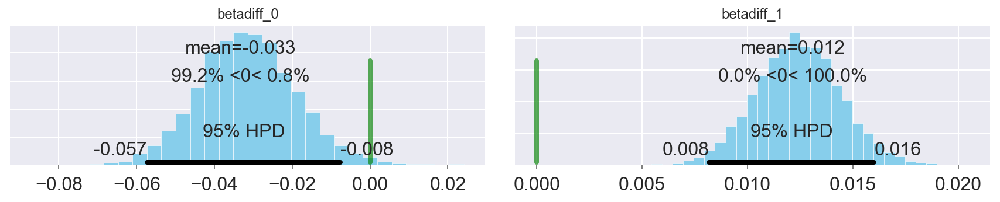

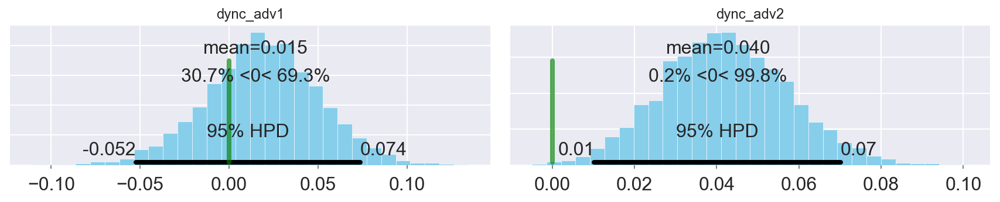

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          19.270474  6.742744  0.088489   5.845112  31.385682
tau1         18.034096  1.352511  0.017552  15.383829  20.859807
tau2         19.706842  0.833277  0.012668  18.210441  21.421645
beta1__0      0.049619  0.009786  0.000130   0.030206   0.068274
beta1__1     -0.010433  0.001298  0.000015  -0.013067  -0.007949
beta2__0      0.082889  0.008111  0.000104   0.066516   0.097908
beta2__1     -0.022590  0.001533  0.000021  -0.025713  -0.019668
betadiff__0  -0.033270  0.012606  0.000170  -0.057350  -0.007619
betadiff__1   0.012156  0.001997  0.000025   0.008169   0.016014
dync_adv1     0.014837  0.031556  0.000424  -0.052315   0.073748
dync_adv2     0.040363  0.015352  0.000189   0.010234   0.070142


In [31]:
plot_selectposterior(burnin=0,trace=trace_disgust)

### Fear 1

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,114:  66%|██████▋   | 132900/200000 [02:11<01:05, 1022.63it/s]  
Convergence archived at 133000
Interrupted at 132,999 [66%]: Average Loss = 5,655.1
 99%|█████████▉| 2971/3000 [00:55<00:00, 56.98it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 2 contains 14 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
100%|█████████▉| 2996/3000 [00:55<00:00, 58.36it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 0 contains 4 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
100%|██████████| 3000/3000 [00:55<00:00, 53.78it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 3 contains 9 diverging samples after tunin

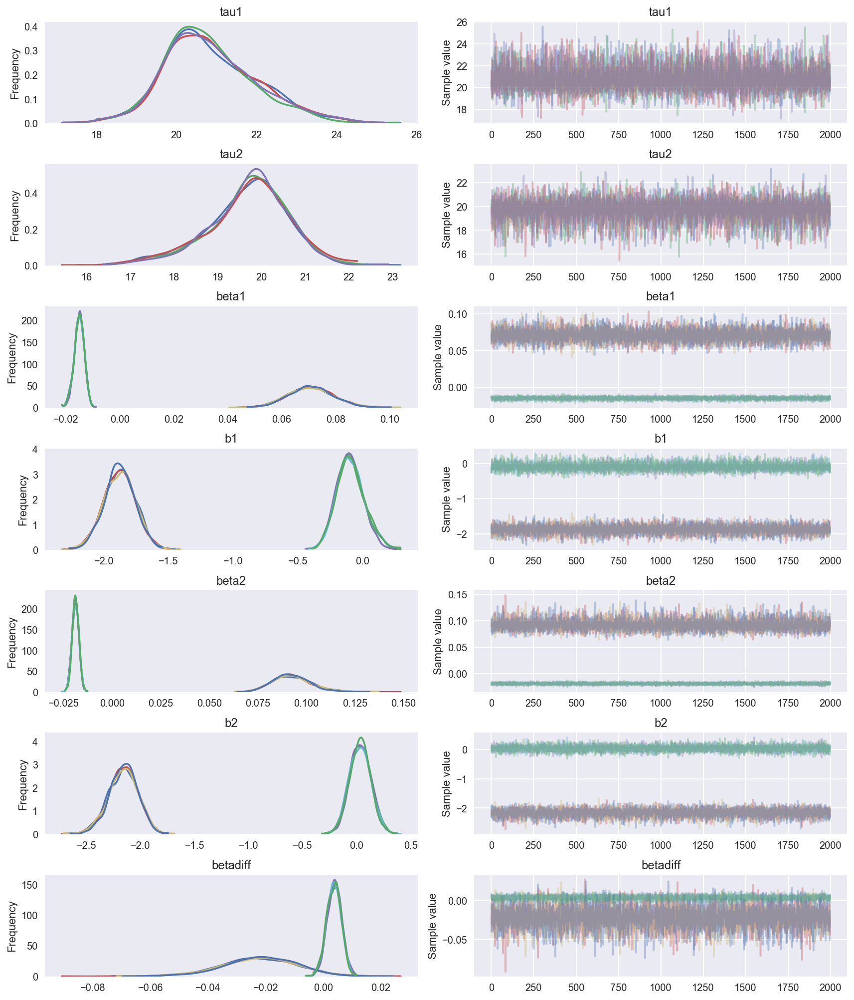

In [32]:
emolabel = 'Fear'
trace_fear = model3_diff(emolabel)
pm.traceplot(trace_fear,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.80238
Diverge of the trace
(array([ 881,  984, 1088, 1149, 4096, 4109, 4151, 4236, 4293, 4509, 4533,
       4932, 5190, 5321, 5484, 5666, 5869, 5931, 6359, 6815, 7133, 7436,
       7535, 7737, 7788, 7877, 7926]),)


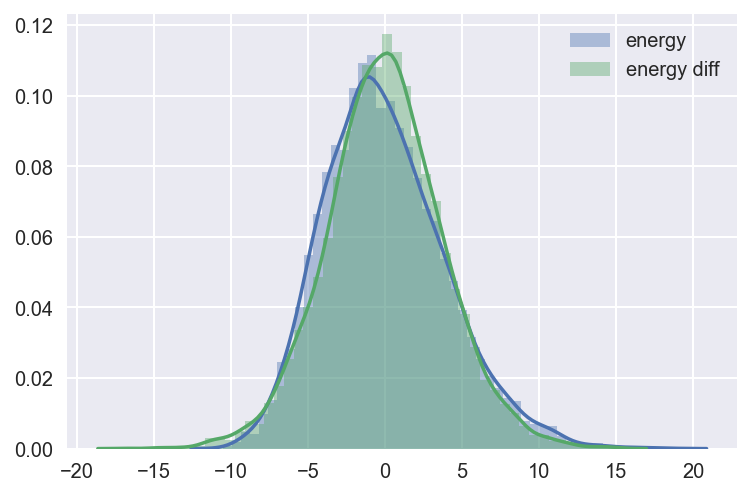

In [33]:
plot_samplerstat(burnin=0,trace=trace_fear)

Displaying Dynamic condition
Displaying Static condition


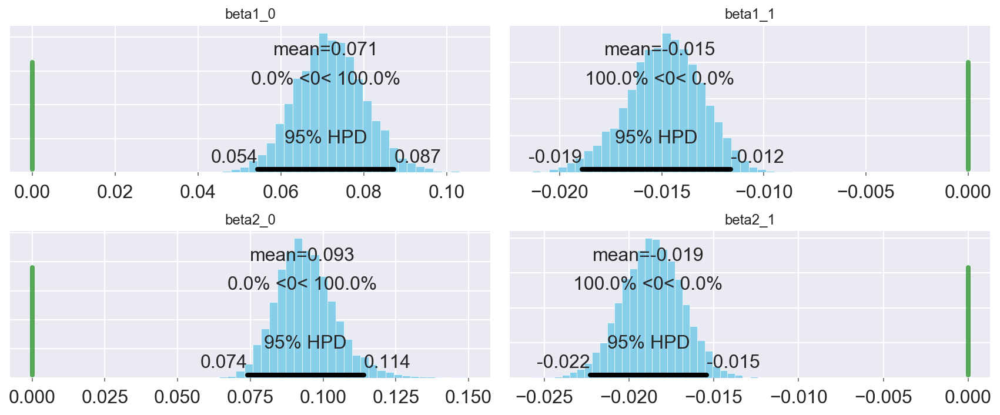

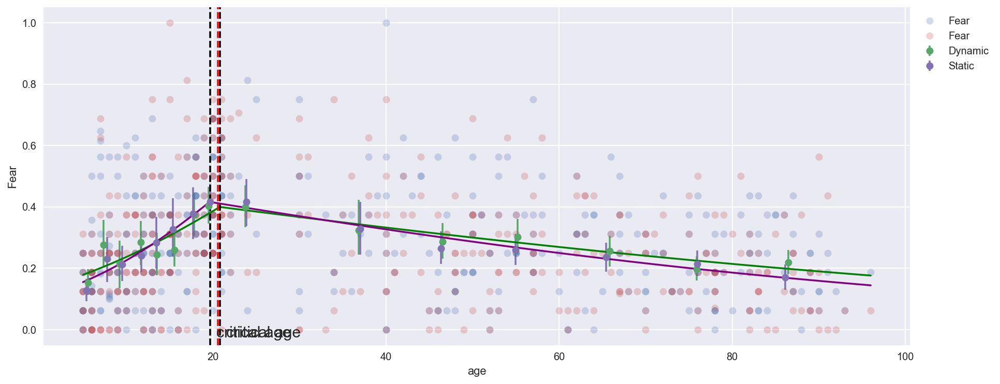

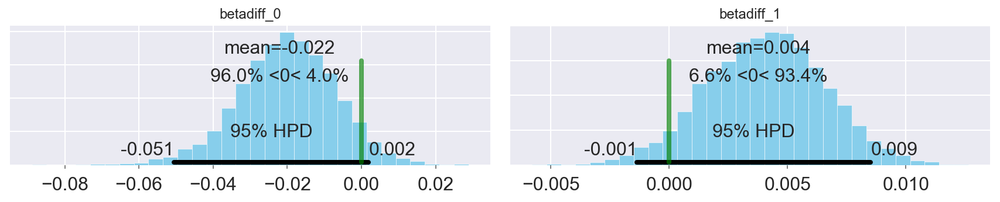

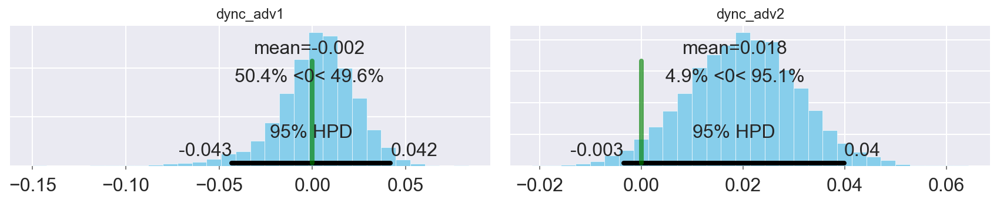

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          20.586554  6.769042  0.086693   7.679227  33.527124
tau1         20.851446  1.157756  0.016520  18.893508  23.453462
tau2         19.688110  0.942276  0.013238  17.642821  21.485143
beta1__0      0.070777  0.008436  0.000093   0.054398   0.087256
beta1__1     -0.015091  0.001850  0.000026  -0.018894  -0.011621
beta2__0      0.092820  0.010285  0.000131   0.073964   0.113985
beta2__1     -0.018865  0.001770  0.000024  -0.022295  -0.015404
betadiff__0  -0.022043  0.013213  0.000153  -0.050544   0.001910
betadiff__1   0.003774  0.002517  0.000034  -0.001362   0.008510
dync_adv1    -0.001653  0.021275  0.000233  -0.043243   0.041941
dync_adv2     0.018483  0.010980  0.000099  -0.003410   0.039858


In [34]:
plot_selectposterior(burnin=0,trace=trace_fear)

### Happy 1

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 1,452.5:  18%|█▊        | 36827/200000 [00:34<02:31, 1076.93it/s]  
Convergence archived at 36900
Interrupted at 36,899 [18%]: Average Loss = 22,541
100%|██████████| 3000/3000 [02:18<00:00, 21.62it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 1 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))


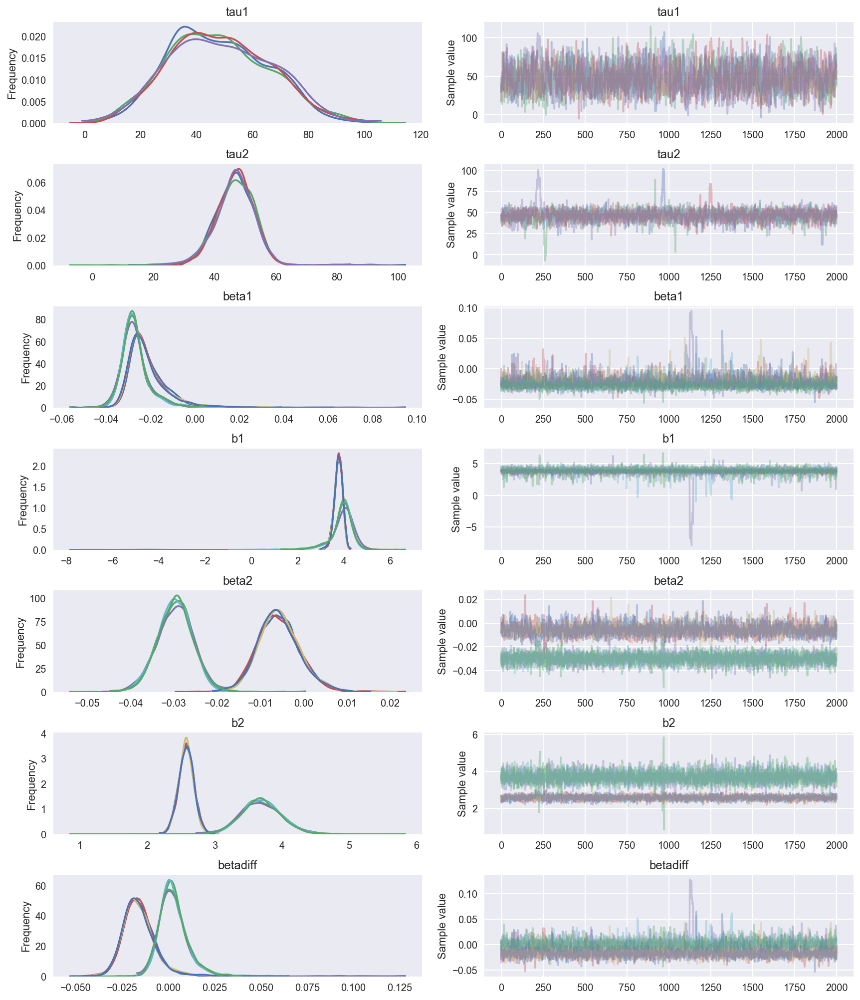

In [35]:
emolabel = 'Happy'
trace_happy = model3_diff(emolabel)
pm.traceplot(trace_happy,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.84207
Diverge of the trace
(array([3952]),)


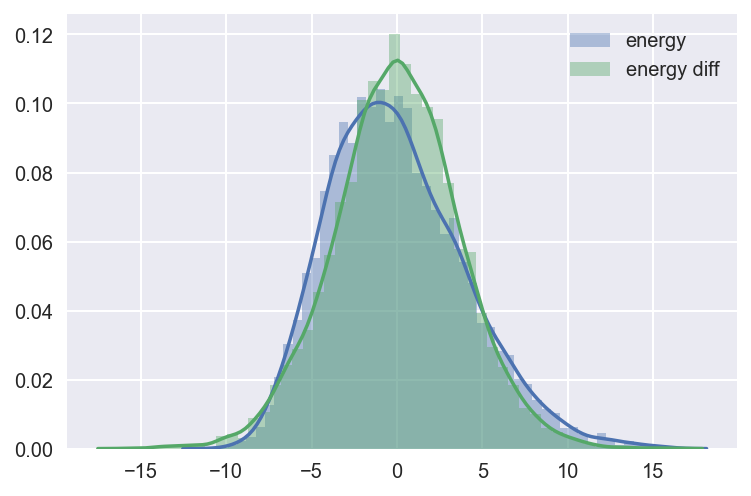

In [36]:
plot_samplerstat(burnin=0,trace=trace_happy)

Displaying Dynamic condition
Displaying Static condition


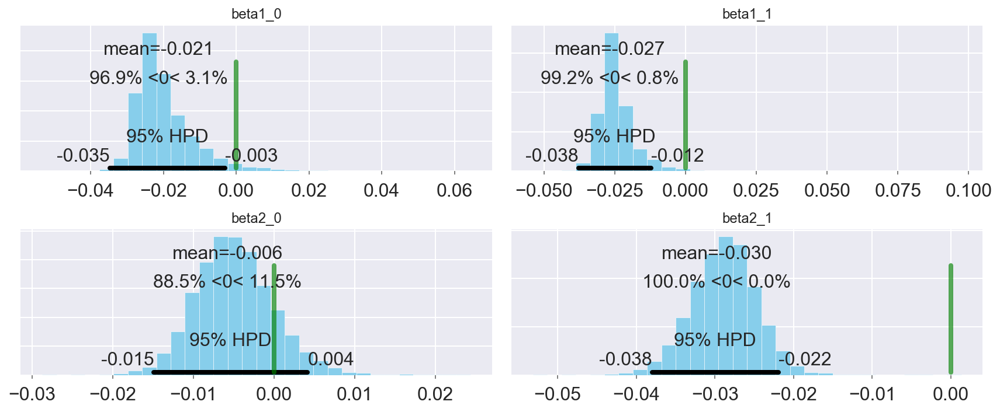

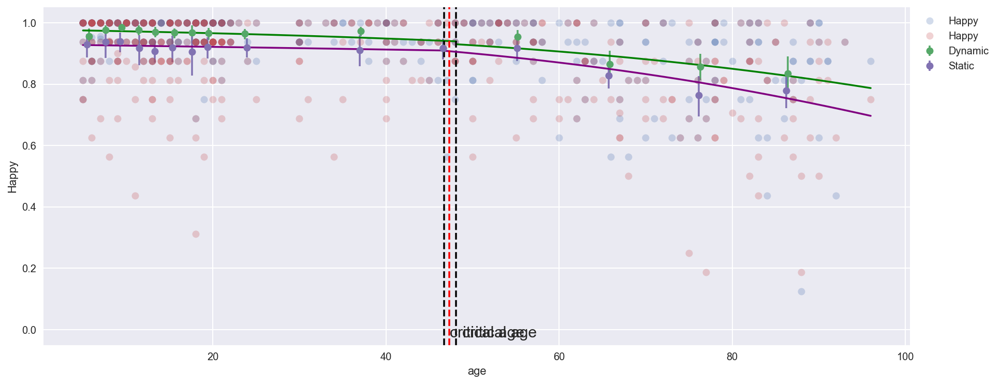

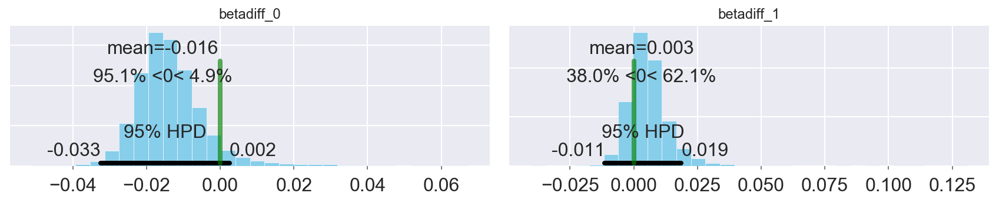

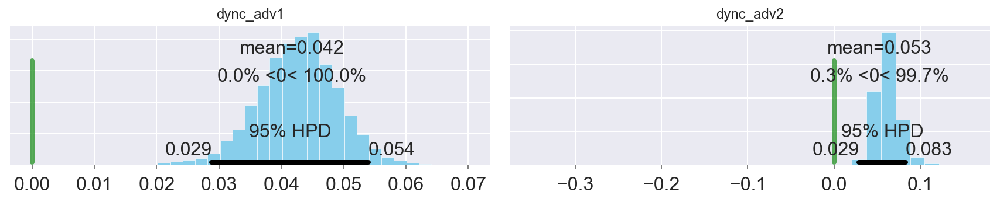

                  mean         sd  mc_error    hpd_2.5   hpd_97.5
tau          47.312253  13.028688  0.366472  22.596273  72.792230
tau1         48.113428  17.894185  0.511654  14.771339  81.612658
tau2         46.711715   7.107484  0.230993  34.034815  58.537252
beta1__0     -0.021316   0.009188  0.000225  -0.034688  -0.003081
beta1__1     -0.026687   0.008138  0.000298  -0.037798  -0.012204
beta2__0     -0.005742   0.004901  0.000111  -0.014883   0.004169
beta2__1     -0.029762   0.004159  0.000064  -0.037991  -0.021937
betadiff__0  -0.015574   0.009365  0.000192  -0.032512   0.002478
betadiff__1   0.003075   0.009216  0.000303  -0.011384   0.018645
dync_adv1     0.041673   0.006406  0.000105   0.028840   0.053988
dync_adv2     0.052991   0.016010  0.000359   0.028982   0.082827


In [37]:
plot_selectposterior(burnin=0,trace=trace_happy)

### Sad 1

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,290.5:  87%|████████▋ | 173988/200000 [02:44<00:23, 1102.99it/s]
Convergence archived at 174100
Interrupted at 174,099 [87%]: Average Loss = 5,493
100%|██████████| 3000/3000 [00:58<00:00, 51.70it/s]


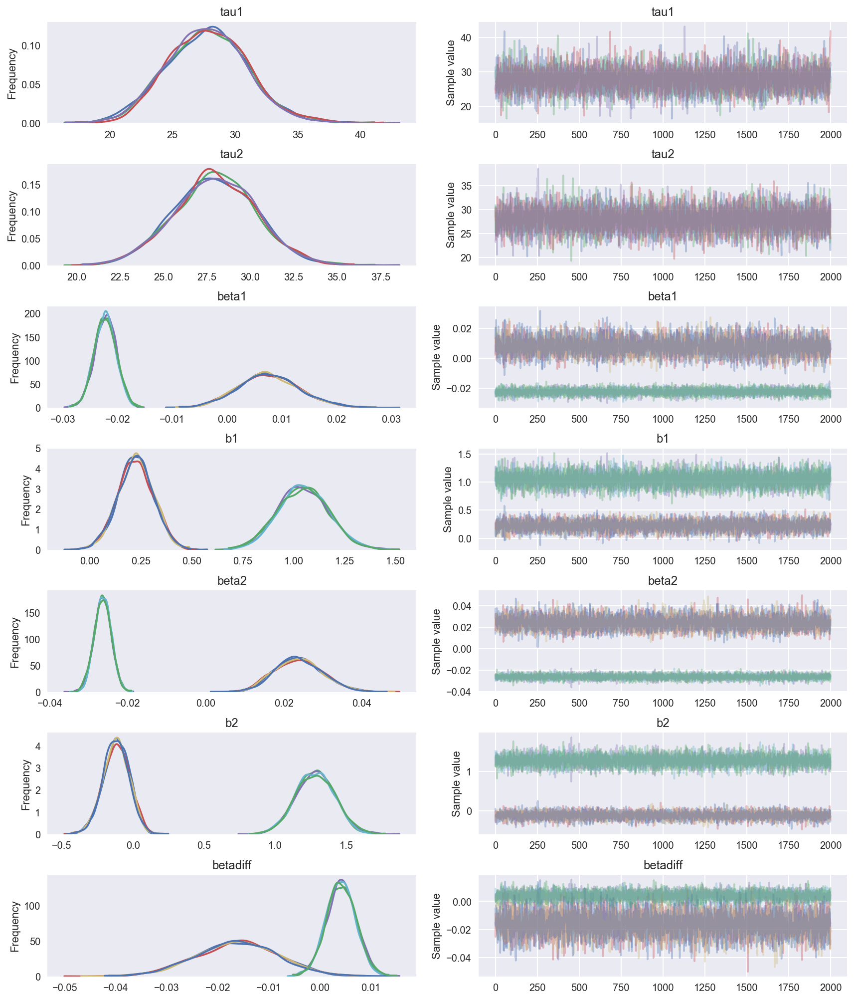

In [38]:
emolabel = 'Sad'
trace_sad = model3_diff(emolabel)
pm.traceplot(trace_sad,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.84323
Diverge of the trace
(array([], dtype=int64),)


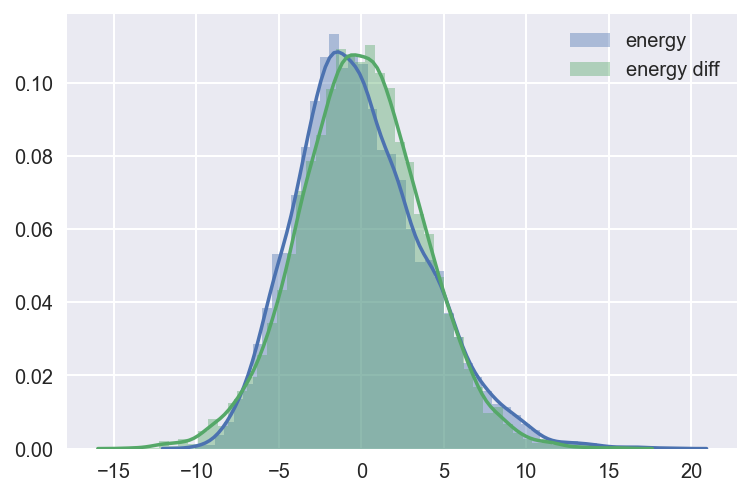

In [39]:
plot_samplerstat(burnin=0,trace=trace_sad)

Displaying Dynamic condition
Displaying Static condition


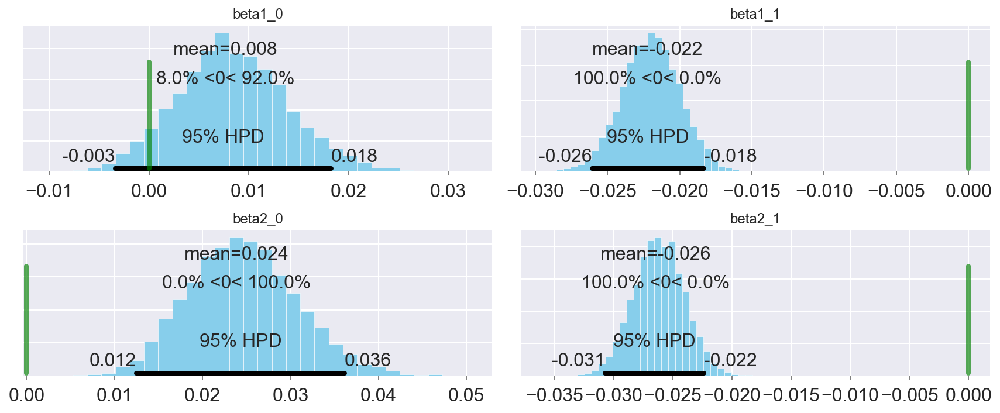

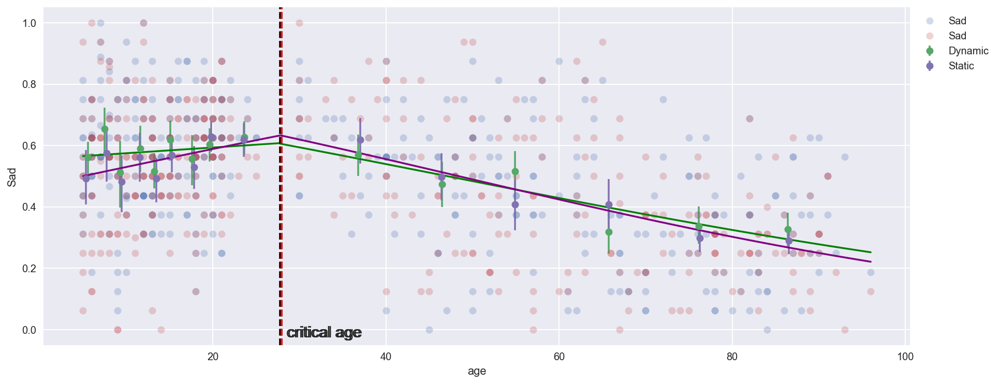

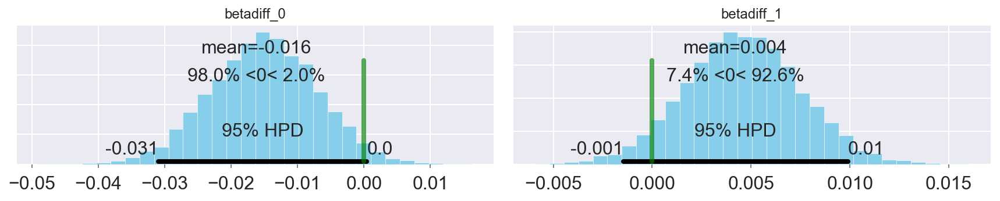

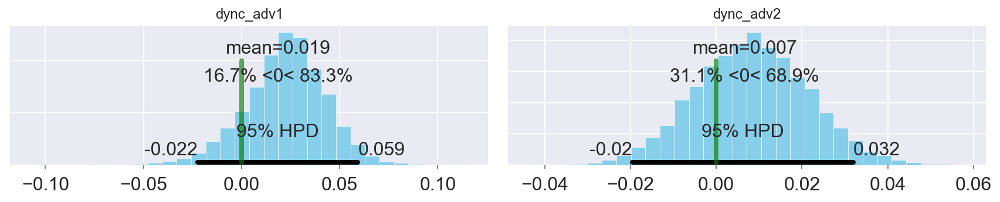

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          27.912842  7.368649  0.082174  13.883393  42.531934
tau1         27.760277  3.243266  0.050919  21.450541  34.004075
tau2         27.963342  2.373094  0.028088  23.239713  32.532344
beta1__0      0.007657  0.005534  0.000082  -0.003381   0.018278
beta1__1     -0.022237  0.001993  0.000022  -0.026075  -0.018304
beta2__0      0.023844  0.006168  0.000077   0.012470   0.036164
beta2__1     -0.026448  0.002153  0.000024  -0.030705  -0.022362
betadiff__0  -0.016187  0.008068  0.000100  -0.030957   0.000450
betadiff__1   0.004211  0.002923  0.000033  -0.001462   0.009893
dync_adv1     0.018721  0.020714  0.000221  -0.022372   0.059354
dync_adv2     0.006669  0.013233  0.000131  -0.019608   0.031999


In [40]:
plot_selectposterior(burnin=0,trace=trace_sad)

### Surprise 1

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,314.6:  65%|██████▌   | 130031/200000 [02:00<01:06, 1052.27it/s]
Convergence archived at 130100
Interrupted at 130,099 [65%]: Average Loss = 6,967.5
100%|██████████| 3000/3000 [00:56<00:00, 54.61it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 12 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))


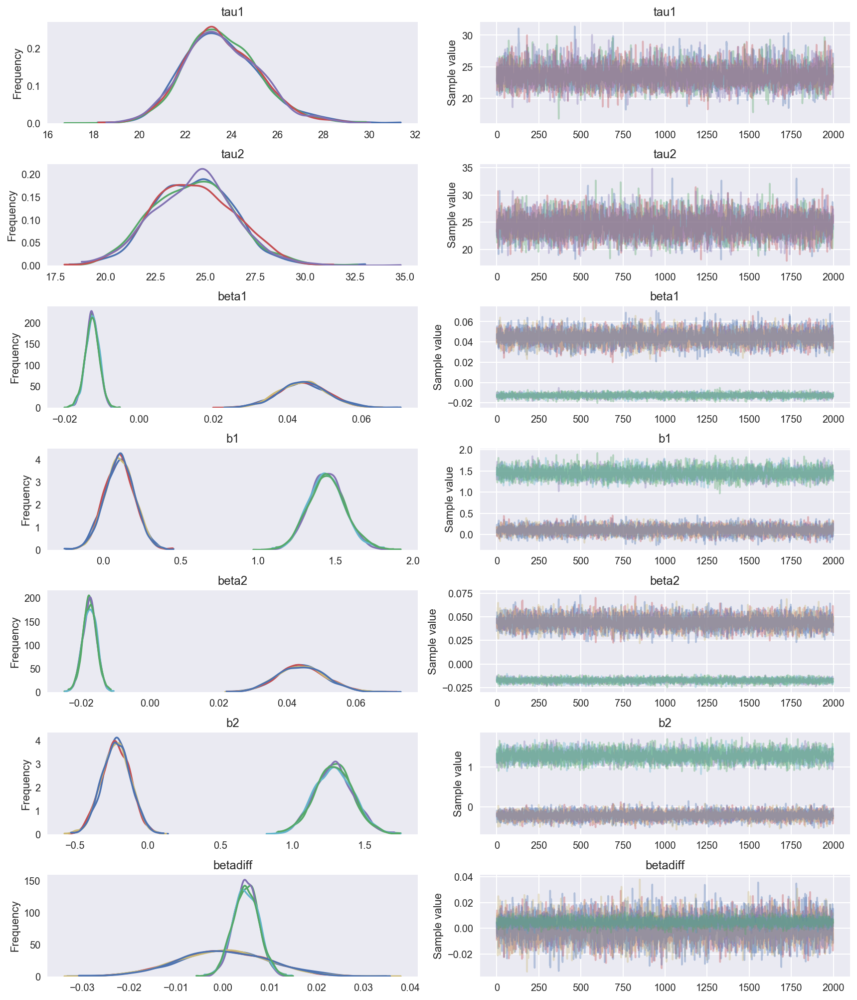

In [41]:
emolabel = 'Surprise'
trace_surprise = model3_diff(emolabel)
pm.traceplot(trace_surprise,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.81572
Diverge of the trace
(array([2159, 2268, 2507, 2520, 2847, 2874, 3156, 3184, 3206, 3252, 3748,
       3957]),)


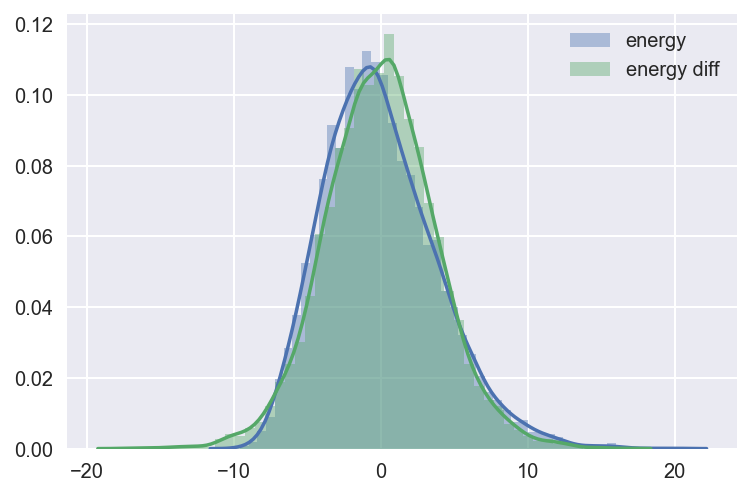

In [42]:
plot_samplerstat(burnin=0,trace=trace_surprise)

Displaying Dynamic condition
Displaying Static condition


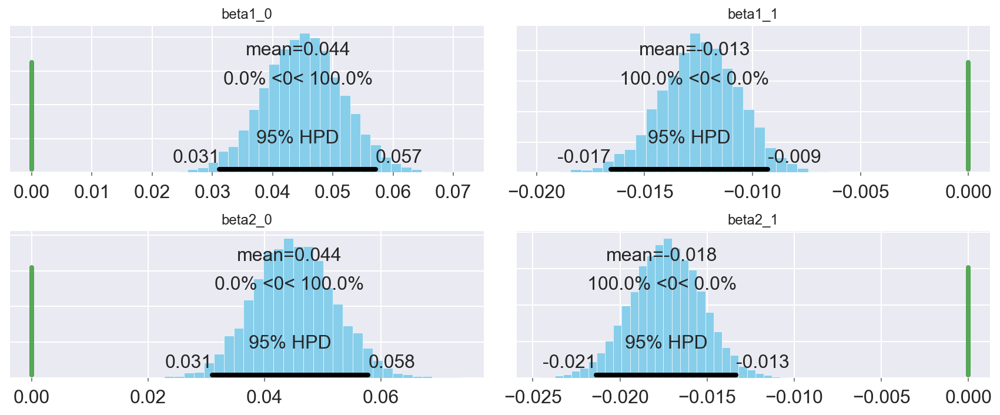

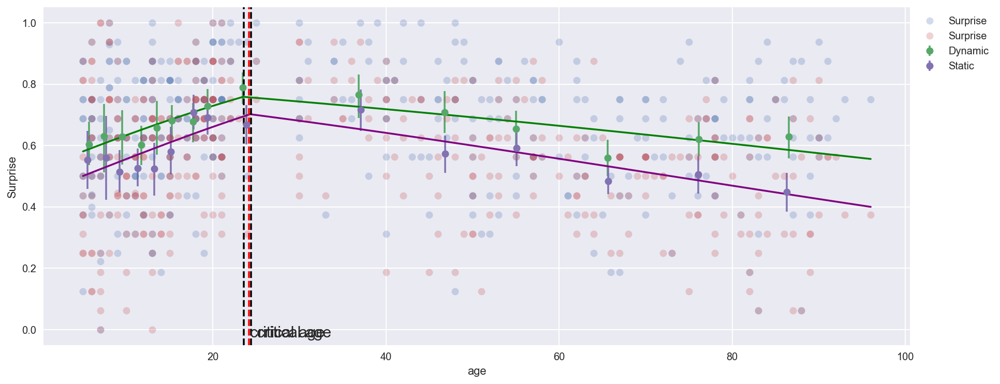

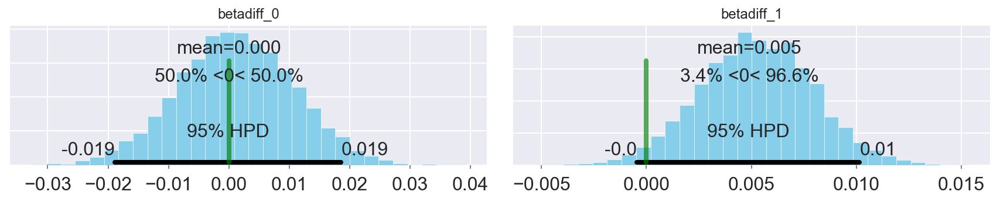

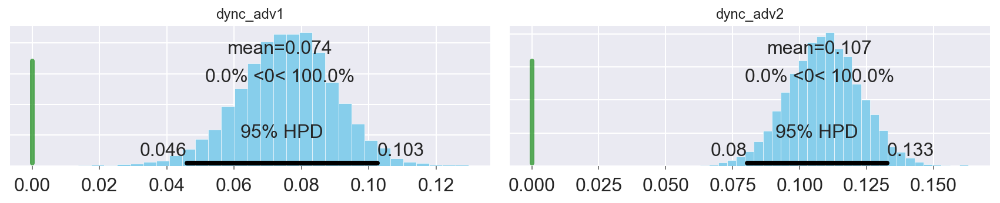

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          24.191667  7.069613  0.085900  10.415636  37.850511
tau1         23.575138  1.659415  0.020322  20.271323  26.731016
tau2         24.408625  2.026750  0.026761  20.279934  28.194232
beta1__0      0.044264  0.006590  0.000073   0.031189   0.057115
beta1__1     -0.012683  0.001837  0.000025  -0.016568  -0.009283
beta2__0      0.044232  0.006942  0.000076   0.031006   0.057813
beta2__1     -0.017598  0.002038  0.000028  -0.021371  -0.013328
betadiff__0   0.000032  0.009602  0.000111  -0.018871   0.018603
betadiff__1   0.004914  0.002698  0.000041  -0.000451   0.010161
dync_adv1     0.073739  0.014371  0.000169   0.046018   0.102533
dync_adv2     0.107479  0.013397  0.000157   0.080344   0.132648


In [43]:
plot_selectposterior(burnin=0,trace=trace_surprise)

# Dynamic vs Shuffled

### Anger 2

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,085.3:  23%|██▎       | 46626/200000 [00:46<02:15, 1132.77it/s]
Convergence archived at 46700
Interrupted at 46,699 [23%]: Average Loss = 13,977
 88%|████████▊ | 2649/3000 [01:26<00:08, 41.30it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 2 contains 136 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
 95%|█████████▍| 2836/3000 [01:30<00:03, 49.59it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 3 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
100%|█████████▉| 2996/3000 [01:33<00:00, 64.66it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 0 contains 9 diverging samples after tuning. 

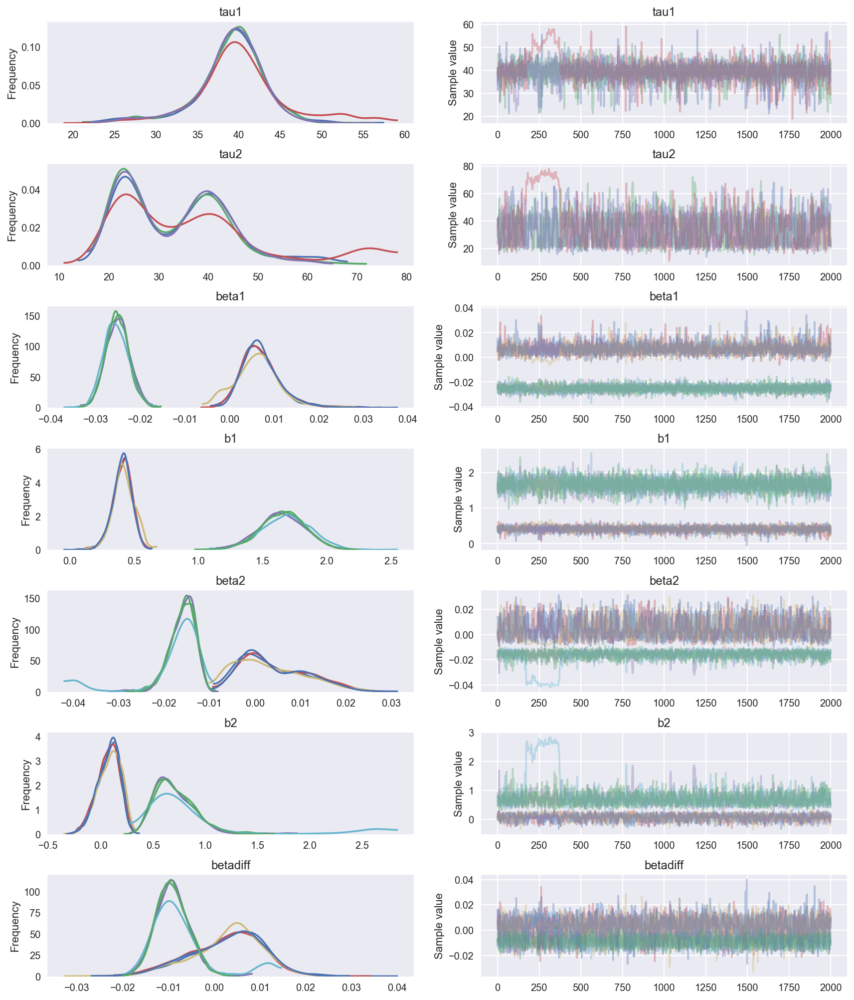

In [44]:
emolabel = 'Anger'
trace_anger = model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Shuffled')
pm.traceplot(trace_anger,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.79744
Diverge of the trace
(array([  40,  420, 1347, 1349, 1657, 1658, 1661, 1763, 1955, 2810, 3173,
       3191, 4166, 4173, 4174, 4175, 4178, 4180, 4181, 4182, 4183, 4184,
       4185, 4186, 4187, 4189, 4190, 4192, 4194, 4196, 4197, 4198, 4199,
       4201, 4202, 4203, 4204, 4205, 4208, 4212, 4213, 4217, 4219, 4224,
       4226, 4227, 4228, 4230, 4231, 4232, 4233, 4234, 4235, 4236, 4237,
       4239, 4241, 4242, 4244, 4245, 4246, 4248, 4249, 4250, 4251, 4253,
       4254, 4255, 4256, 4259, 4261, 4262, 4263, 4264, 4266, 4267, 4268,
       4272, 4273, 4276, 4278, 4286, 4287, 4288, 4289, 4290, 4291, 4293,
       4295, 4296, 4297, 4298, 4300, 4303, 4306, 4307, 4308, 4310, 4311,
       4313, 4316, 4317, 4320, 4321, 4322, 4323, 4324, 4325, 4326, 4327,
       4328, 4329, 4330, 4332, 4333, 4335, 4337, 4338, 4339, 4340, 4341,
       4344, 4345, 4346, 4347, 4348, 4349, 4350, 4351, 4352, 4355, 4356,
       4357, 4358, 4359, 4360, 4361, 4362, 4364, 4365, 4366, 4367, 4368,
 

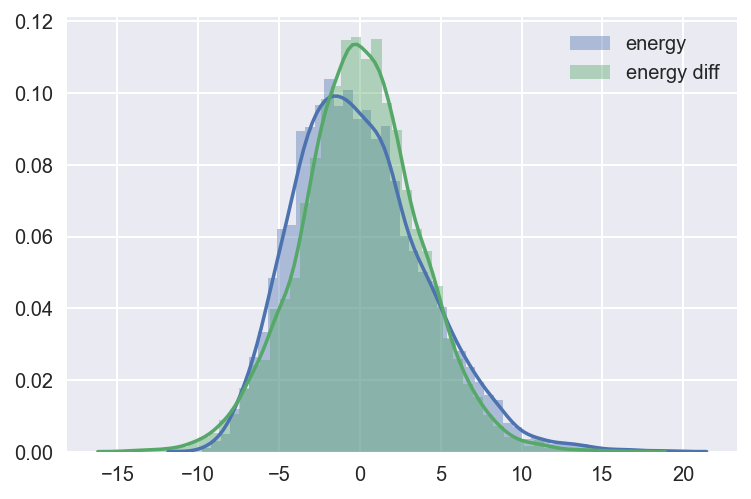

In [45]:
plot_samplerstat(burnin=0,trace=trace_anger)

Displaying Dynamic condition
Displaying Shuffled condition


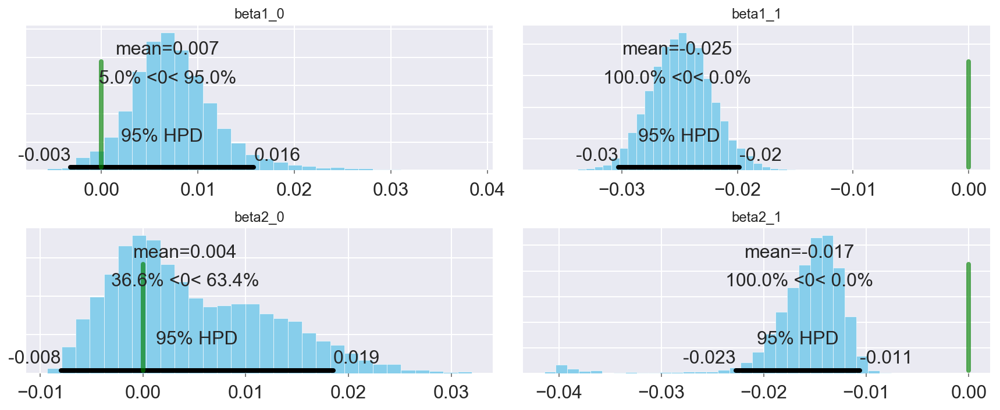

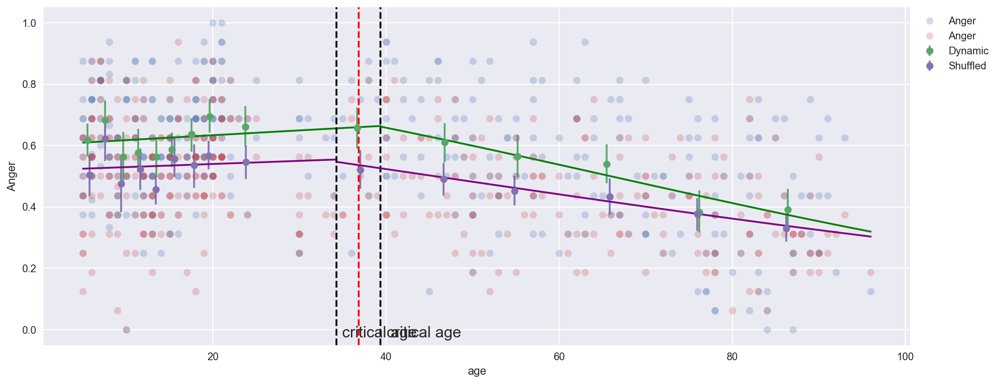

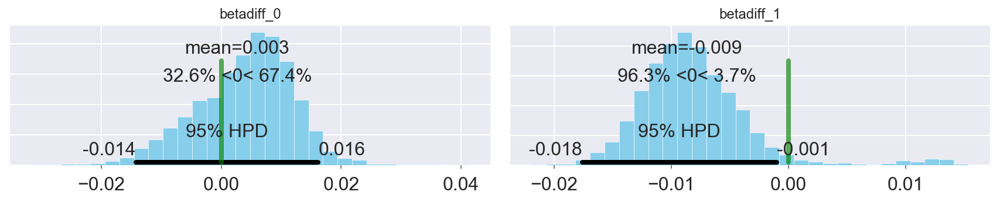

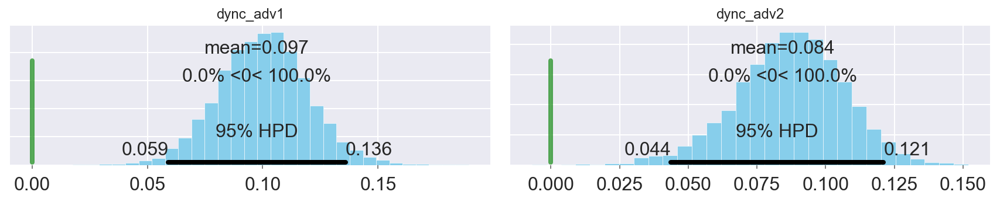

                  mean         sd  mc_error    hpd_2.5   hpd_97.5
tau          36.827558  10.143912  0.433646  16.043718  56.184379
tau1         39.390744   4.675515  0.215859  26.629730  47.773921
tau2         34.259343  12.036922  0.644057  16.967398  58.089360
beta1__0      0.006840   0.004749  0.000178  -0.003190   0.015779
beta1__1     -0.025199   0.002671  0.000067  -0.030265  -0.019799
beta2__0      0.004111   0.007598  0.000235  -0.007988   0.018504
beta2__1     -0.016514   0.004561  0.000343  -0.022706  -0.010604
betadiff__0   0.002729   0.007957  0.000161  -0.014266   0.016201
betadiff__1  -0.008685   0.004809  0.000297  -0.017610  -0.001021
dync_adv1     0.097350   0.019623  0.000507   0.059055   0.135965
dync_adv2     0.084430   0.019675  0.000704   0.043718   0.121078


In [46]:
plot_selectposterior(burnin=0,trace=trace_anger,task1 = 'Dynamic',task2 = 'Shuffled')

### Disgust 2

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,413.3:  87%|████████▋ | 173271/200000 [02:52<00:25, 1045.30it/s]
Convergence archived at 173300
Interrupted at 173,299 [86%]: Average Loss = 5,590.9
100%|██████████| 3000/3000 [00:46<00:00, 64.16it/s]


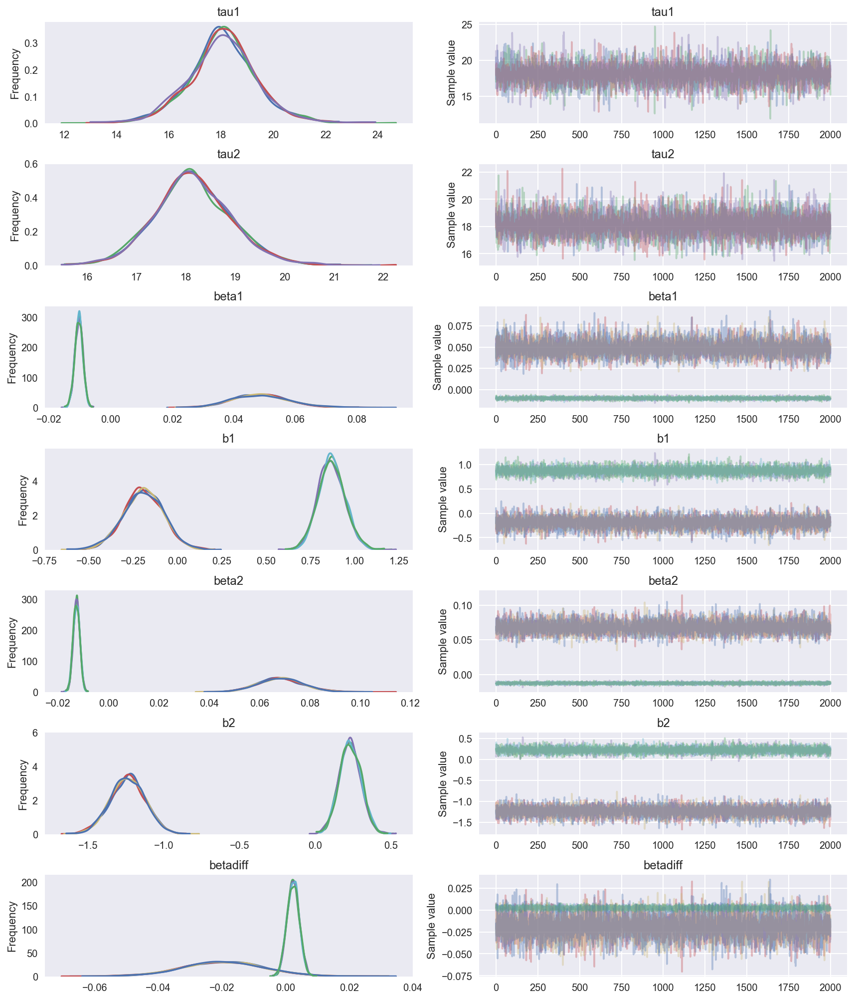

In [47]:
emolabel = 'Disgust'
trace_disgust = model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Shuffled')
pm.traceplot(trace_disgust,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82153
Diverge of the trace
(array([], dtype=int64),)


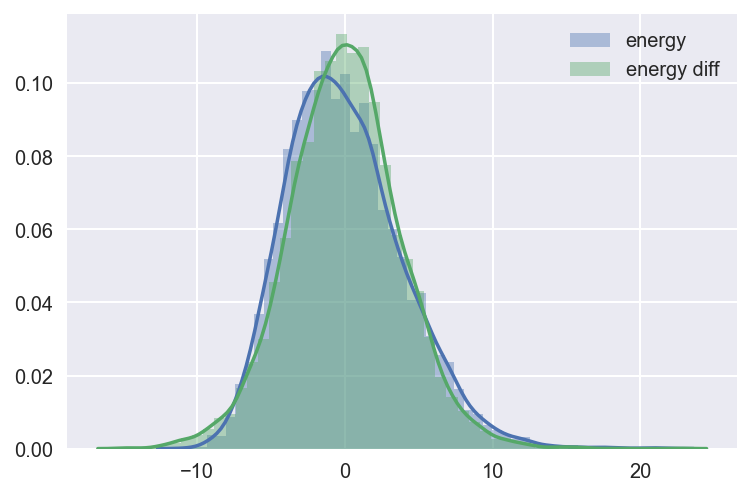

In [48]:
plot_samplerstat(burnin=0,trace=trace_disgust)

Displaying Dynamic condition
Displaying Shuffled condition


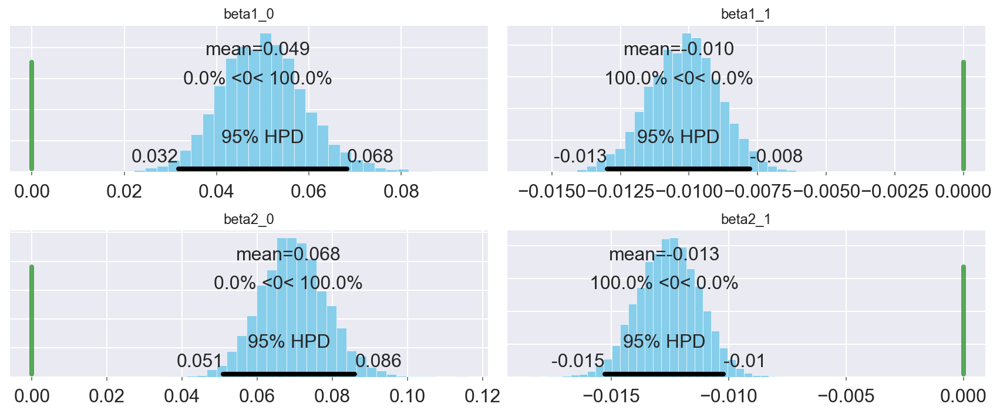

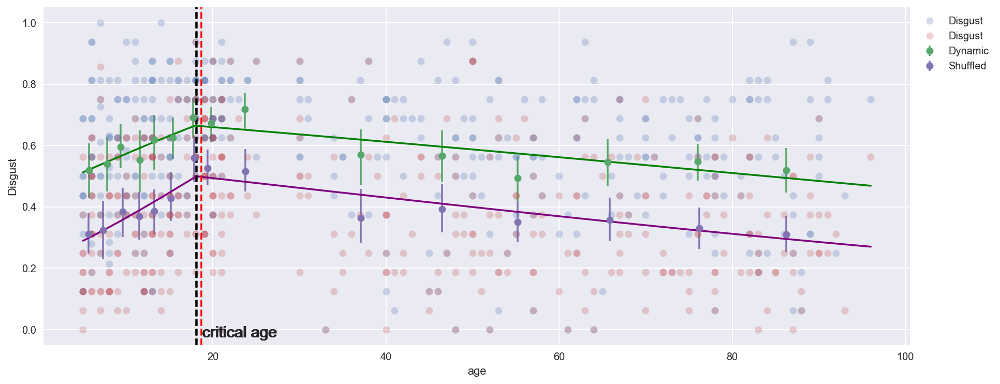

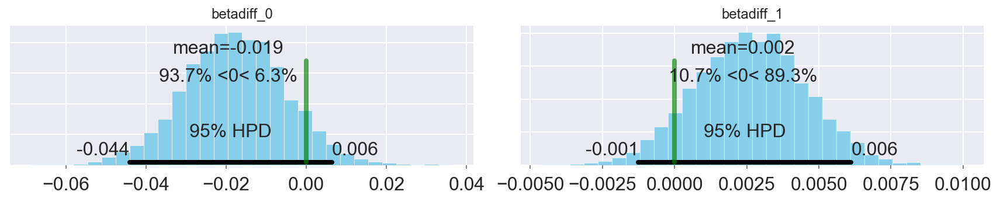

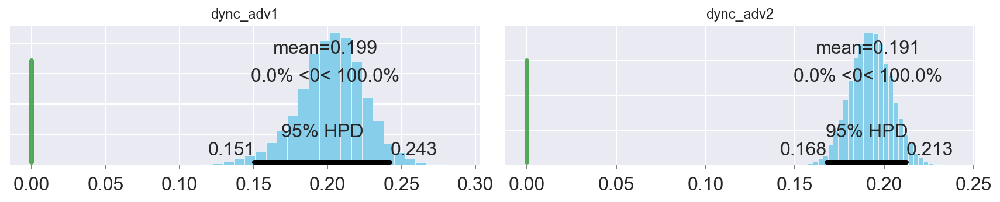

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          18.672266  6.675979  0.074069   5.999153  30.949335
tau1         18.058080  1.319404  0.014499  15.381585  20.783799
tau2         18.139816  0.786958  0.008223  16.622337  19.744018
beta1__0      0.048914  0.009334  0.000107   0.031757   0.068237
beta1__1     -0.010361  0.001317  0.000016  -0.012978  -0.007790
beta2__0      0.068385  0.008902  0.000101   0.050949   0.086033
beta2__1     -0.012736  0.001314  0.000016  -0.015289  -0.010214
betadiff__0  -0.019471  0.012835  0.000129  -0.044121   0.006359
betadiff__1   0.002375  0.001902  0.000022  -0.001252   0.006121
dync_adv1     0.198675  0.022927  0.000232   0.150767   0.242545
dync_adv2     0.191067  0.011441  0.000109   0.167931   0.212529


In [49]:
plot_selectposterior(burnin=0,trace=trace_disgust,task1 = 'Dynamic',task2 = 'Shuffled')

### Fear 2 

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,160.4:  71%|███████   | 141407/200000 [02:08<00:51, 1133.60it/s]
Convergence archived at 141500
Interrupted at 141,499 [70%]: Average Loss = 5,524.6
100%|██████████| 3000/3000 [00:54<00:00, 55.20it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 3 contains 4 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))


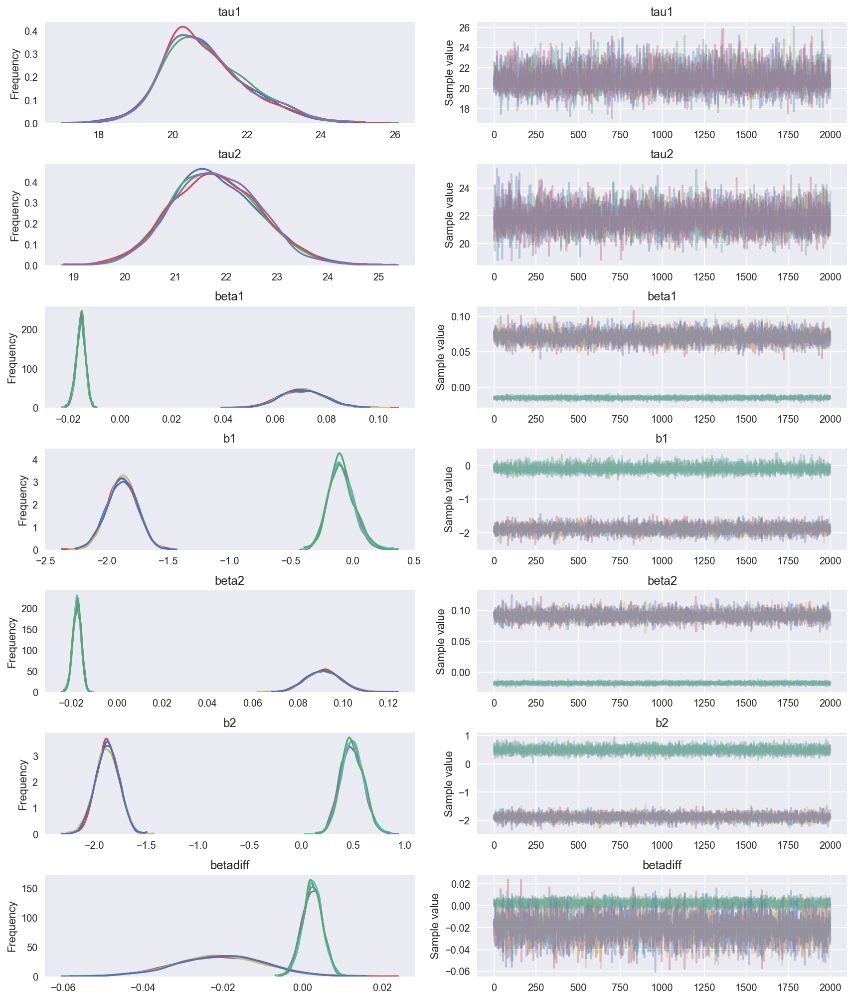

In [50]:
emolabel = 'Fear'
trace_fear = model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Shuffled')
pm.traceplot(trace_fear,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82304
Diverge of the trace
(array([7086, 7440, 7628, 7702]),)


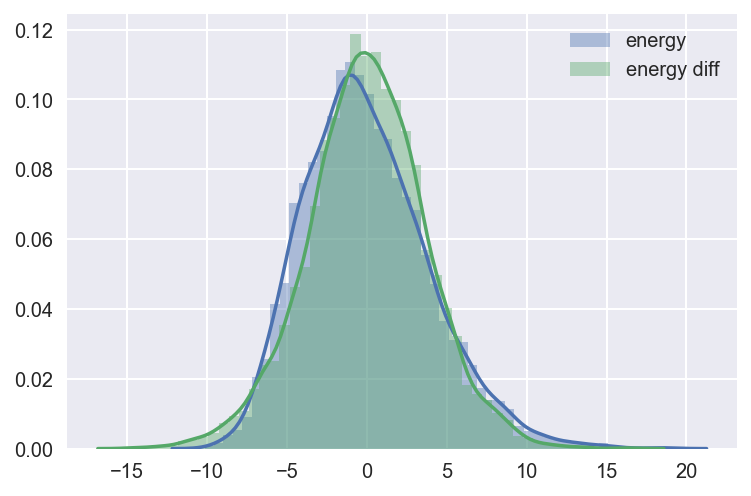

In [51]:
plot_samplerstat(burnin=0,trace=trace_fear)

Displaying Dynamic condition
Displaying Shuffled condition


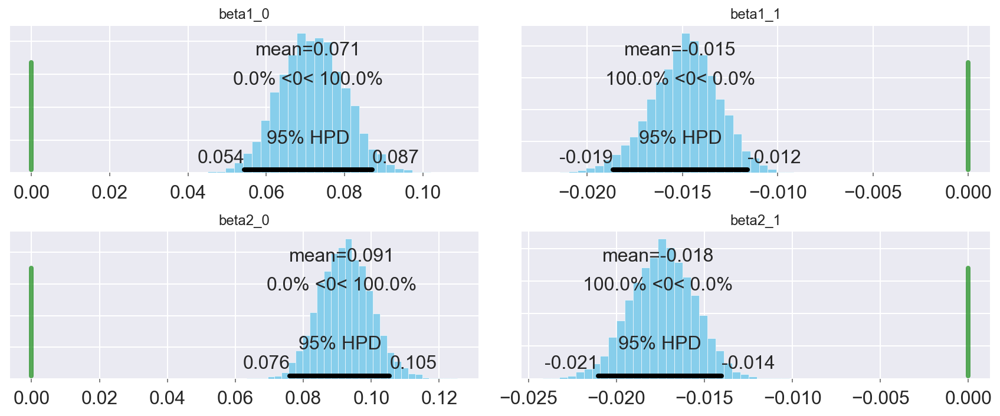

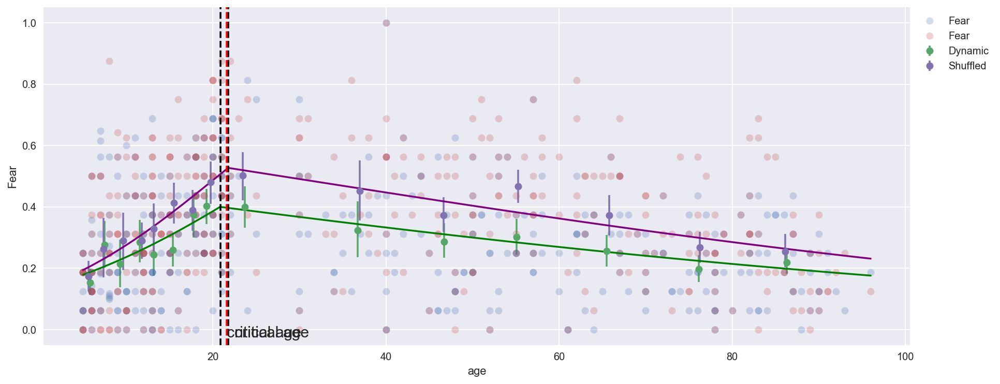

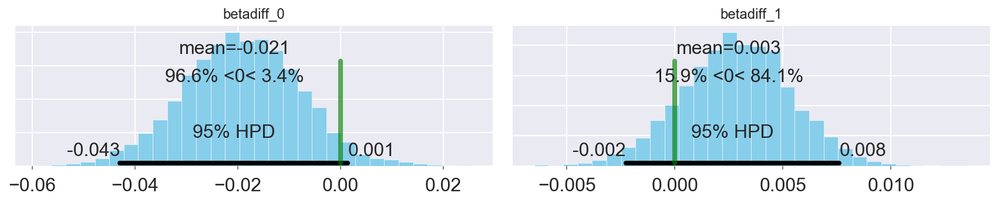

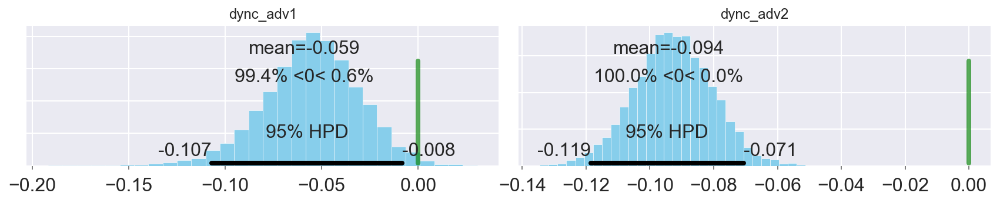

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          21.615467  6.872844  0.090133   8.012227  34.477299
tau1         20.888028  1.146749  0.015933  19.012108  23.465473
tau2         21.793716  0.867078  0.011874  20.192355  23.541013
beta1__0      0.070693  0.008401  0.000093   0.054388   0.087097
beta1__1     -0.015131  0.001790  0.000024  -0.018661  -0.011587
beta2__0      0.091313  0.007579  0.000075   0.076062   0.105386
beta2__1     -0.017637  0.001807  0.000026  -0.021051  -0.014033
betadiff__0  -0.020620  0.011274  0.000122  -0.042926   0.001431
betadiff__1   0.002506  0.002520  0.000033  -0.002257   0.007617
dync_adv1    -0.059140  0.025002  0.000307  -0.107032  -0.008167
dync_adv2    -0.094147  0.012234  0.000124  -0.118560  -0.070625


In [52]:
plot_selectposterior(burnin=0,trace=trace_fear,task1 = 'Dynamic',task2 = 'Shuffled')

### Happy 2
# !Warning! 
this model might need to reparameterized.

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 1,713:  18%|█▊        | 36699/200000 [00:33<02:28, 1102.64it/s]    
Convergence archived at 36700
Interrupted at 36,699 [18%]: Average Loss = 22,084
100%|█████████▉| 2995/3000 [02:01<00:00, 26.88it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 0 contains 78 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
100%|██████████| 3000/3000 [02:01<00:00, 24.63it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:451: UserWarning: The acceptance probability in chain 1 does not match the target. It is 0.667541931375, but should be close to 0.8. Try to increase the number of tuning steps.
  % (self._chain_id, mean_accept, target_accept))
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 288 diverging samples after

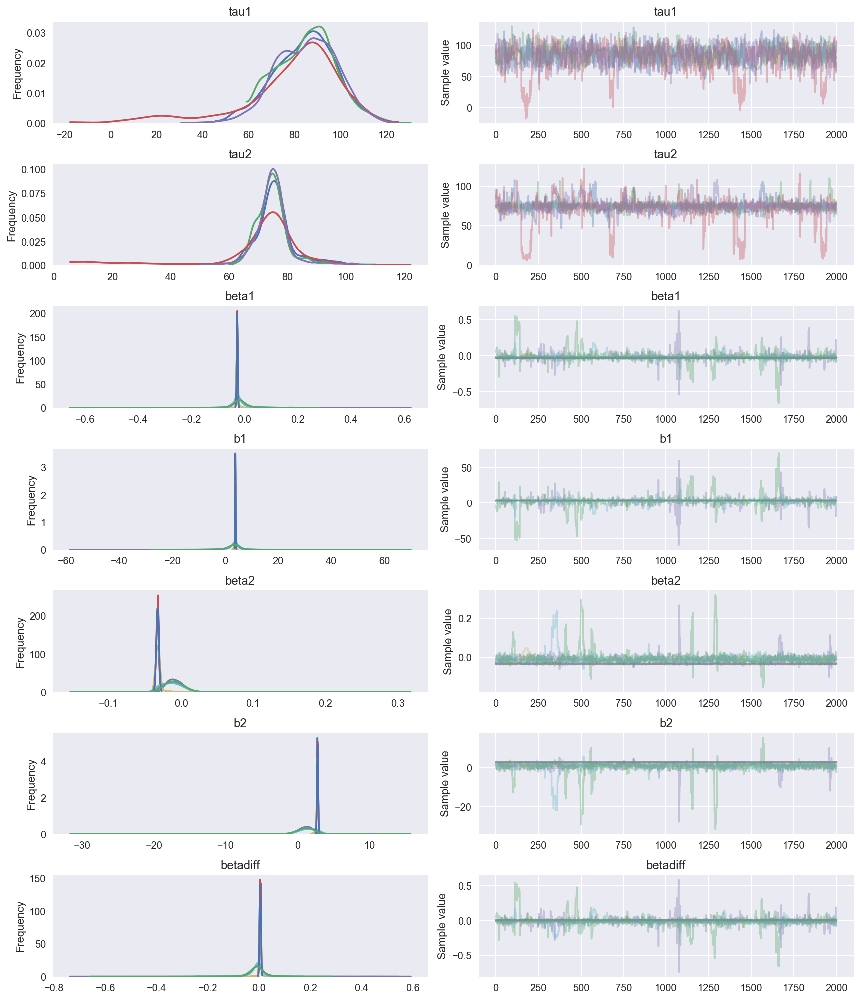

In [53]:
emolabel = 'Happy'
trace_happy = model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Shuffled')
pm.traceplot(trace_happy,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.74137
Diverge of the trace
(array([   2,    7,   10,   65,  226,  230,  231,  235,  266,  322,  327,
        342,  354,  355,  358,  385,  445,  517,  591,  613,  627,  658,
        707,  752,  793,  794,  808,  813,  900,  901,  902,  903,  961,
       1007, 1011, 1012, 1013, 1015, 1016, 1017, 1020, 1021, 1022, 1023,
       1024, 1025, 1027, 1028, 1029, 1030, 1032, 1035, 1036, 1039, 1051,
       1079, 1156, 1164, 1199, 1203, 1215, 1224, 1229, 1231, 1232, 1246,
       1282, 1298, 1318, 1348, 1415, 1416, 1503, 1736, 1737, 1739, 1866,
       1996, 2000, 2002, 2006, 2022, 2027, 2035, 2044, 2075, 2088, 2091,
       2112, 2113, 2126, 2128, 2131, 2132, 2133, 2136, 2137, 2148, 2158,
       2175, 2176, 2177, 2198, 2202, 2213, 2226, 2232, 2234, 2242, 2248,
       2260, 2290, 2357, 2360, 2431, 2448, 2455, 2456, 2475, 2479, 2502,
       2503, 2524, 2538, 2540, 2554, 2559, 2560, 2568, 2572, 2575, 2587,
       2588, 2589, 2593, 2594, 2595, 2596, 2597, 2598, 2599, 2601, 2602,
 

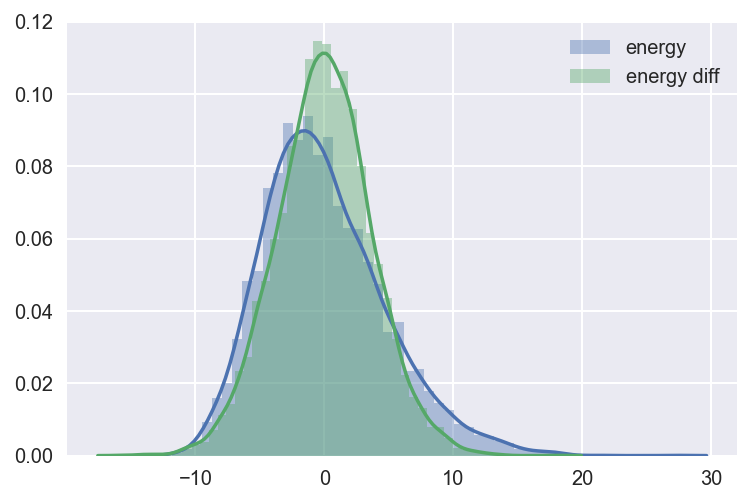

In [54]:
plot_samplerstat(burnin=0,trace=trace_happy)

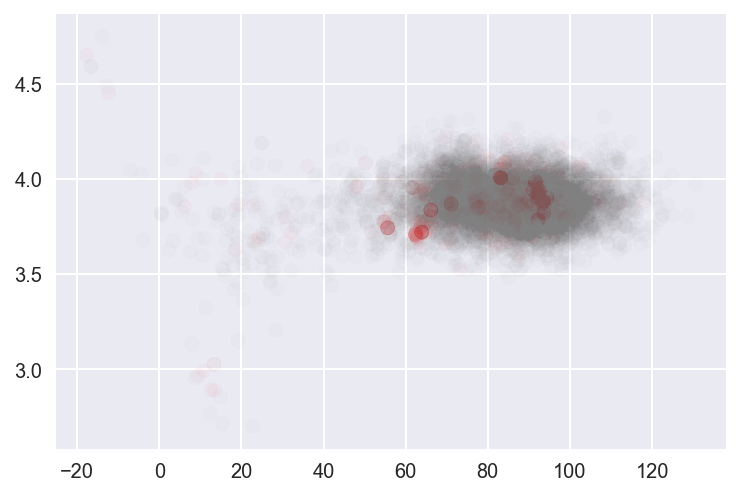

In [55]:
diverge = trace_happy.get_sampler_stats('diverging')
# trace_happy['beta1'].shape
colors = ['grey','red']
plt.scatter(trace_happy['tau1'],trace_happy['b1'][:,0],c=diverge.astype(int),alpha=.025,
            cmap=matplotlib.colors.ListedColormap(colors))
plt.show()

Displaying Dynamic condition
Displaying Shuffled condition


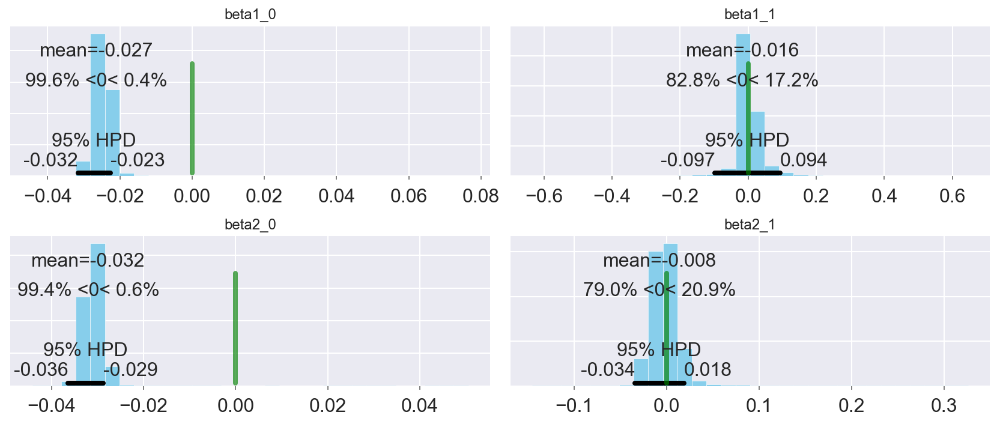

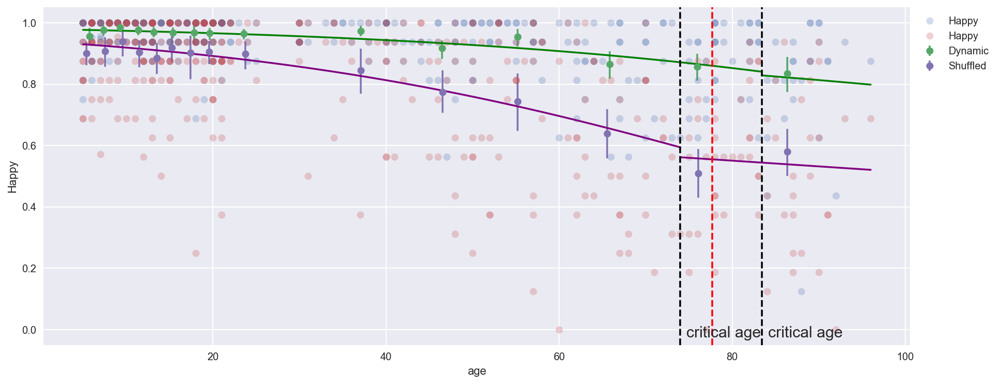

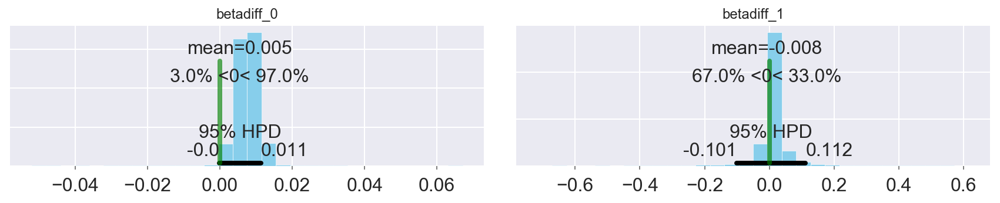

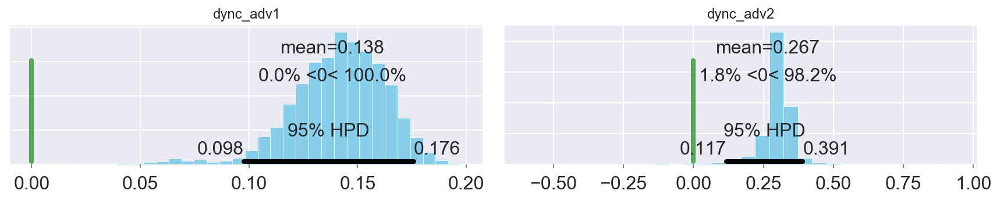

                  mean         sd  mc_error    hpd_2.5    hpd_97.5
tau          77.709018  12.942290  0.619522  58.116147   95.994350
tau1         83.429520  16.030659  0.739388  54.864744  112.156270
tau2         74.012579  10.672378  0.597513  60.891365   96.858450
beta1__0     -0.026524   0.004978  0.000285  -0.031629   -0.022622
beta1__1     -0.015794   0.059773  0.002550  -0.097471    0.093675
beta2__0     -0.031991   0.005613  0.000373  -0.036380   -0.028791
beta2__1     -0.007501   0.027673  0.001340  -0.034385    0.018452
betadiff__0   0.005468   0.004186  0.000113  -0.000214    0.011272
betadiff__1  -0.008294   0.063166  0.002629  -0.101428    0.111571
dync_adv1     0.138346   0.021672  0.000913   0.097662    0.175797
dync_adv2     0.266710   0.091274  0.002865   0.116857    0.390676


In [56]:
plot_selectposterior(burnin=0,trace=trace_happy,task1 = 'Dynamic',task2 = 'Shuffled')

### Sad 2

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,297.2:  17%|█▋        | 34817/200000 [00:31<02:27, 1116.75it/s]
Convergence archived at 34900
Interrupted at 34,899 [17%]: Average Loss = 18,267
100%|██████████| 3000/3000 [01:07<00:00, 55.99it/s]

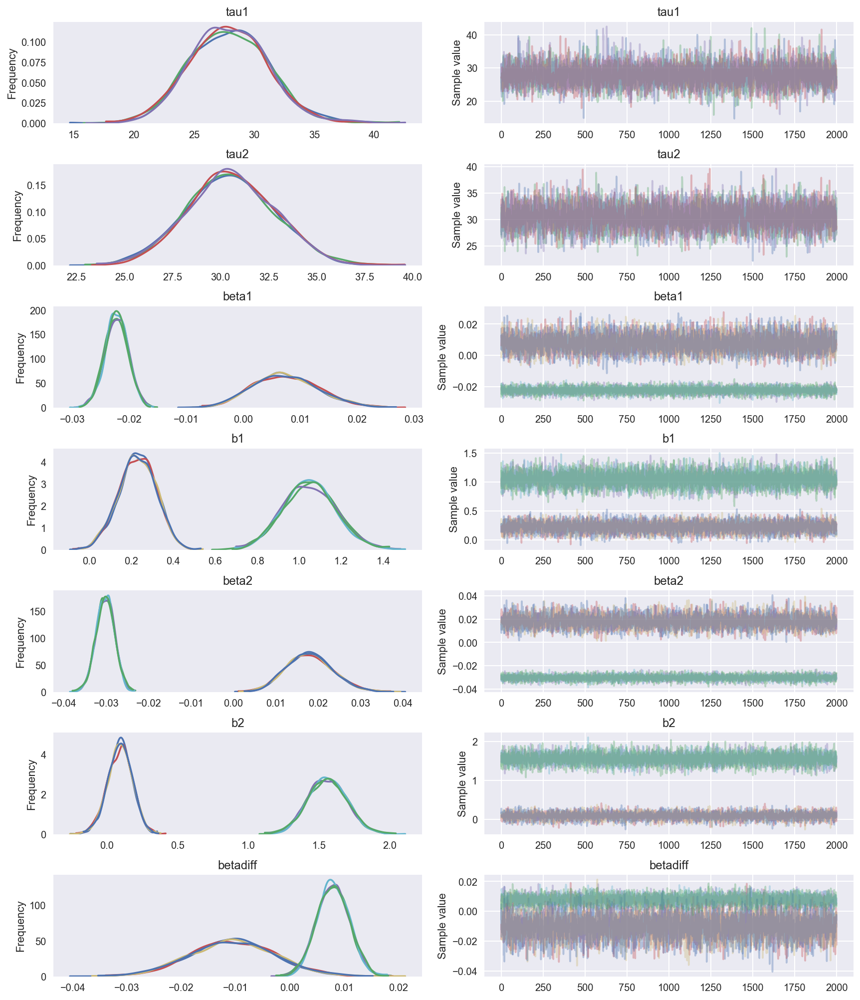

In [57]:
emolabel = 'Sad'
trace_sad = model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Shuffled')
pm.traceplot(trace_sad,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82986
Diverge of the trace
(array([], dtype=int64),)


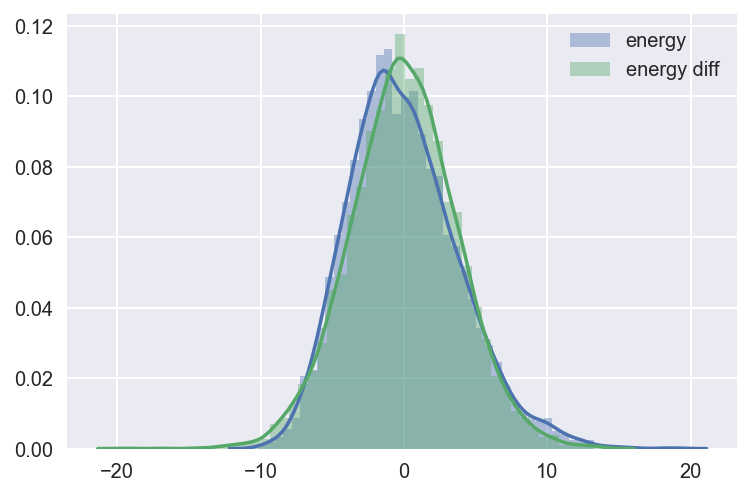

In [58]:
plot_samplerstat(burnin=0,trace=trace_sad)

Displaying Dynamic condition
Displaying Shuffled condition


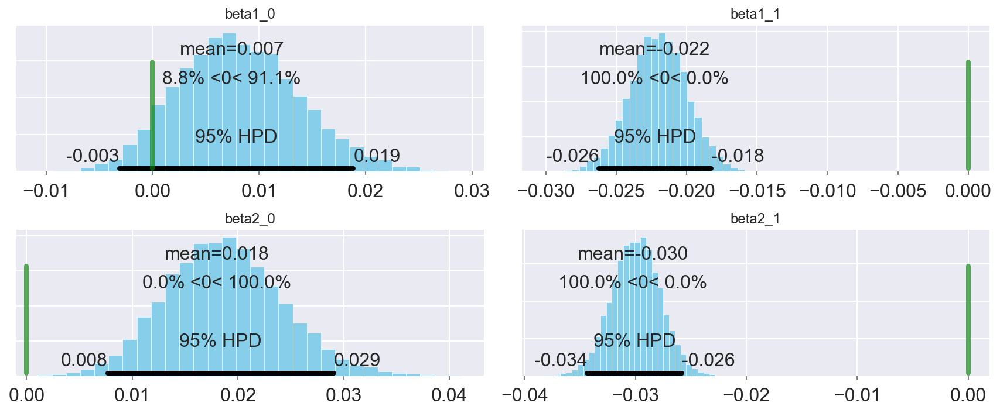

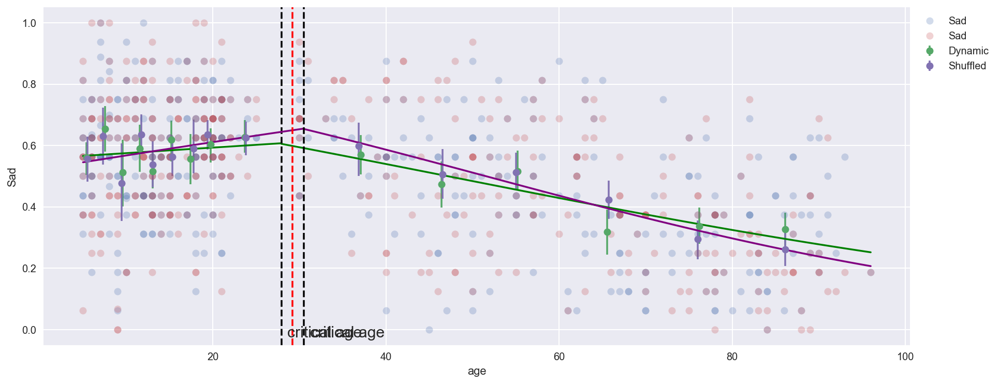

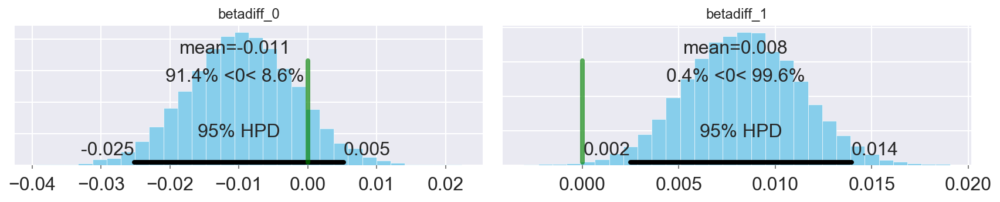

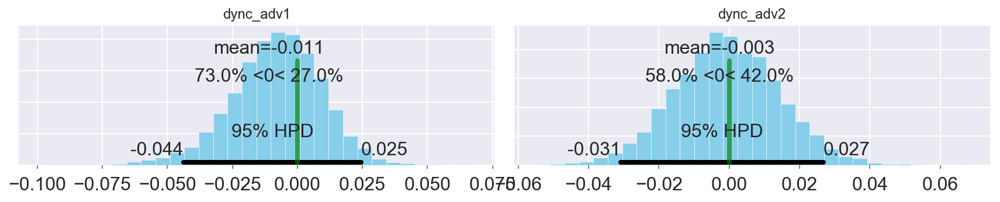

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          29.199363  7.356999  0.078989  14.989668  43.336275
tau1         27.919459  3.312310  0.043509  21.573297  34.351752
tau2         30.531442  2.296979  0.027765  26.102953  34.999158
beta1__0      0.007448  0.005698  0.000077  -0.003122   0.018853
beta1__1     -0.022264  0.002026  0.000022  -0.026227  -0.018260
beta2__0      0.018011  0.005506  0.000069   0.007653   0.029060
beta2__1     -0.030225  0.002179  0.000023  -0.034352  -0.025819
betadiff__0  -0.010563  0.007791  0.000098  -0.025212   0.005207
betadiff__1   0.007961  0.002960  0.000033   0.002486   0.013960
dync_adv1    -0.010808  0.017370  0.000211  -0.043796   0.024509
dync_adv2    -0.002716  0.014830  0.000174  -0.030939   0.026753


In [59]:
plot_selectposterior(burnin=0,trace=trace_sad,task1 = 'Dynamic',task2 = 'Shuffled')

### Surprise 2

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,337.3:  73%|███████▎  | 145717/200000 [02:05<00:46, 1169.44it/s]
Convergence archived at 145800
Interrupted at 145,799 [72%]: Average Loss = 6,277.5
100%|██████████| 3000/3000 [00:52<00:00, 56.72it/s]


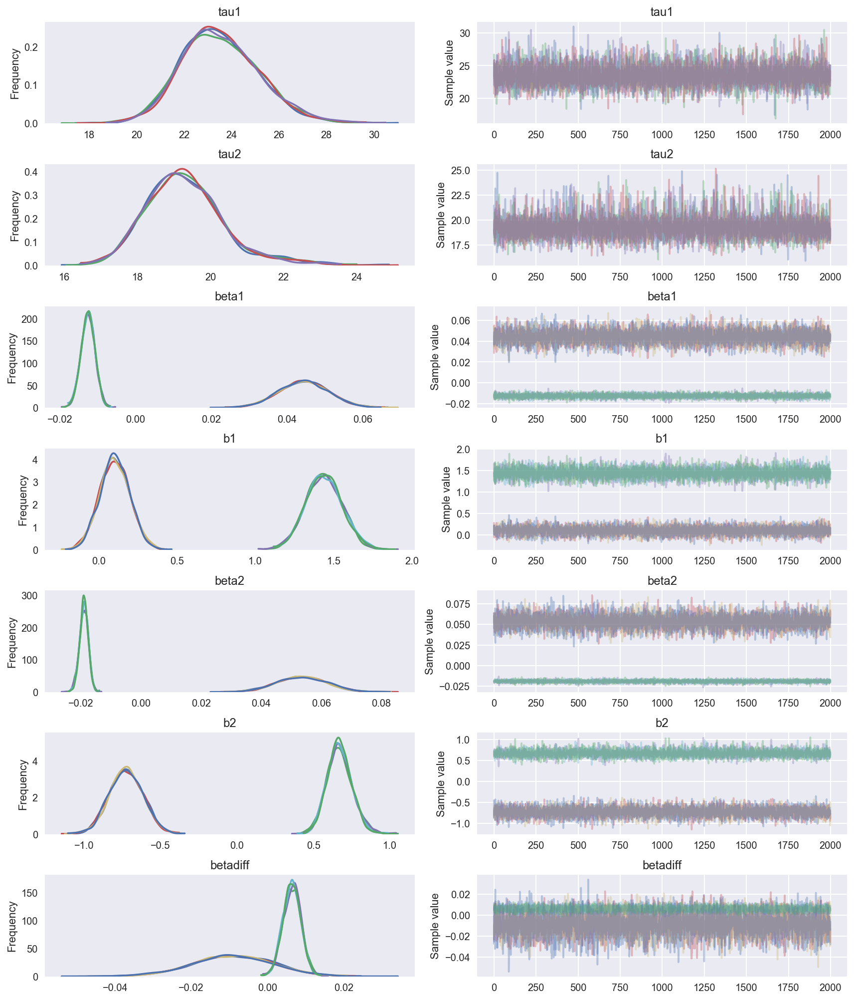

In [60]:
emolabel = 'Surprise'
trace_surprise = model3_diff(emolabel,task1 = 'Dynamic',task2 = 'Shuffled')
pm.traceplot(trace_surprise,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.83130
Diverge of the trace
(array([], dtype=int64),)


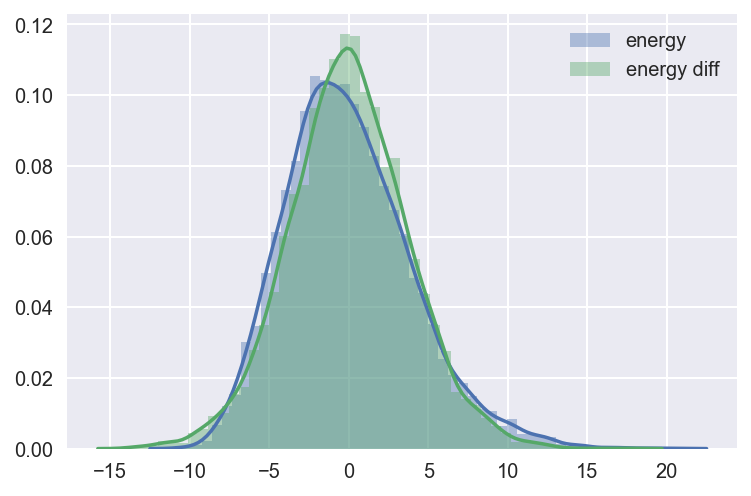

In [61]:
plot_samplerstat(burnin=0,trace=trace_surprise)

Displaying Dynamic condition
Displaying Shuffled condition


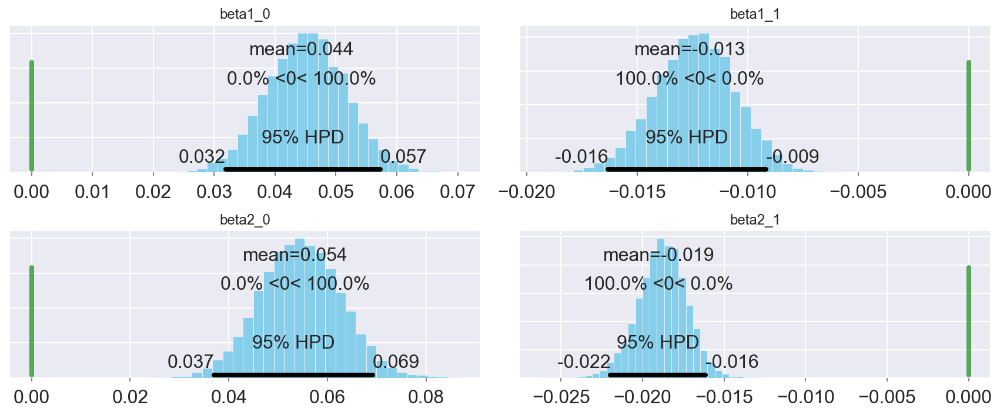

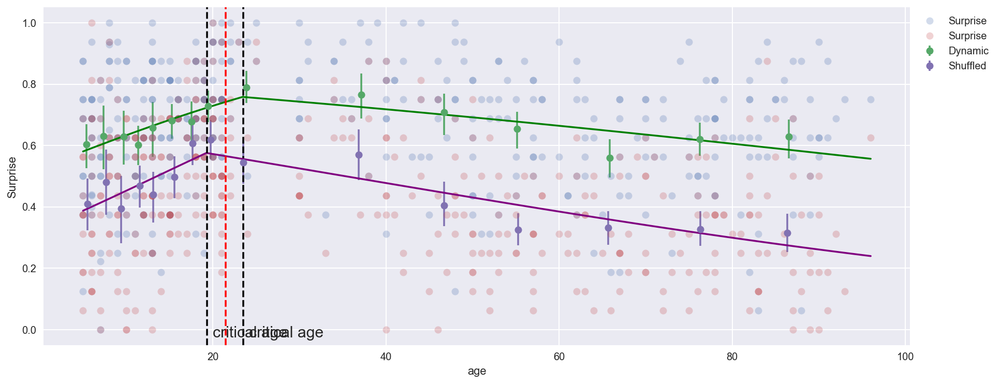

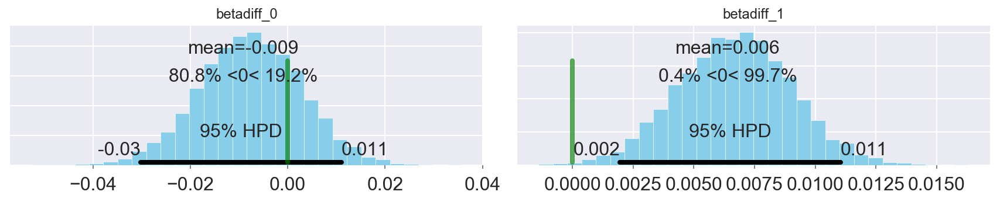

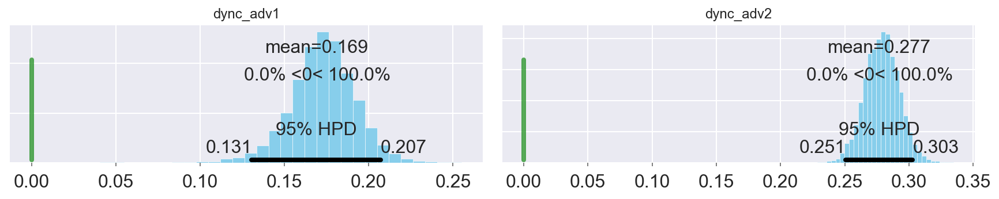

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          21.509742  6.997316  0.080519   7.762813  34.679736
tau1         23.504108  1.641713  0.016396  20.448231  26.778508
tau2         19.315732  1.102825  0.015416  17.135525  21.542583
beta1__0      0.044381  0.006531  0.000080   0.031851   0.057272
beta1__1     -0.012614  0.001836  0.000023  -0.016318  -0.009170
beta2__0      0.053503  0.008218  0.000100   0.037045   0.069155
beta2__1     -0.019015  0.001480  0.000018  -0.021974  -0.016152
betadiff__0  -0.009122  0.010455  0.000134  -0.030192   0.011043
betadiff__1   0.006400  0.002348  0.000029   0.001959   0.011048
dync_adv1     0.169393  0.019145  0.000201   0.130646   0.207030
dync_adv2     0.277038  0.013263  0.000153   0.250525   0.302862


In [62]:
plot_selectposterior(burnin=0,trace=trace_surprise,task1 = 'Dynamic',task2 = 'Shuffled')

# Shuffled vs Static

### Anger 3

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,047.8:  21%|██        | 42073/200000 [00:37<02:21, 1118.18it/s]
Convergence archived at 42100
Interrupted at 42,099 [21%]: Average Loss = 15,569
 99%|█████████▉| 2970/3000 [01:35<00:00, 34.82it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 4 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
100%|█████████▉| 2998/3000 [01:36<00:00, 31.70it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 0 contains 8 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
100%|██████████| 3000/3000 [01:36<00:00, 31.10it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 2 contains 7 diverging samples after tuning. I

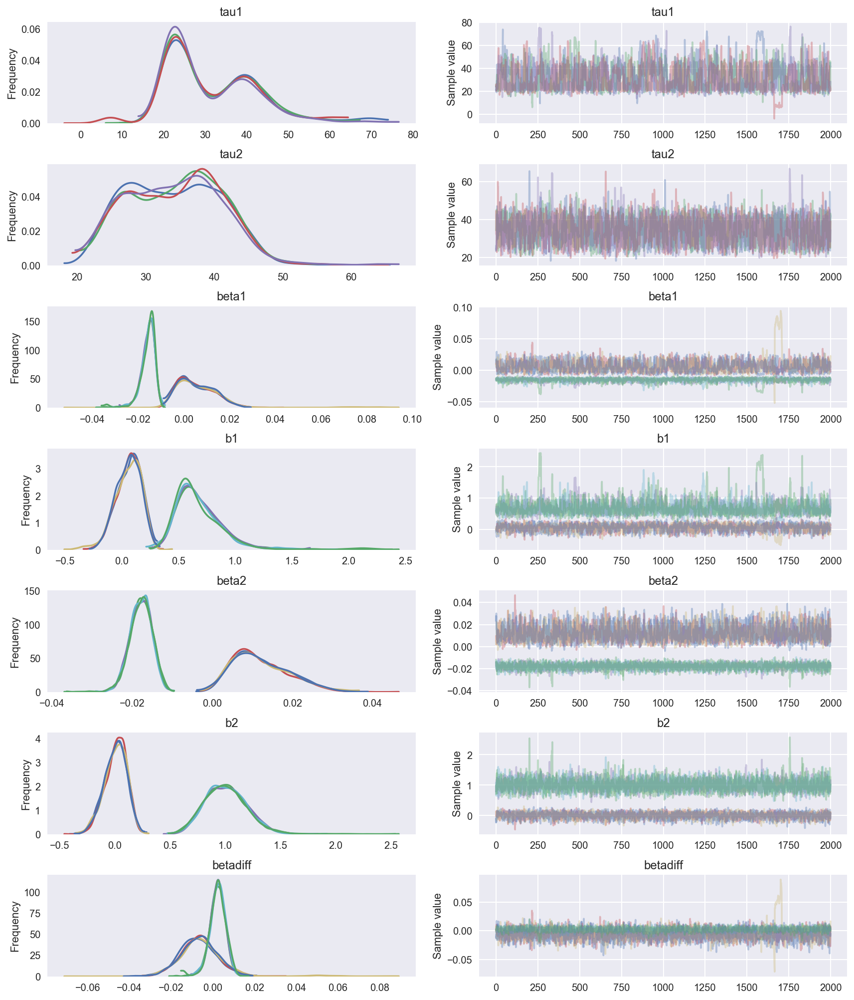

In [63]:
emolabel = 'Anger'
trace_anger = model3_diff(emolabel,task1 = 'Shuffled',task2 = 'Static')
pm.traceplot(trace_anger,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.80383
Diverge of the trace
(array([ 737, 1391, 1574, 1575, 1576, 1579, 1587, 1593, 2471, 2484, 2496,
       3339, 4383, 4939, 4941, 4943, 4944, 5244, 5680]),)


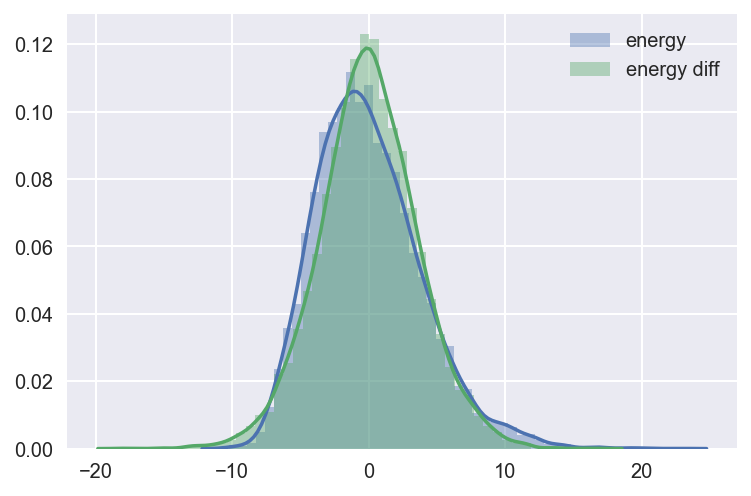

In [64]:
plot_samplerstat(burnin=0,trace=trace_anger)

Displaying Shuffled condition
Displaying Static condition


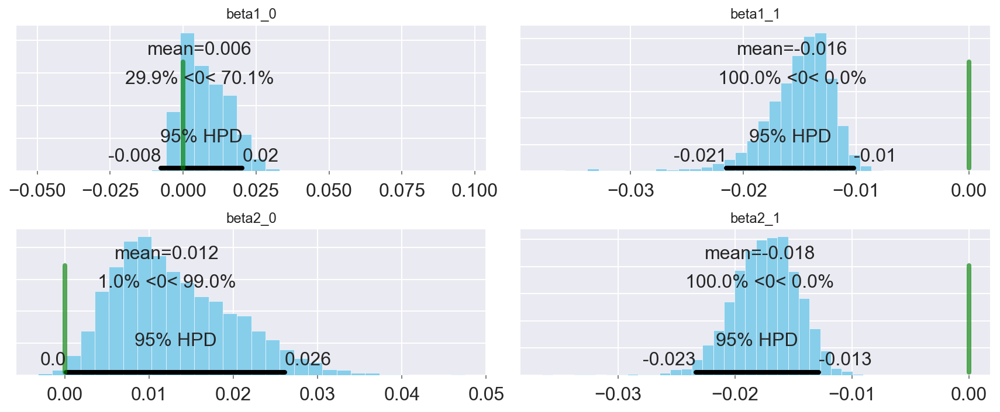

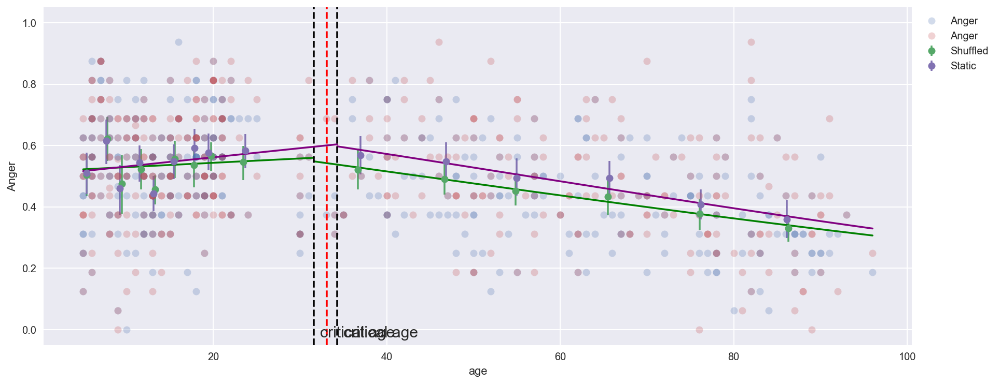

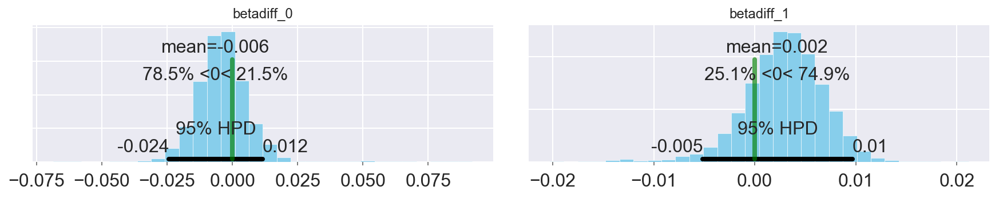

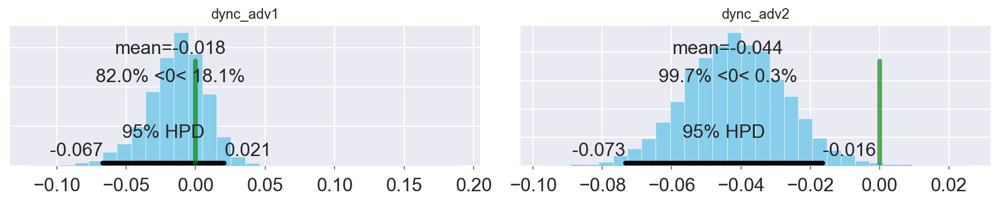

                  mean         sd  mc_error    hpd_2.5   hpd_97.5
tau          33.064006  10.329436  0.288982  13.847157  54.265551
tau1         31.591449  11.025370  0.408486  16.813316  53.716151
tau2         34.302271   6.888959  0.168650  22.336090  46.067604
beta1__0      0.005700   0.009423  0.000359  -0.007628   0.020265
beta1__1     -0.015666   0.003249  0.000128  -0.021499  -0.010189
beta2__0      0.012128   0.007048  0.000161   0.000191   0.026072
beta2__1     -0.017894   0.002779  0.000049  -0.023363  -0.012854
betadiff__0  -0.006428   0.009969  0.000305  -0.024271   0.011597
betadiff__1   0.002228   0.003877  0.000113  -0.005146   0.009658
dync_adv1    -0.018233   0.023383  0.000753  -0.066754   0.020612
dync_adv2    -0.043798   0.014532  0.000224  -0.073336  -0.016444


In [65]:
plot_selectposterior(burnin=0,trace=trace_anger,task1 = 'Shuffled',task2 = 'Static')

### Disgust 3

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,354:  74%|███████▍  | 148960/200000 [02:30<00:46, 1086.37it/s]  
Convergence archived at 149000
Interrupted at 148,999 [74%]: Average Loss = 6,118.1
100%|██████████| 3000/3000 [01:04<00:00, 46.46it/s]


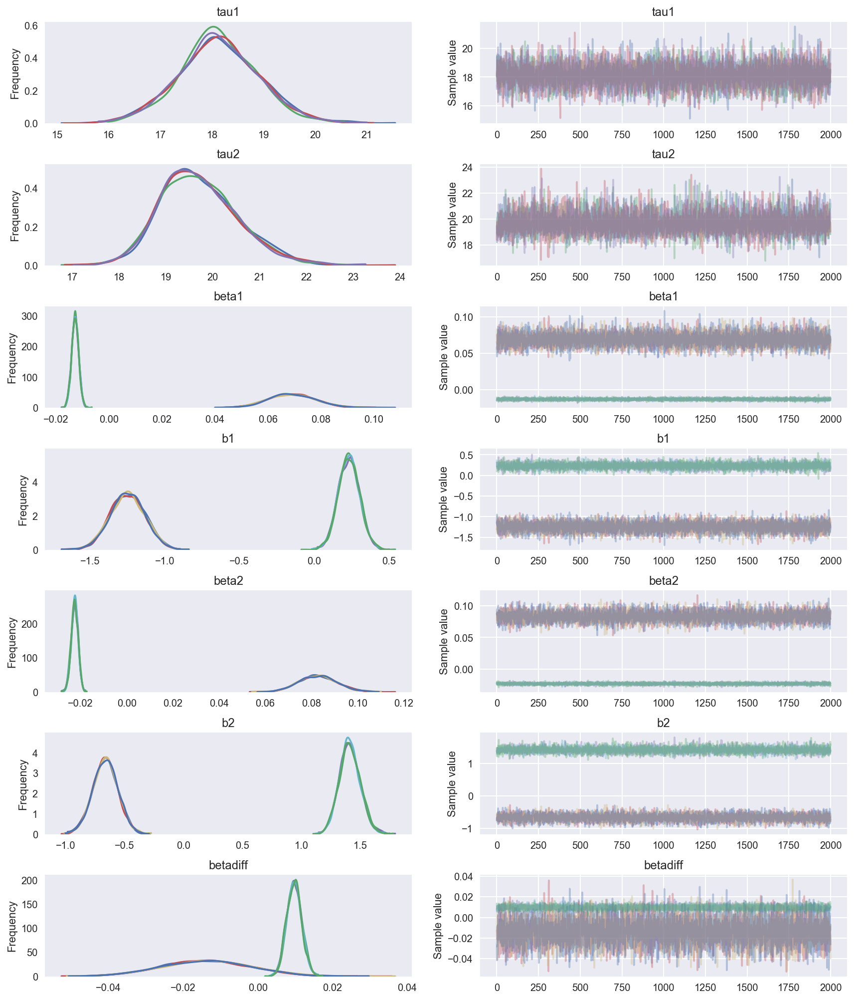

In [66]:
emolabel = 'Disgust'
trace_disgust = model3_diff(emolabel,task1 = 'Shuffled',task2 = 'Static')
pm.traceplot(trace_disgust,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82218
Diverge of the trace
(array([], dtype=int64),)


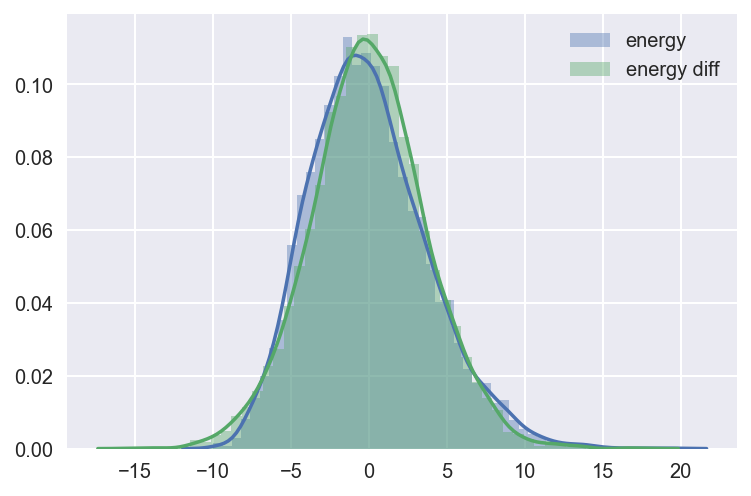

In [67]:
plot_samplerstat(burnin=0,trace=trace_disgust)

Displaying Shuffled condition
Displaying Static condition


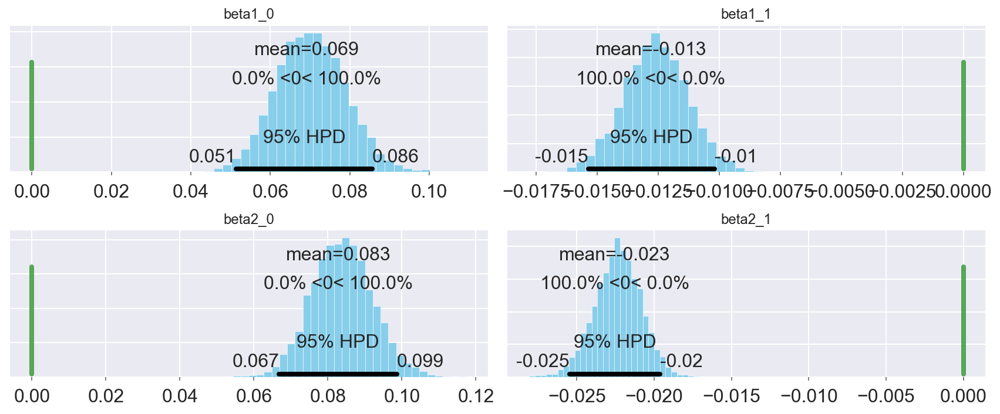

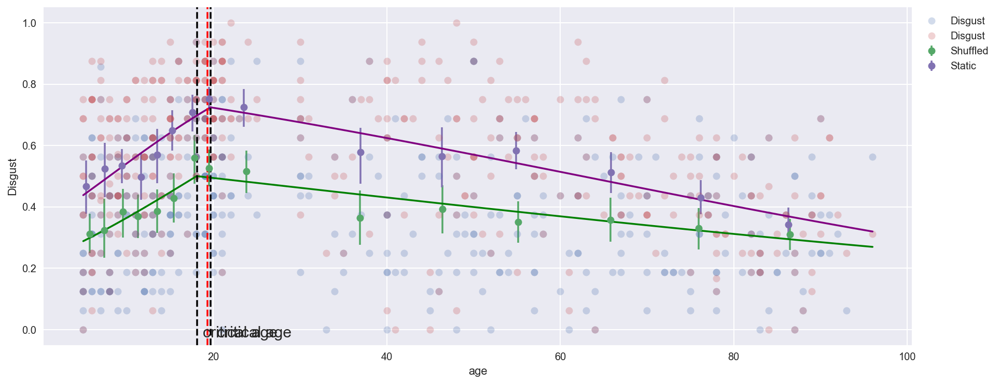

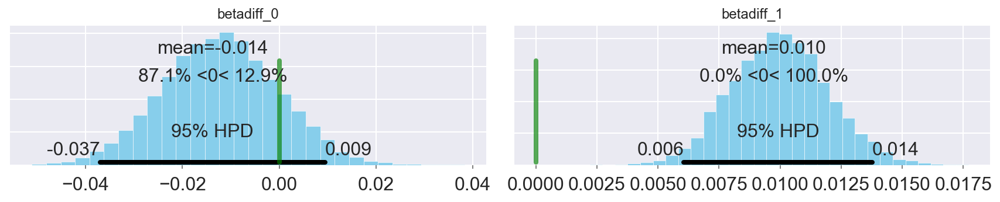

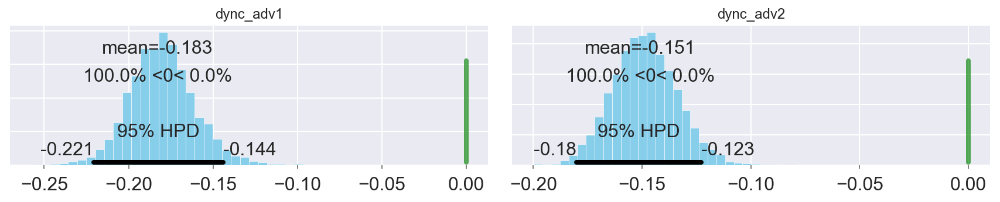

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          19.323794  6.614247  0.086497   6.327670  31.289249
tau1         18.119114  0.776070  0.007808  16.524962  19.614287
tau2         19.707775  0.835793  0.010914  18.139234  21.389284
beta1__0      0.069155  0.008812  0.000094   0.051381   0.085669
beta1__1     -0.012799  0.001316  0.000016  -0.015364  -0.010197
beta2__0      0.082787  0.008148  0.000092   0.066831   0.098621
beta2__1     -0.022554  0.001496  0.000019  -0.025483  -0.019609
betadiff__0  -0.013632  0.011961  0.000126  -0.037003   0.009444
betadiff__1   0.009755  0.001984  0.000024   0.006059   0.013766
dync_adv1    -0.182838  0.019176  0.000241  -0.220635  -0.143981
dync_adv2    -0.150907  0.014665  0.000177  -0.180309  -0.122908


In [68]:
plot_selectposterior(burnin=0,trace=trace_disgust,task1 = 'Shuffled',task2 = 'Static')

### Fear 3 

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,207:  71%|███████   | 142340/200000 [02:09<00:51, 1126.48it/s]  
Convergence archived at 142400
Interrupted at 142,399 [71%]: Average Loss = 5,587.1
100%|██████████| 3000/3000 [01:00<00:00, 56.12it/s]
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 3 contains 9 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))


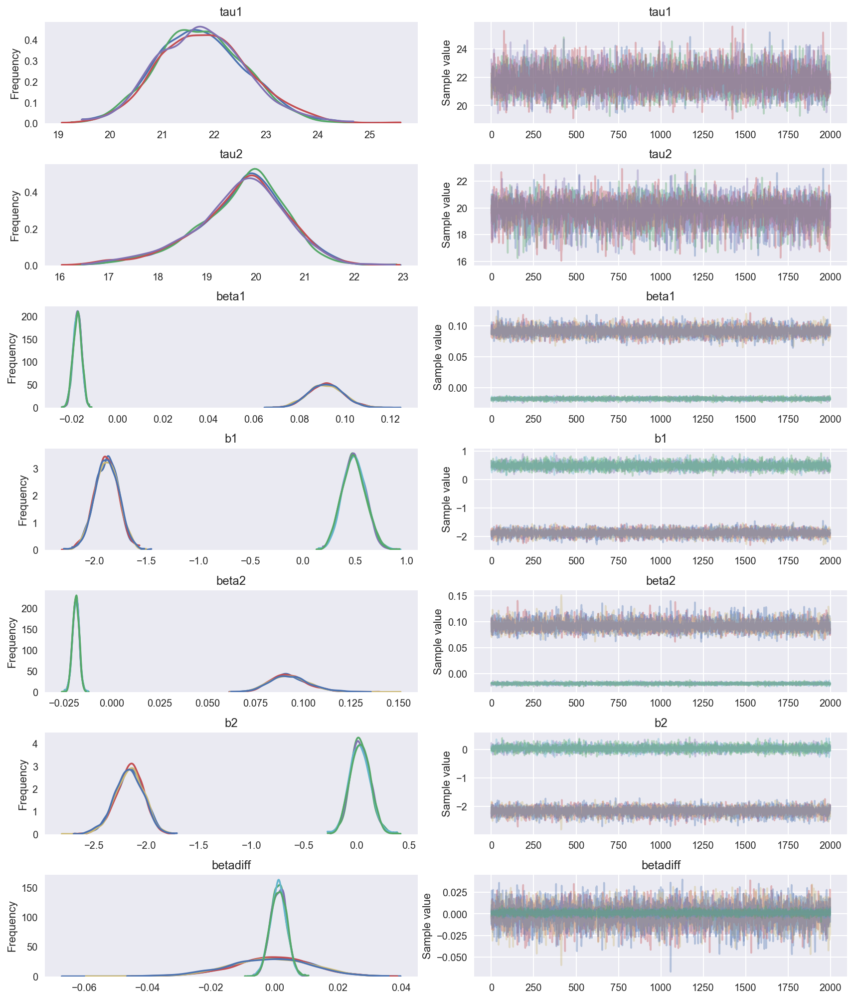

In [69]:
emolabel = 'Fear'
trace_fear = model3_diff(emolabel,task1 = 'Shuffled',task2 = 'Static')
pm.traceplot(trace_fear,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.79442
Diverge of the trace
(array([6063, 6134, 6610, 7060, 7486, 7487, 7650, 7708, 7954]),)


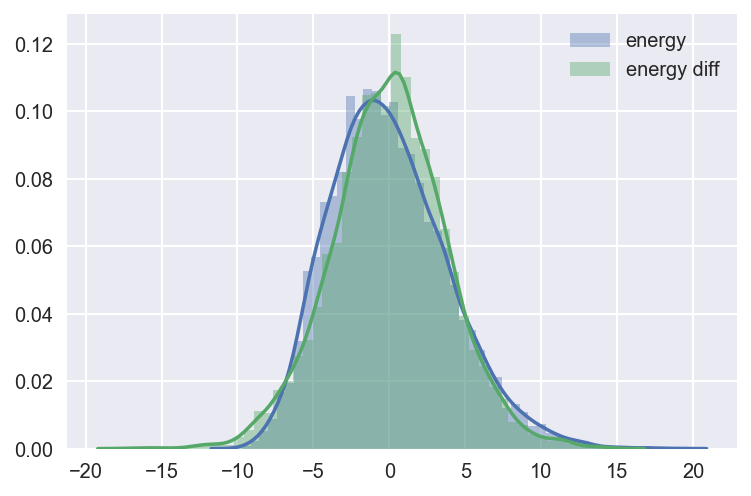

In [70]:
plot_samplerstat(burnin=0,trace=trace_fear)

Displaying Shuffled condition
Displaying Static condition


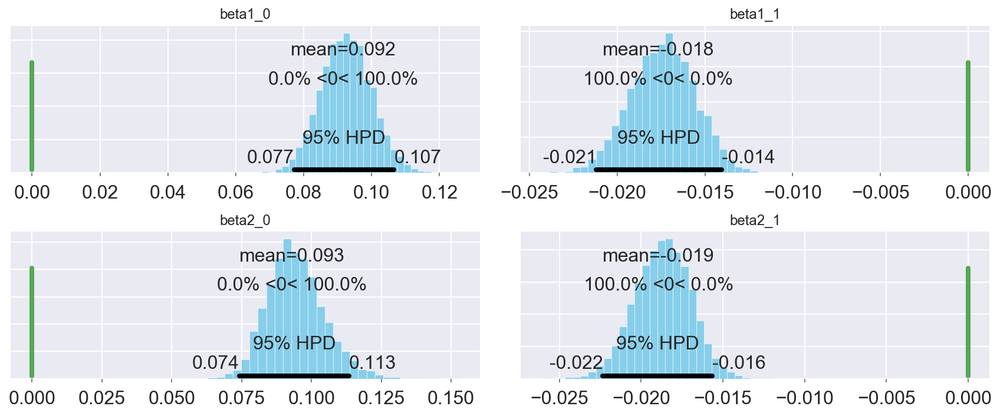

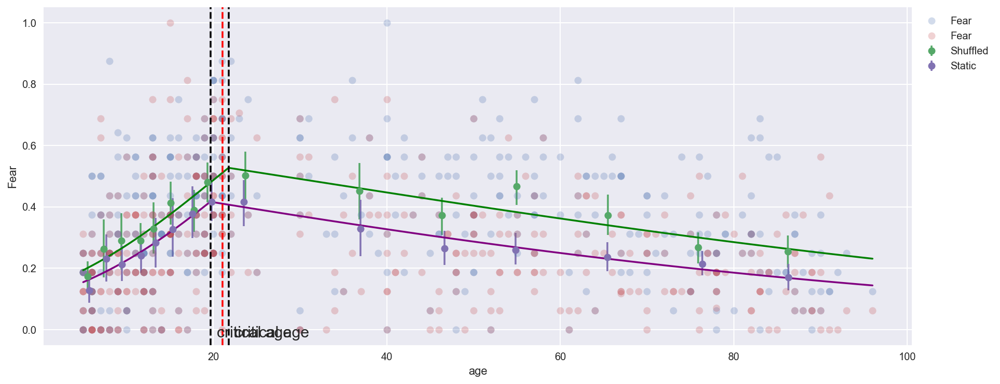

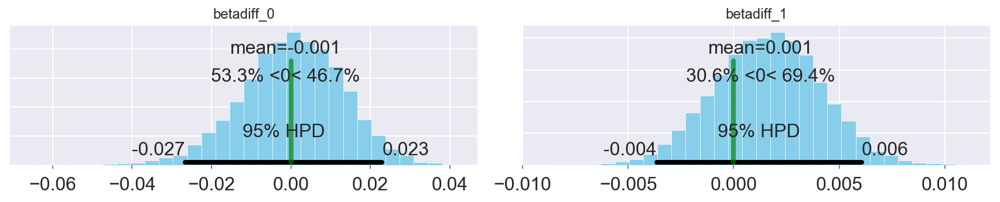

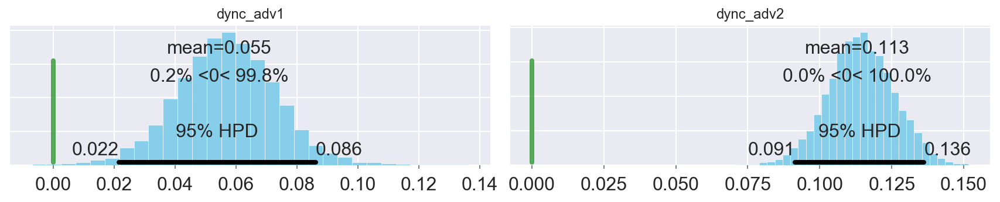

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          21.060235  6.852092  0.084158   8.521508  34.864674
tau1         21.777432  0.863970  0.009967  20.158987  23.519608
tau2         19.701254  0.934650  0.012979  17.676202  21.427896
beta1__0      0.091627  0.007486  0.000092   0.077242   0.106629
beta1__1     -0.017652  0.001843  0.000023  -0.021192  -0.014054
beta2__0      0.092988  0.010185  0.000140   0.074233   0.113412
beta2__1     -0.018938  0.001709  0.000022  -0.022343  -0.015660
betadiff__0  -0.001362  0.012684  0.000176  -0.026675   0.022967
betadiff__1   0.001286  0.002522  0.000035  -0.003650   0.006062
dync_adv1     0.054614  0.016369  0.000190   0.021581   0.086192
dync_adv2     0.113047  0.011434  0.000123   0.091332   0.136247


In [71]:
plot_selectposterior(burnin=0,trace=trace_fear,task1 = 'Shuffled',task2 = 'Static')

### Happy 3

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 1,961.8:  18%|█▊        | 36824/200000 [00:34<02:22, 1143.18it/s]  
Convergence archived at 36900
Interrupted at 36,899 [18%]: Average Loss = 21,932
100%|██████████| 3000/3000 [02:00<00:00, 29.08it/s]/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 0 contains 9 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))

/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 1 contains 4 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging))
/Users/jlao/Documents/Github/pymc3/pymc3/step_methods/hmc/nuts.py:467: UserWarning: Chain 2 contains 19 diverging samples after tuning. If increasing `target_accept` does not help try to reparameterize.
  % (self._chain_id, n_diverging)

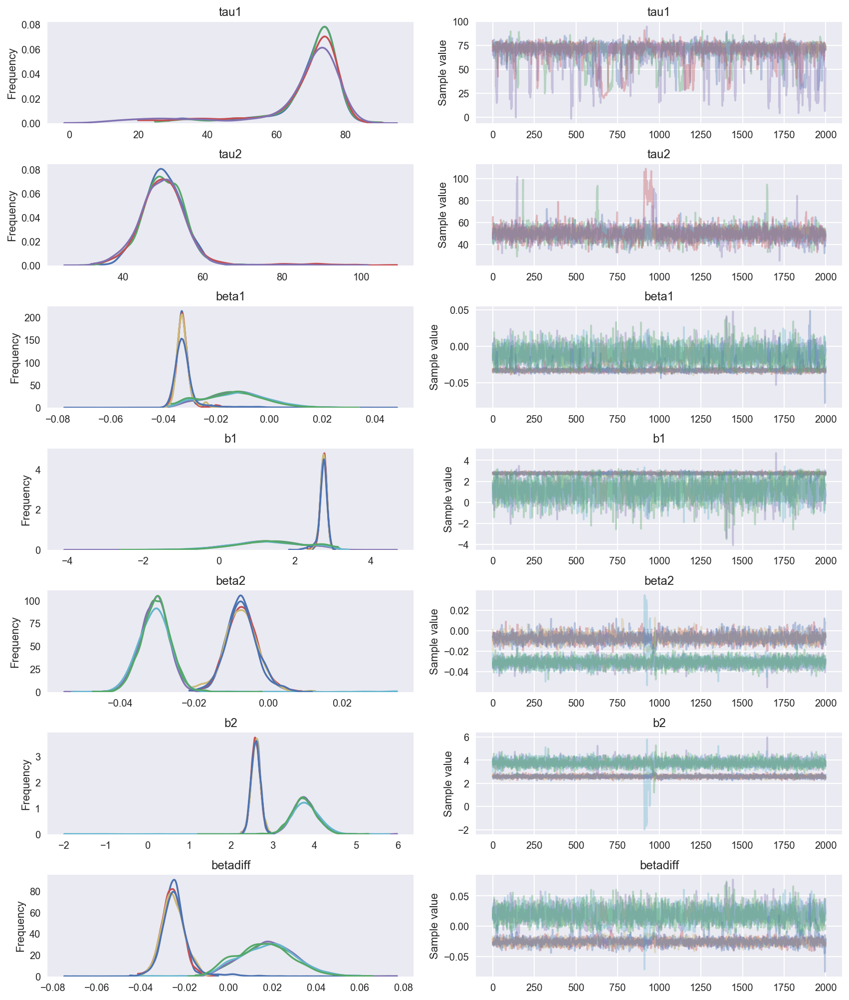

In [81]:
emolabel = 'Happy'
trace_happy = model3_diff(emolabel,task1 = 'Shuffled',task2 = 'Static')
pm.traceplot(trace_happy,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.78583
Diverge of the trace
(array([ 756, 1101, 1102, 1846, 1847, 1856, 1863, 1960, 1961, 2151, 2696,
       2711, 3260, 4622, 4656, 4657, 4658, 4659, 4660, 4668, 4669, 4670,
       4671, 4672, 4677, 4678, 4680, 4803, 5203, 5697, 5824, 5826, 6826,
       7905]),)


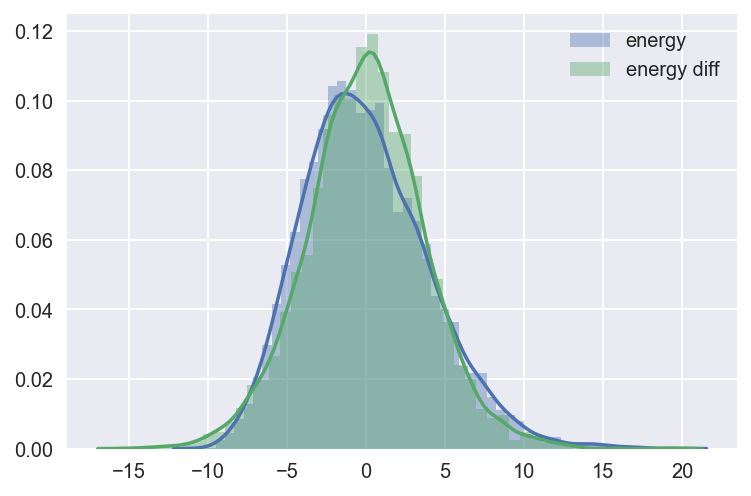

In [82]:
plot_samplerstat(burnin=0,trace=trace_happy)

Displaying Shuffled condition
Displaying Static condition


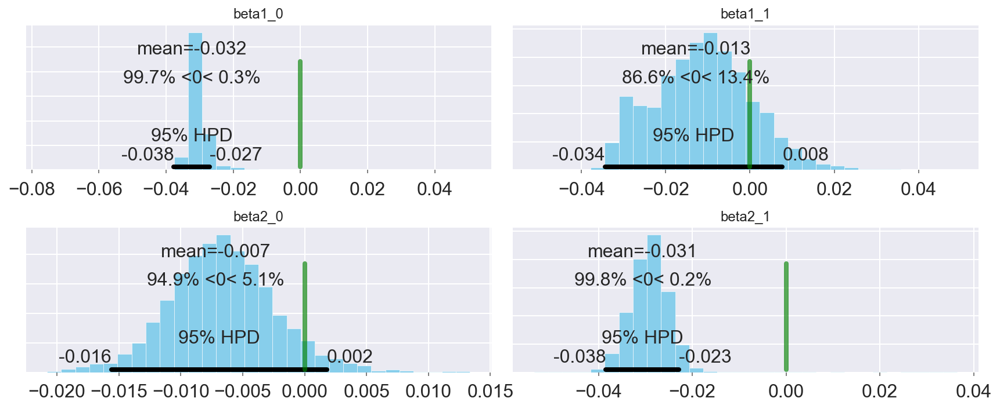

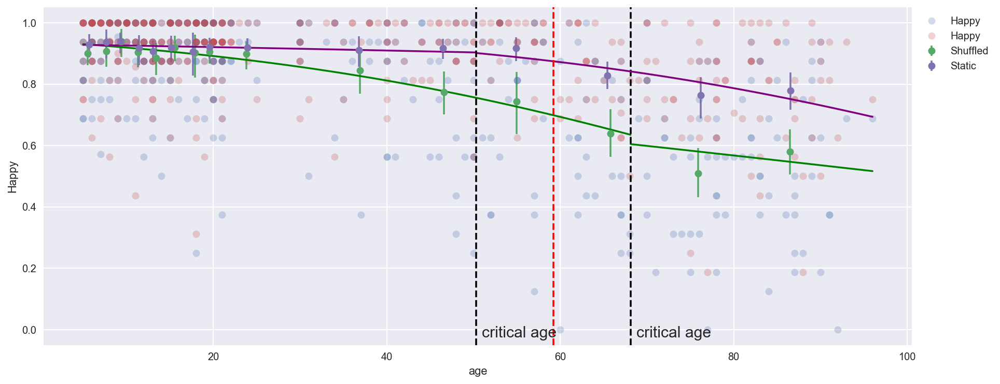

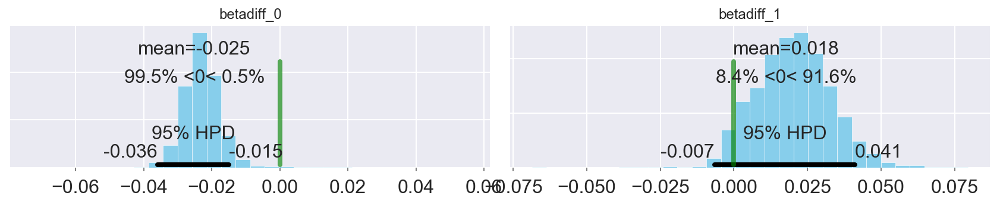

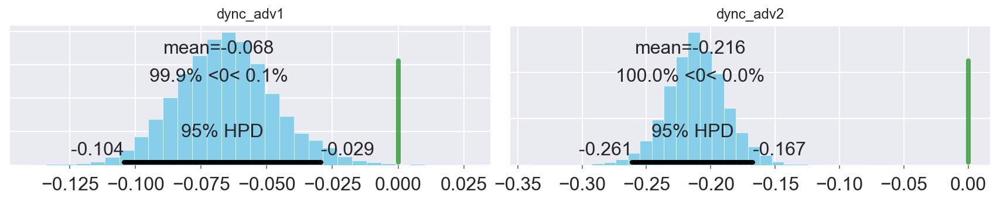

                  mean         sd  mc_error    hpd_2.5   hpd_97.5
tau          59.218628  10.534961  0.371704  36.755141  79.067609
tau1         68.107090  12.329990  0.546319  33.783891  81.228062
tau2         50.280579   6.615360  0.284189  38.276508  60.609426
beta1__0     -0.032270   0.004165  0.000141  -0.037709  -0.027089
beta1__1     -0.012838   0.011564  0.000349  -0.034383   0.007676
beta2__0     -0.007173   0.004323  0.000110  -0.015610   0.001802
beta2__1     -0.030544   0.004850  0.000190  -0.038433  -0.022817
betadiff__0  -0.025096   0.005726  0.000156  -0.035977  -0.014894
betadiff__1   0.017707   0.012711  0.000392  -0.006553   0.041114
dync_adv1    -0.068285   0.018963  0.000566  -0.104384  -0.029448
dync_adv2    -0.215935   0.023588  0.000548  -0.261218  -0.167265


In [83]:
plot_selectposterior(burnin=0,trace=trace_happy,task1 = 'Shuffled',task2 = 'Static')

### Sad 3

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,324.1:  67%|██████▋   | 134482/200000 [02:00<00:56, 1150.23it/s]
Convergence archived at 134500
Interrupted at 134,499 [67%]: Average Loss = 6,513.9
100%|██████████| 3000/3000 [01:05<00:00, 45.61it/s]


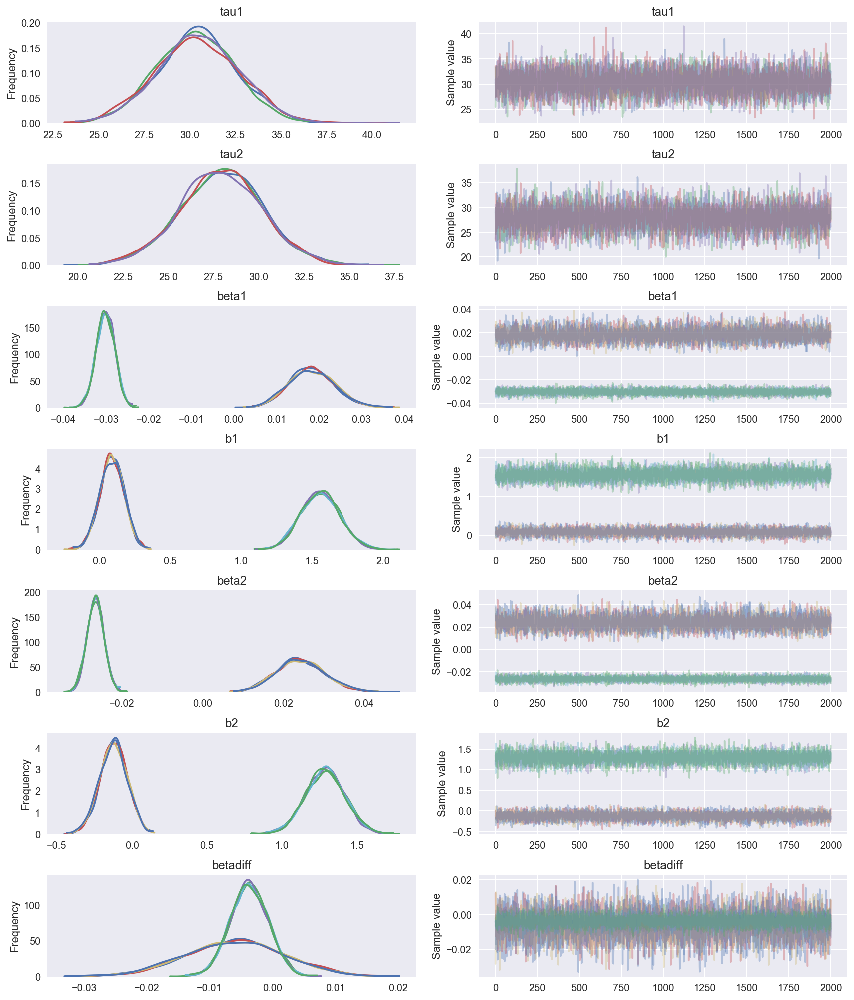

In [75]:
emolabel = 'Sad'
trace_sad = model3_diff(emolabel,task1 = 'Shuffled',task2 = 'Static')
pm.traceplot(trace_sad,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82987
Diverge of the trace
(array([], dtype=int64),)


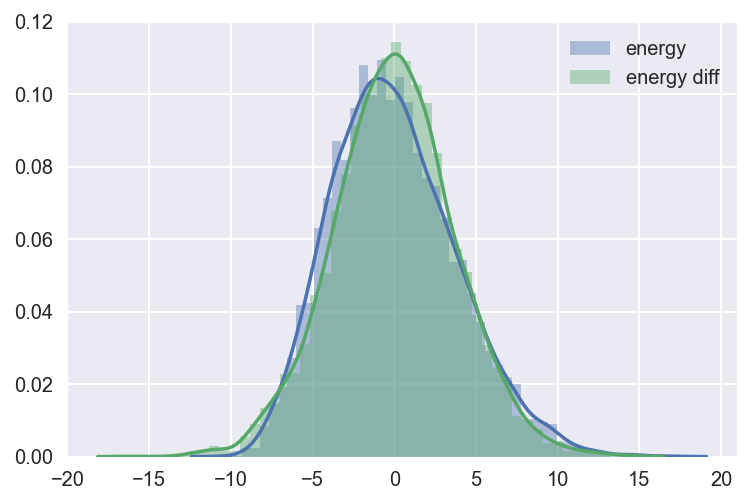

In [76]:
plot_samplerstat(burnin=0,trace=trace_sad)

Displaying Shuffled condition
Displaying Static condition


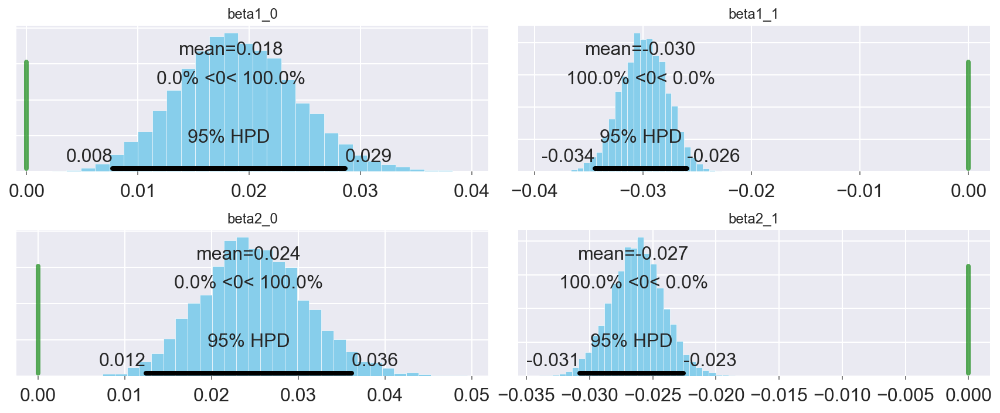

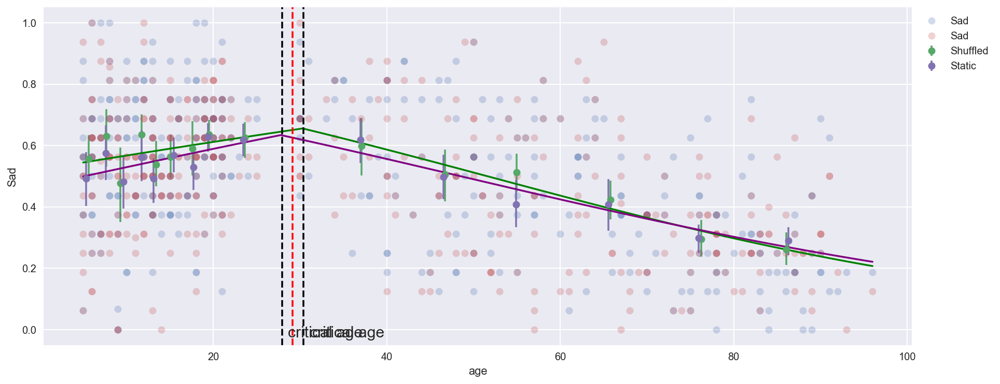

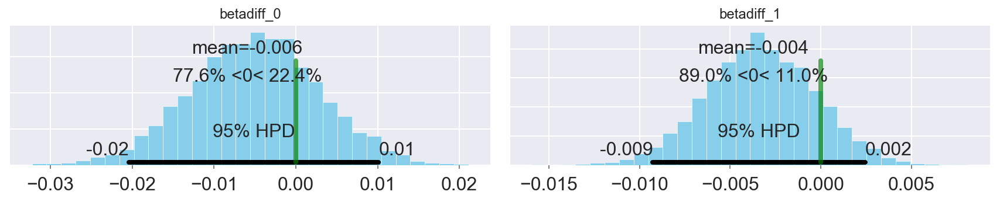

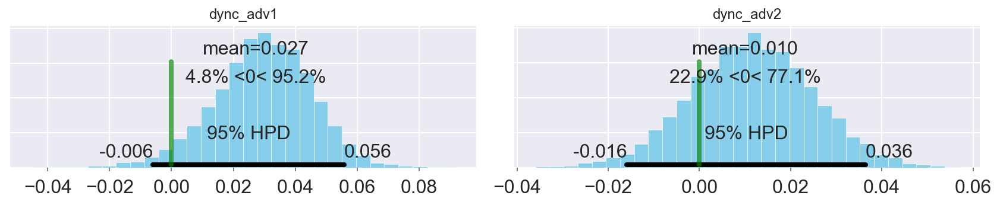

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          29.131937  7.353376  0.084344  14.708470  43.375523
tau1         30.416674  2.221592  0.025368  25.991319  34.658155
tau2         27.918123  2.282476  0.031521  23.350247  32.374758
beta1__0      0.018347  0.005363  0.000075   0.007744   0.028611
beta1__1     -0.030217  0.002161  0.000023  -0.034433  -0.025960
beta2__0      0.024269  0.006031  0.000089   0.012468   0.036146
beta2__1     -0.026514  0.002087  0.000021  -0.030776  -0.022552
betadiff__0  -0.005922  0.007857  0.000117  -0.020405   0.010118
betadiff__1  -0.003703  0.003006  0.000027  -0.009271   0.002448
dync_adv1     0.027221  0.015748  0.000187  -0.005958   0.055794
dync_adv2     0.010023  0.013403  0.000142  -0.015926   0.036423


In [77]:
plot_selectposterior(burnin=0,trace=trace_sad,task1 = 'Shuffled',task2 = 'Static')

### Surprise 3

Auto-assigning NUTS sampler...
Initializing NUTS using advi+adapt_diag...
Average Loss = 2,371.4:  72%|███████▏  | 143063/200000 [02:17<00:56, 1001.52it/s]
Convergence archived at 143100
Interrupted at 143,099 [71%]: Average Loss = 6,270.6
100%|██████████| 3000/3000 [01:04<00:00, 46.37it/s]


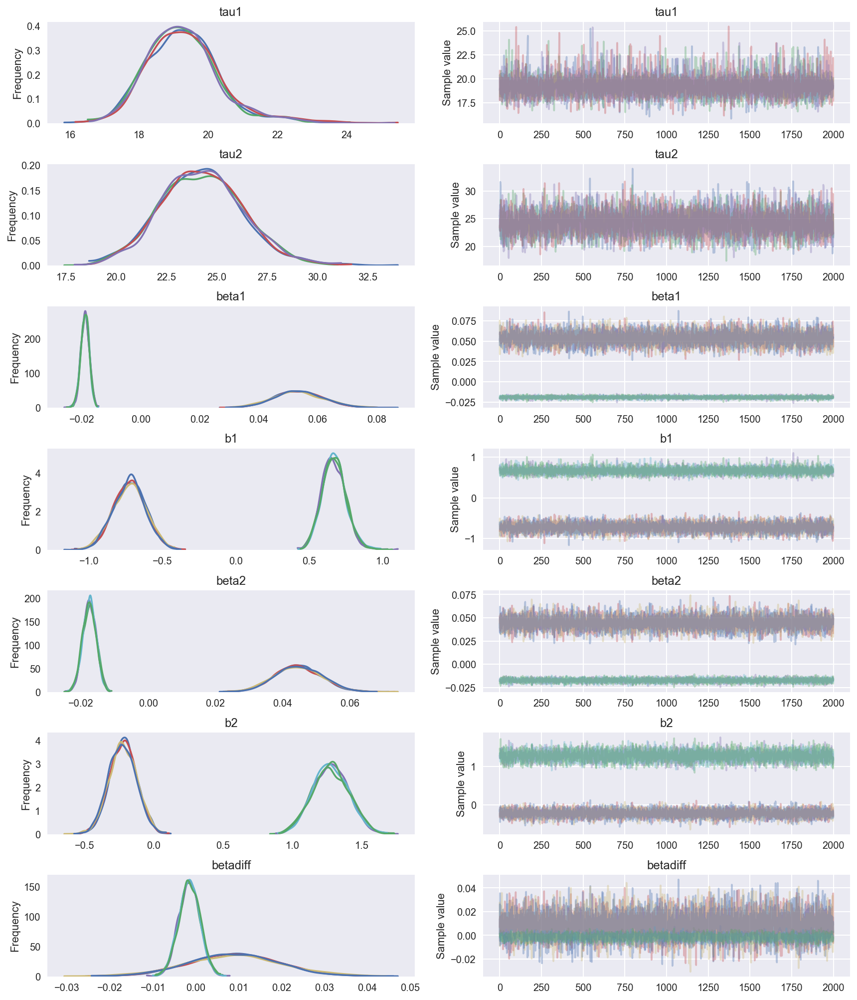

In [78]:
emolabel = 'Surprise'
trace_surprise = model3_diff(emolabel,task1 = 'Shuffled',task2 = 'Static')
pm.traceplot(trace_surprise,varnames=['tau1','tau2','beta1','b1','beta2','b2','betadiff'])
plt.show()

The accept rate is: 0.82297
Diverge of the trace
(array([], dtype=int64),)


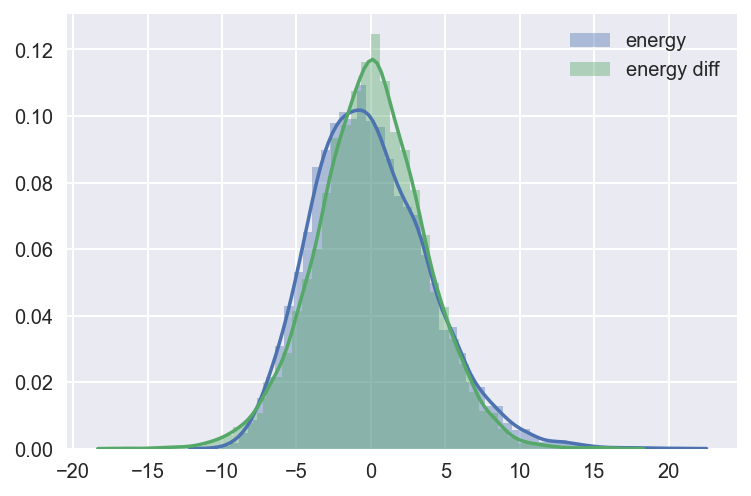

In [79]:
plot_samplerstat(burnin=0,trace=trace_surprise)

Displaying Shuffled condition
Displaying Static condition


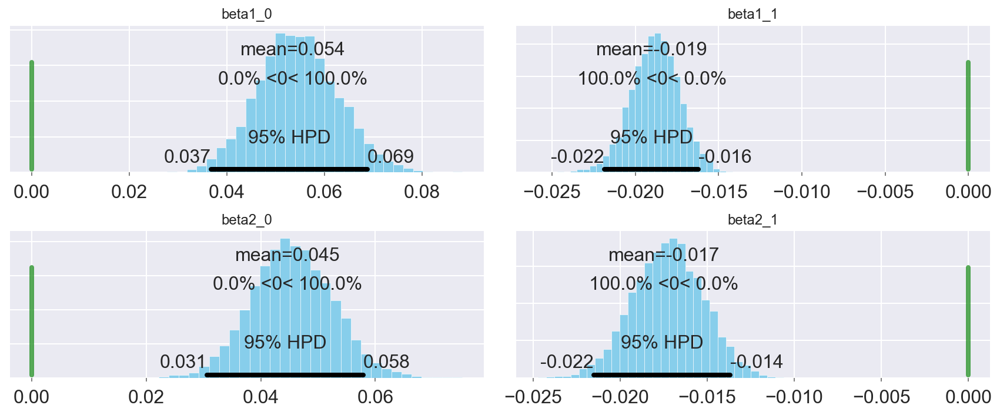

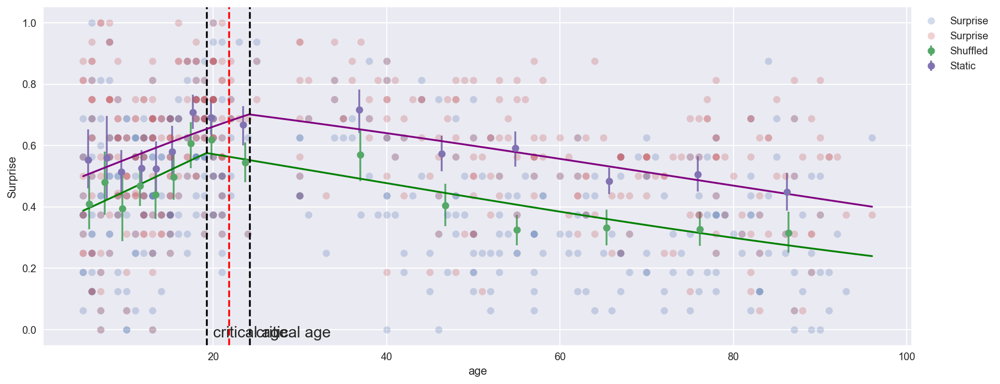

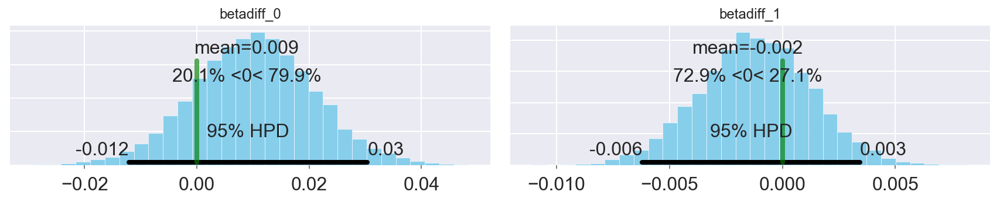

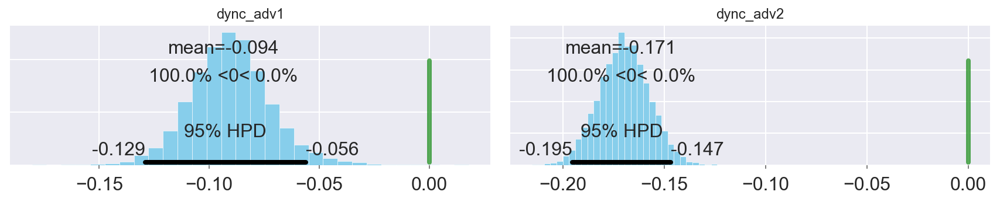

                  mean        sd  mc_error    hpd_2.5   hpd_97.5
tau          21.852049  6.954315  0.087347   7.547785  34.691144
tau1         19.285384  1.094584  0.014461  17.247376  21.611587
tau2         24.240998  2.043830  0.025613  20.114257  28.179952
beta1__0      0.053533  0.008175  0.000100   0.036782   0.068777
beta1__1     -0.019007  0.001449  0.000017  -0.021869  -0.016204
beta2__0      0.044643  0.007039  0.000067   0.030580   0.057912
beta2__1     -0.017483  0.002009  0.000025  -0.021522  -0.013685
betadiff__0   0.008890  0.010721  0.000134  -0.012114   0.030401
betadiff__1  -0.001524  0.002457  0.000031  -0.006207   0.003425
dync_adv1    -0.093531  0.018294  0.000242  -0.129192  -0.056073
dync_adv2    -0.171446  0.012403  0.000130  -0.195356  -0.146815


In [80]:
plot_selectposterior(burnin=0,trace=trace_surprise,task1 = 'Shuffled',task2 = 'Static')